In [1]:
import utils as ut
import numpy as np
import pandas as pd
from sklearn.metrics import r2_score,mean_squared_error
from matplotlib import pyplot as plt
import seaborn as sns
%matplotlib inline

In [2]:
path_SA_old='../../old_tem_repo/dvm-dos-tem/mads_calibration/SA/EML/'
path_SA='../../dvm-dos-tem/mads_calibration/SA/EML/'
path='../../dvm-dos-tem/mads_calibration/results/'

# cmax -> GPP

In [9]:
params='sample_matrix_STEP1-MD21-EML.csv'
model='results_STEP1-MD21-EML.txt'
df_param = pd.read_csv(path_SA_old+params)
df_model = pd.read_csv(path_SA_old+model,header=None)

output_name = ['GPP0','GPP1','GPP2','GPP3','GPP4','GPP5','GPP6','NA','NA']
df_model.columns = output_name
units = 'gC/m2/year'
title_1='One to One Match Plot fot Cmax targeting GPP'
title_2='Spaghetti Match Plot fot Cmax targeting GPP'
title_3='Log Scale Spaghetti Match Plot fot Cmax targeting GPP'

In [11]:
!cat ../../dvm-dos-tem/mads_calibration/SA/EML/param_props_STEP1-MD21-EML.csv

name,bounds,initial,cmtnum,pftnum
cmax,"[16.5, 49.5]",33.0,21,0
cmax,"[86.0, 258.0]",172.0,21,1
cmax,"[215.0, 645.0]",430.0,21,2
cmax,"[1.6, 4.800000000000001]",3.2,21,3
cmax,"[12.0, 36.0]",24.0,21,4
cmax,"[37.5, 112.5]",75.0,21,5
cmax,"[21.5, 64.5]",43.0,21,6


In [12]:
df_model

,GPP0,GPP1,GPP2,GPP3,GPP4,GPP5,GPP6,NA,NA
0,19.485982,166.144041,415.466397,2.070613,9.024215,31.032662,15.530906,0.0,0.0
1,30.491512,123.171175,404.550149,0.972030,22.332867,64.076343,20.184257,0.0,0.0
2,14.988081,75.596318,262.813685,1.952724,13.992082,38.067797,33.692524,0.0,0.0
3,14.218382,89.572981,288.041946,1.851124,20.065953,34.150348,30.828070,0.0,0.0
4,24.287746,59.978160,372.048253,1.277703,7.490948,71.434945,46.122020,0.0,0.0
...,...,...,...,...,...,...,...,...,...
996,12.164155,102.380829,348.369146,1.781377,19.224022,65.101568,39.108151,0.0,0.0
997,11.687496,76.878225,346.520811,2.743405,20.595833,65.795292,23.444398,0.0,0.0
998,20.457508,110.199460,211.831455,1.017671,22.492069,35.886153,21.601436,0.0,0.0
999,12.627853,163.535437,359.275952,2.209163,21.606924,40.487633,33.639069,0.0,0.0


Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot fot Cmax targeting GPP')

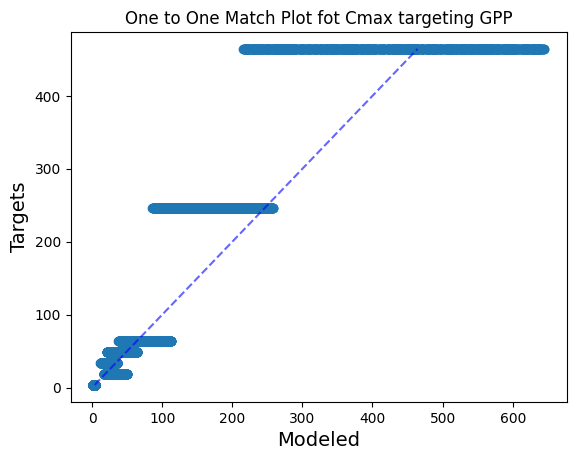

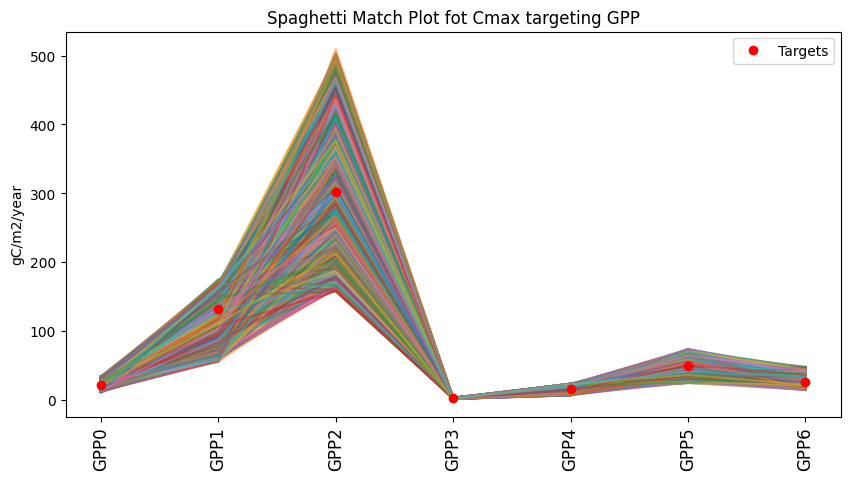

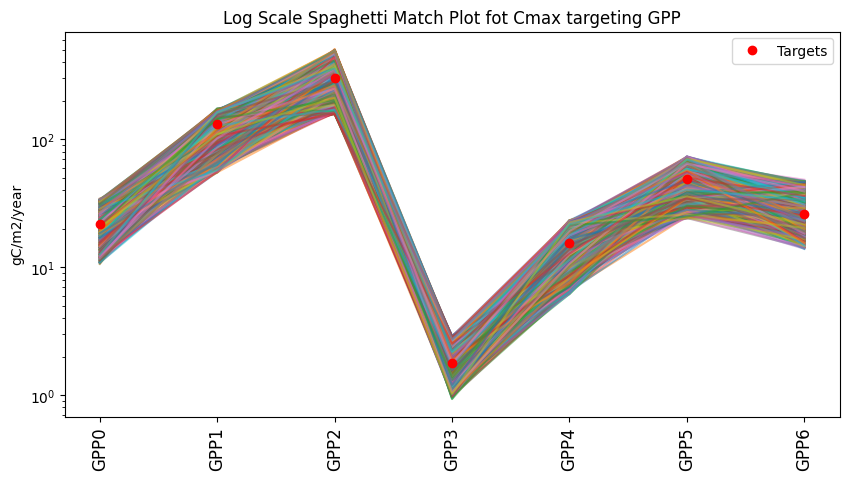

In [13]:
ut.one_to_one_match_plot(df_param.iloc[:,:7])
plt.title(title_1)
ut.spaghetti_match_plot(df_param.iloc[:,:7], df_model.iloc[:,:7])
plt.ylabel(units)
plt.title(title_2)
ut.spaghetti_match_plot(df_param.iloc[:,:7], df_model.iloc[:,:7], logy=True)
plt.ylabel(units)
plt.title(title_3)

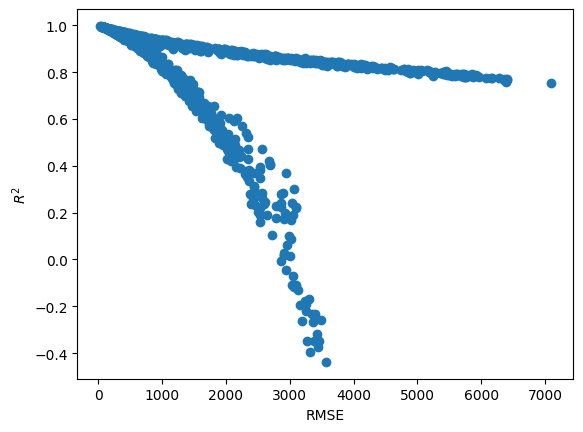

In [14]:
rmse=ut.plot_r2_rmse(df_model.iloc[:,:7])

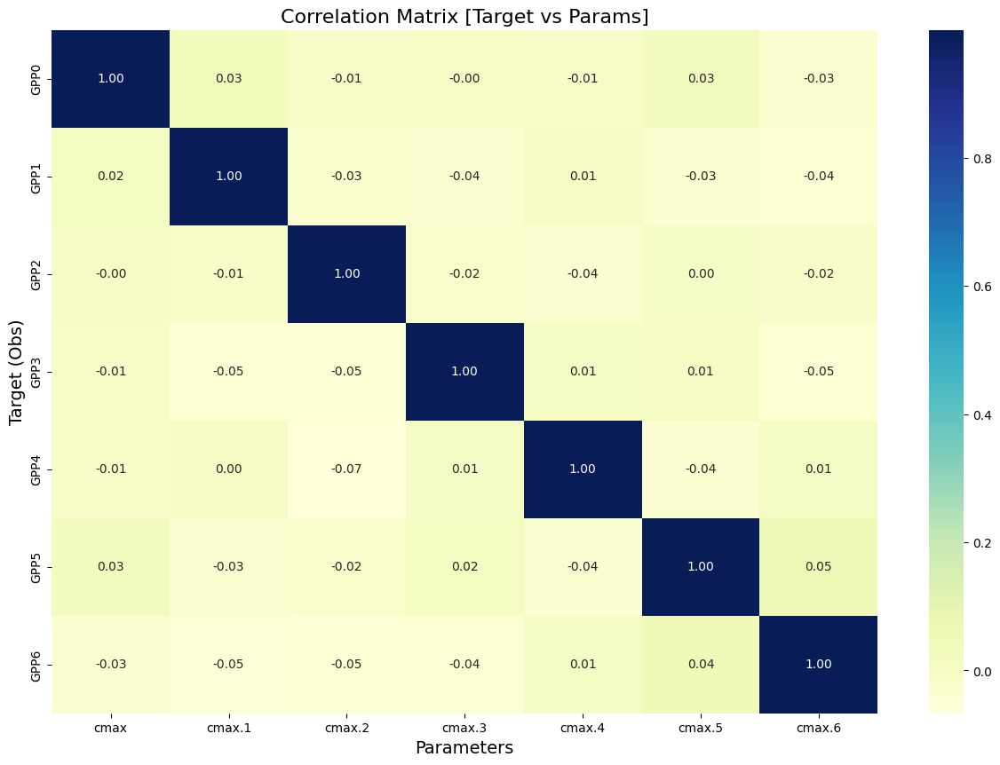

In [15]:
corr_mp=ut.get_output_param_corr(df_param.iloc[:,:7],df_model.iloc[:,:7])

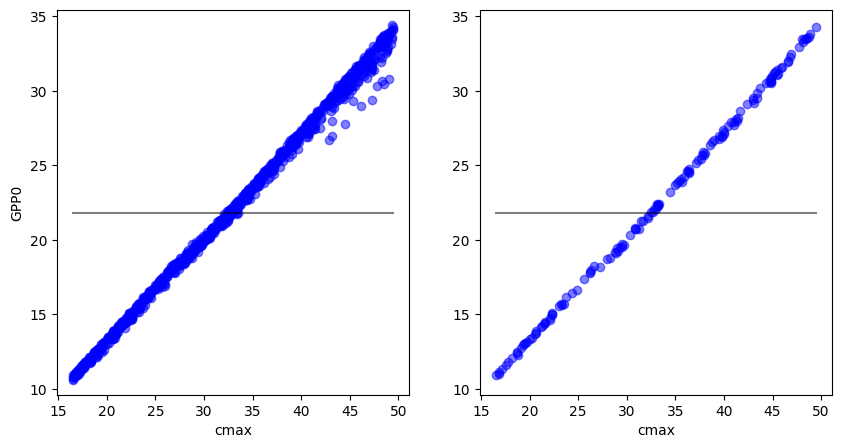

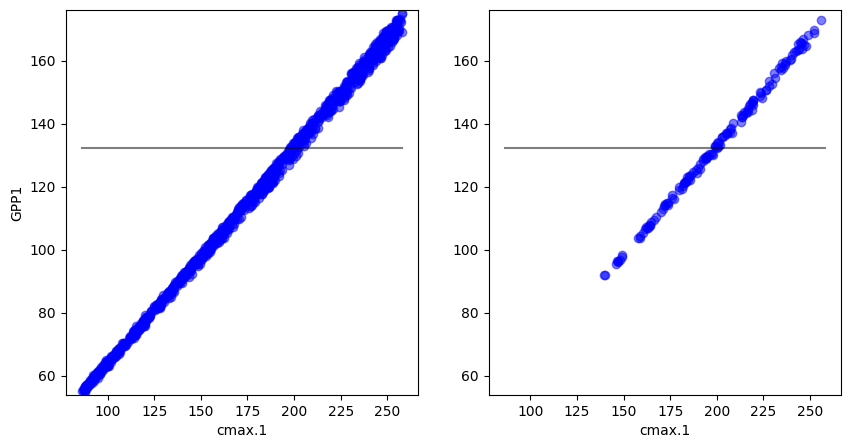

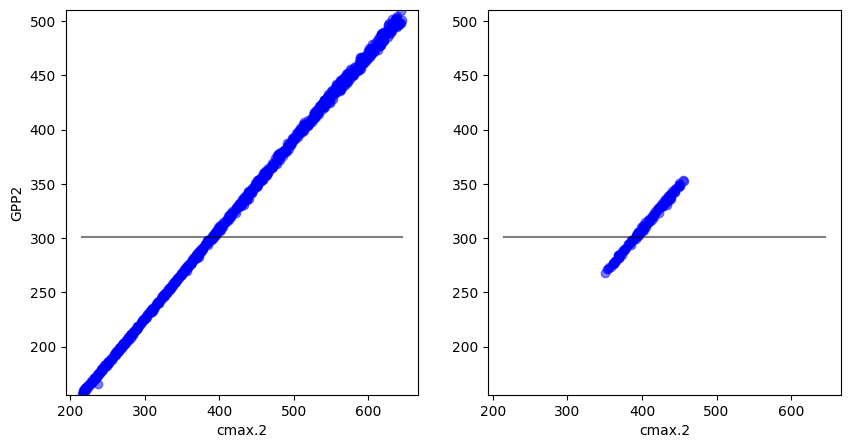

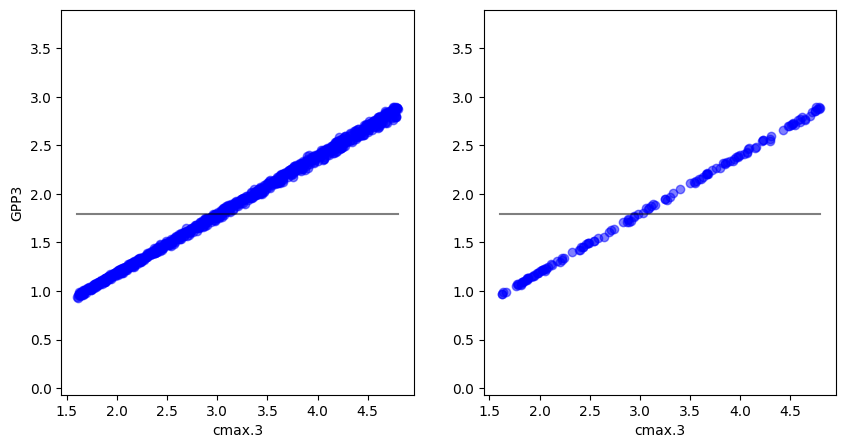

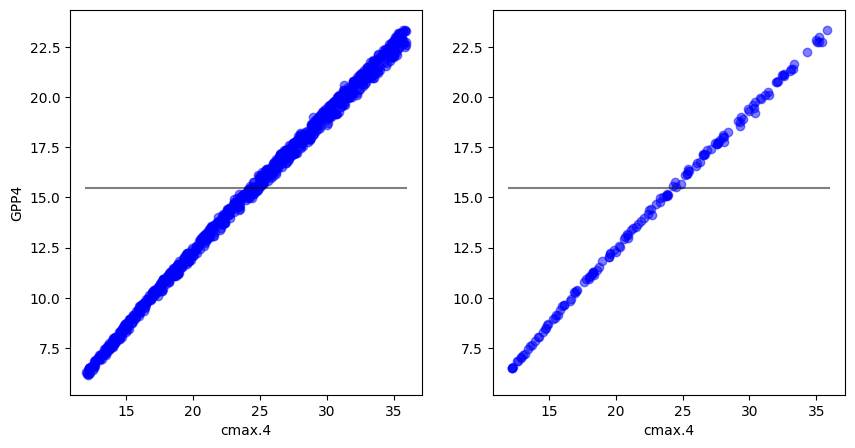

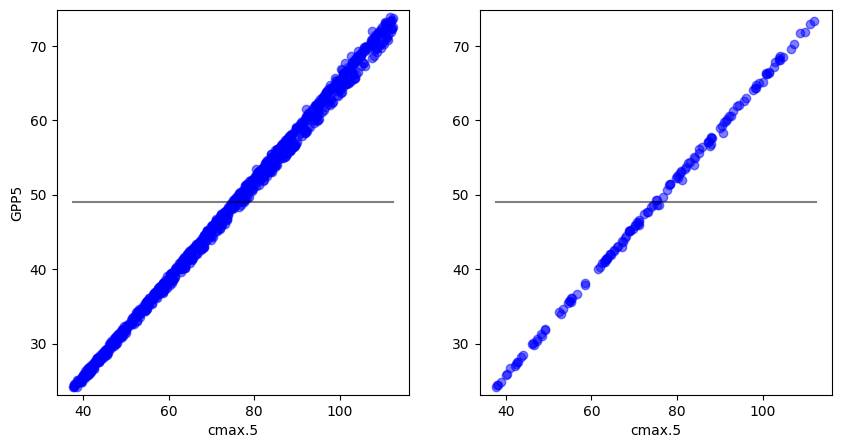

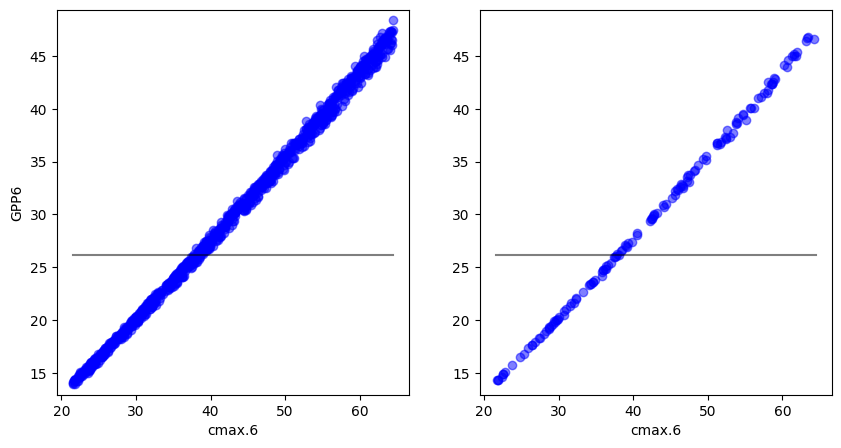

In [16]:
ut.plot_relationships(corr_mp,df_param.iloc[:,:7],df_model.iloc[:,:7],corr_thresh=0.50)

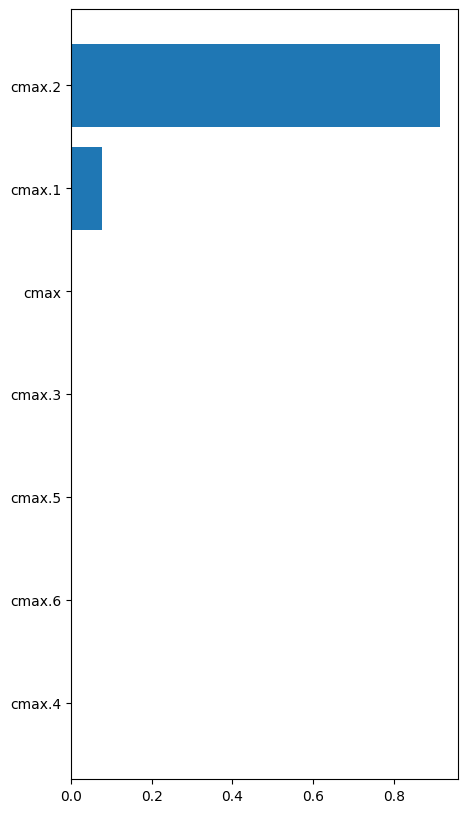

In [17]:
e_r2=ut.find_important_features_err(df_param.iloc[:,:7],df_model.iloc[:,:7],error='r2')

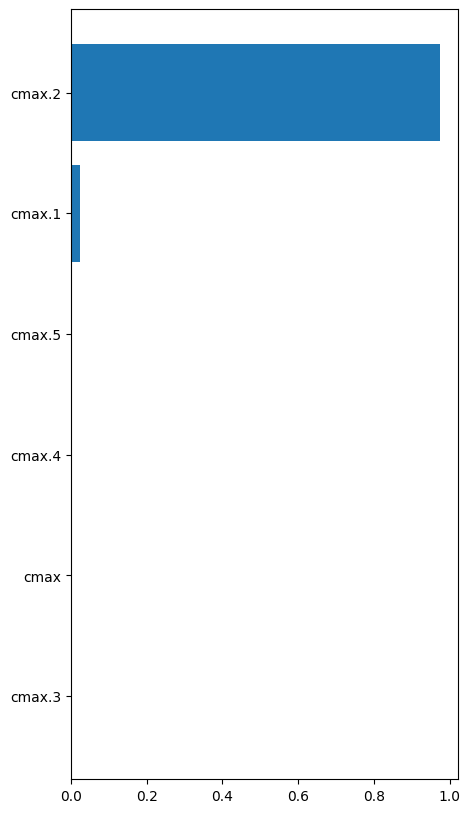

In [18]:
e_rmse=ut.find_important_features_err(df_param.iloc[:,:6],df_model.iloc[:,:6],error='rmse')

results with best error

In [19]:
xparams_R2, ymodel_R2 = ut.get_params_r2_rmse(df_param.iloc[:,:7],df_model.iloc[:,:7],r2lim=0.97)
xparams_R2

,cmax,cmax.1,cmax.2,cmax.3,cmax.4,cmax.5,cmax.6,$R^2$,RMSE,MAPE
13,40.037078,216.855028,456.349195,4.067095,23.851094,76.704962,39.884264,0.970844,393.393311,0.109409
23,37.366092,194.967110,445.383114,1.888927,32.047260,61.558505,29.520296,0.976466,305.762490,0.239307
25,22.254092,204.841291,381.296199,4.597536,15.300503,63.079976,26.379361,0.995649,43.217781,0.326398
33,33.087024,185.227468,426.782608,2.224778,29.338851,58.557927,22.545587,0.984756,184.451546,0.251349
38,39.501519,206.827262,369.581195,2.539494,31.424668,98.258505,58.784110,0.983233,138.981572,0.190764
...,...,...,...,...,...,...,...,...,...,...
952,45.985829,216.167746,357.760302,3.982215,15.647524,47.273849,36.361963,0.976155,204.333269,0.300696
959,43.683567,233.408993,393.496086,1.885888,22.506755,54.805094,34.021448,0.987834,128.907435,0.227674
974,44.863598,208.083029,422.356849,3.265036,35.405869,109.932783,30.756569,0.984852,167.669183,0.195983
984,21.430180,173.717434,413.050497,4.482433,34.320129,66.267554,42.644732,0.989375,115.961830,0.233699


Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot fot Cmax targeting GPP')

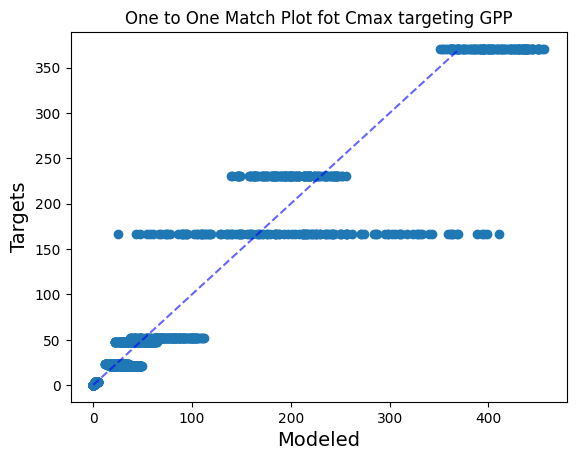

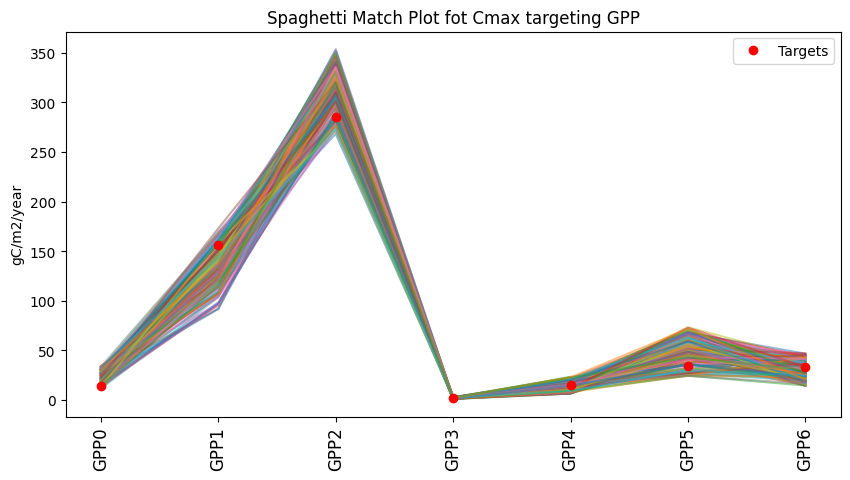

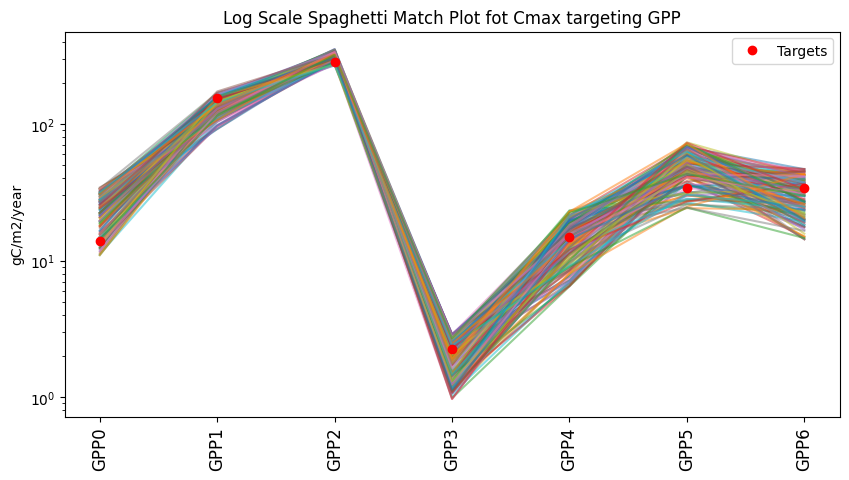

In [20]:
ut.one_to_one_match_plot(xparams_R2)
plt.title(title_1)
ut.spaghetti_match_plot(xparams_R2, ymodel_R2)
plt.ylabel(units)
plt.title(title_2)
ut.spaghetti_match_plot(xparams_R2, ymodel_R2, logy=True)
plt.ylabel(units)
plt.title(title_3)

In [21]:
best=xparams_R2[xparams_R2.MAPE<1]
best_model=ymodel_R2[xparams_R2.MAPE<1]

In [22]:
best

,cmax,cmax.1,cmax.2,cmax.3,cmax.4,cmax.5,cmax.6,$R^2$,RMSE,MAPE
13,40.037078,216.855028,456.349195,4.067095,23.851094,76.704962,39.884264,0.970844,393.393311,0.109409
23,37.366092,194.967110,445.383114,1.888927,32.047260,61.558505,29.520296,0.976466,305.762490,0.239307
25,22.254092,204.841291,381.296199,4.597536,15.300503,63.079976,26.379361,0.995649,43.217781,0.326398
33,33.087024,185.227468,426.782608,2.224778,29.338851,58.557927,22.545587,0.984756,184.451546,0.251349
38,39.501519,206.827262,369.581195,2.539494,31.424668,98.258505,58.784110,0.983233,138.981572,0.190764
...,...,...,...,...,...,...,...,...,...,...
952,45.985829,216.167746,357.760302,3.982215,15.647524,47.273849,36.361963,0.976155,204.333269,0.300696
959,43.683567,233.408993,393.496086,1.885888,22.506755,54.805094,34.021448,0.987834,128.907435,0.227674
974,44.863598,208.083029,422.356849,3.265036,35.405869,109.932783,30.756569,0.984852,167.669183,0.195983
984,21.430180,173.717434,413.050497,4.482433,34.320129,66.267554,42.644732,0.989375,115.961830,0.233699


In [23]:
#print bounds of param from best scores
x_max = best.max()
x_min = best.min()

# Create a list of pairs [x_min, x_max] where x_min and x_max correspond to the same index in xparams
result = [[x_min[i], x_max[i]] for i in range(len(x_max))]

for pair in result:
    print("Uniform({:.5f}, {:.5f})".format(pair[0], pair[1]))

Uniform(16.50101, 49.42573)
Uniform(139.69663, 255.99974)
Uniform(350.71976, 456.34919)
Uniform(1.62234, 4.79255)
Uniform(12.21692, 35.82760)
Uniform(37.60152, 111.91185)
Uniform(21.74762, 64.24799)
Uniform(0.97012, 0.99760)
Uniform(24.89121, 410.58754)
Uniform(0.10764, 0.46054)


Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot fot Cmax targeting GPP')

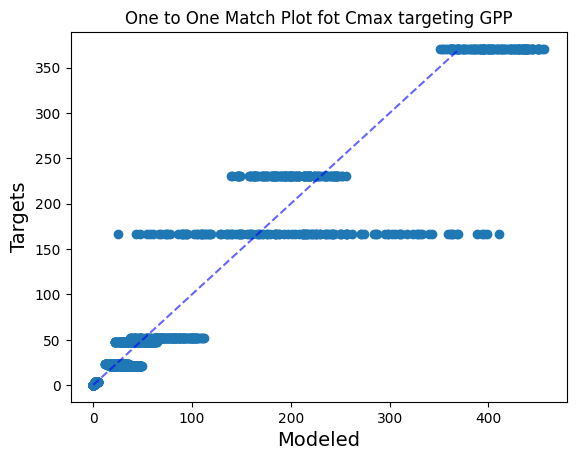

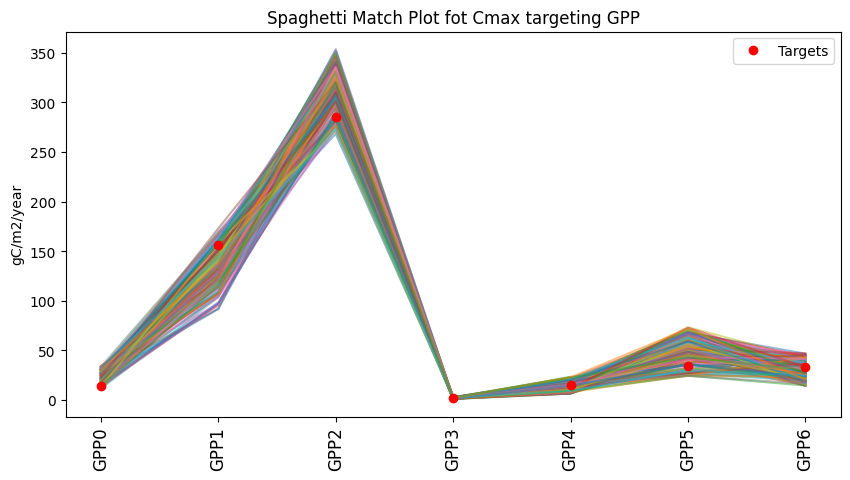

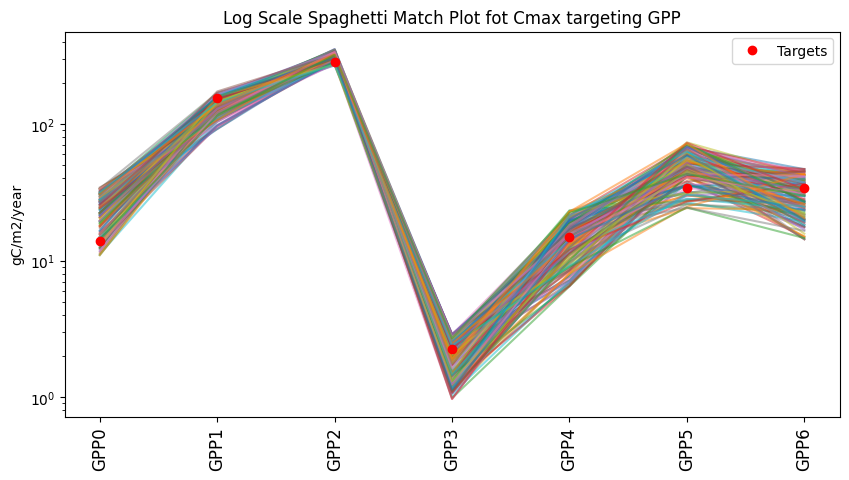

In [24]:
ut.one_to_one_match_plot(best)
plt.title(title_1)
ut.spaghetti_match_plot(best, best_model)
plt.ylabel(units)
plt.title(title_2)
ut.spaghetti_match_plot(best, best_model, logy=True)
plt.ylabel(units)
plt.title(title_3)

# nmax + krb -> NPP + VEGC

krb's overshadow nmax in terms of importance. running nmax alone to see if it gets a better match.
some Vegc targets completely off

In [25]:
params='sample_matrix_STEP2-MD21-EML.csv'
model='results_STEP2-MD21-EML.txt'
df_param = pd.read_csv(path_SA+params)
df_model = pd.read_csv(path_SA+model,header=None)

output_name = ['NPP0','NPP1','NPP2','NPP3','NPP4','NPP5','NPP6',\
               'VEGC00','VEGC01','VEGC02','VEGC03','VEGC04','VEGC05','VEGC06',\
                'VEGC10','VEGC11',\
                'VEGC20','VEGC21','VEGC22','VEGC23']
df_model.columns = output_name
units_NPP = 'gC/m2/year'
units_VEGC = 'gC/m2'
title_1='One to One Match Plot for Nmax targeting NPP'
title_2='Spaghetti Match Plot for Nmax targeting NPP'
title_3='Log Scale Spaghetti Match Plot for Nmax targeting NPP'

title_4='One to One Match Plot for krb targeting VEGC'
title_5='Spaghetti Match Plot for krb targeting VEGC'
title_6='Log Scale Spaghetti Match Plot for krb targeting VEGC'

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for Nmax targeting NPP')

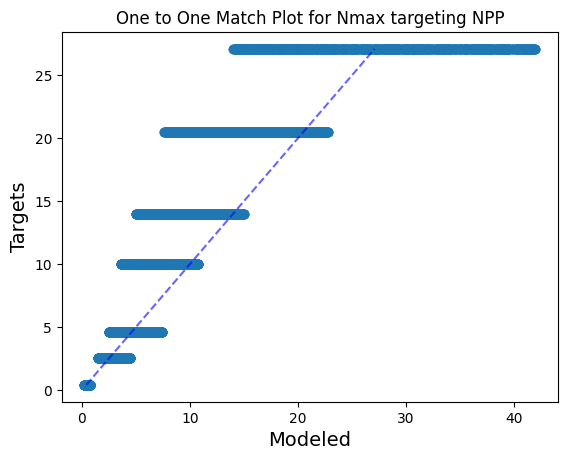

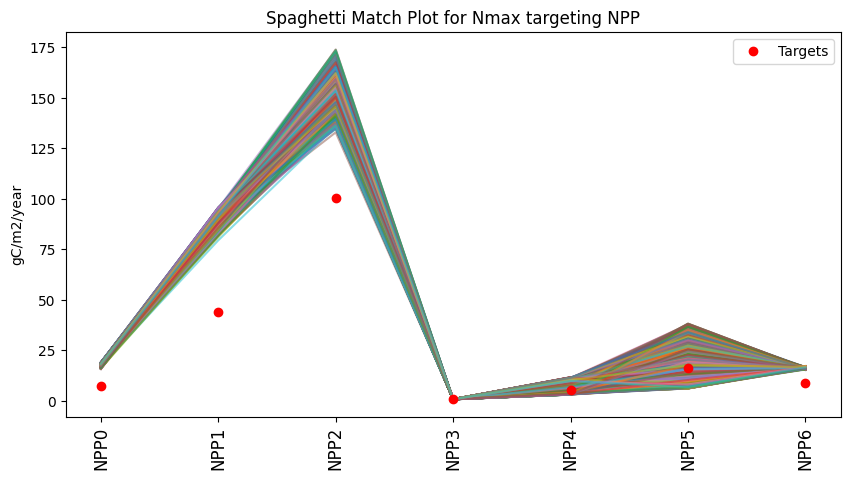

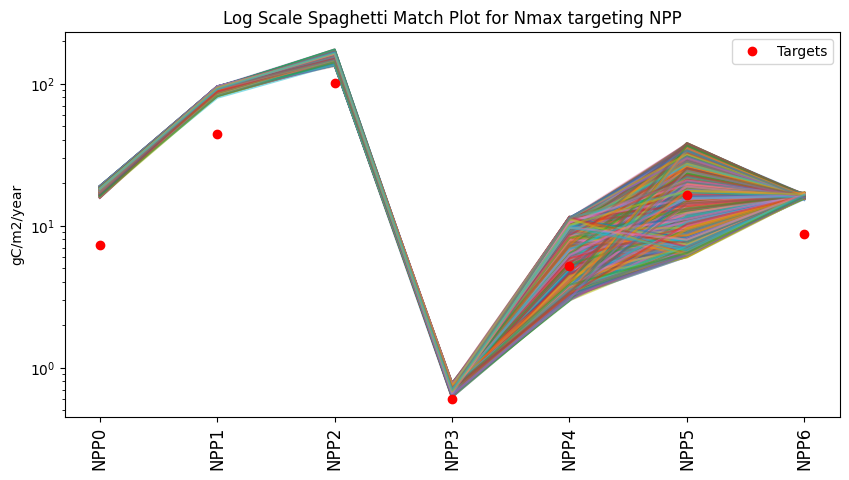

In [26]:
ut.one_to_one_match_plot(df_param.iloc[:,0:7])
plt.title(title_1)
ut.spaghetti_match_plot(df_param.iloc[:,0:7], df_model.iloc[:,0:7])
plt.ylabel(units_NPP)
plt.title(title_2)
ut.spaghetti_match_plot(df_param.iloc[:,0:7], df_model.iloc[:,0:7], logy=True)
plt.ylabel(units_NPP)
plt.title(title_3)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for krb targeting VEGC')

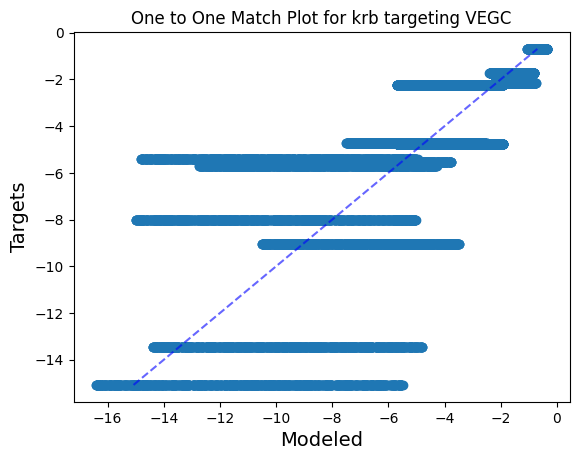

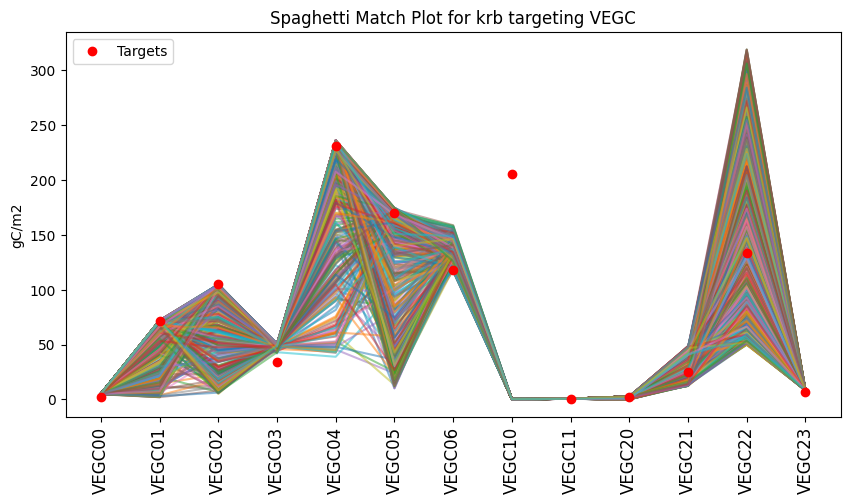

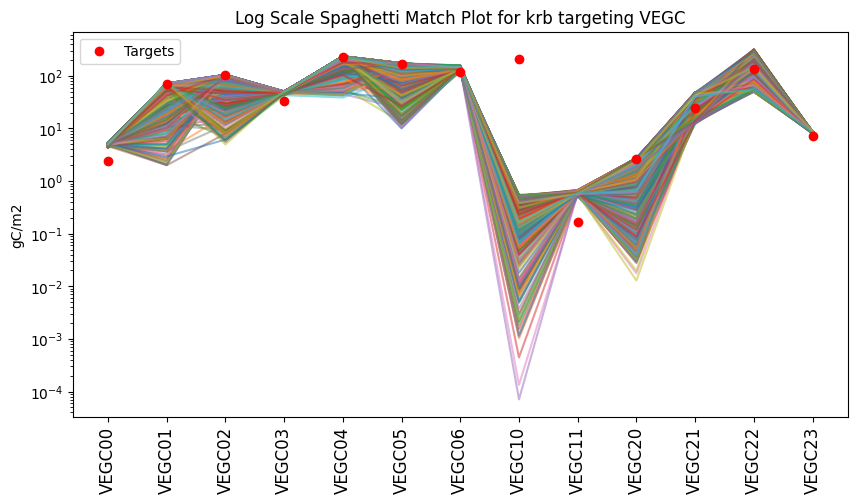

In [27]:
ut.one_to_one_match_plot(df_param.iloc[:,7:])
plt.title(title_4)
ut.spaghetti_match_plot(df_param.iloc[:,7:], df_model.iloc[:,7:])
plt.ylabel(units_VEGC)
plt.title(title_5)
ut.spaghetti_match_plot(df_param.iloc[:,7:], df_model.iloc[:,7:], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_6)

best errors

In [ ]:
xparams, ymodel =  ut.get_params_r2_rmse(df_param,df_model,r2lim=0.5)

In [26]:
best=xparams[xparams.MAPE<1]
best_model=ymodel[xparams.MAPE<1]
best

,nmax,nmax.1,nmax.2,nmax.3,nmax.4,nmax.5,nmax.6,krb(0),krb(0).1,krb(0).2,...,krb(0).6,krb(1),krb(1).1,krb(2),krb(2).1,krb(2).2,krb(2).3,$R^2$,RMSE,MAPE


In [27]:
#print bounds of param from best scores
x_max = xparams.max()
x_min = xparams.min()

# Create a list of pairs [x_min, x_max] where x_min and x_max correspond to the same index in xparams
result = [[x_min[i], x_max[i]] for i in range(len(x_max))]

for pair in result:
    print("Uniform({:.5f}, {:.5f})".format(pair[0], pair[1]))

Uniform(3.68761, 10.76775)
Uniform(14.38297, 40.98665)
Uniform(7.60018, 22.40097)
Uniform(0.25169, 0.74247)
Uniform(1.53027, 3.98828)
Uniform(5.54634, 14.45296)
Uniform(2.52797, 7.40270)
Uniform(-10.25938, -3.79948)
Uniform(-10.73935, -3.75859)
Uniform(-2.23710, -0.90453)
Uniform(-2.32034, -0.81942)
Uniform(-5.16621, -1.90560)
Uniform(-4.85318, -3.90185)
Uniform(-1.04503, -0.38591)
Uniform(-14.38414, -6.78721)
Uniform(-16.30498, -9.45192)
Uniform(-14.50234, -7.79281)
Uniform(-14.85992, -8.94572)
Uniform(-7.18882, -2.88647)
Uniform(-12.55605, -4.25520)
Uniform(0.50005, 0.52782)
Uniform(2414.27613, 2924.39891)
Uniform(19.64134, 178.70122)


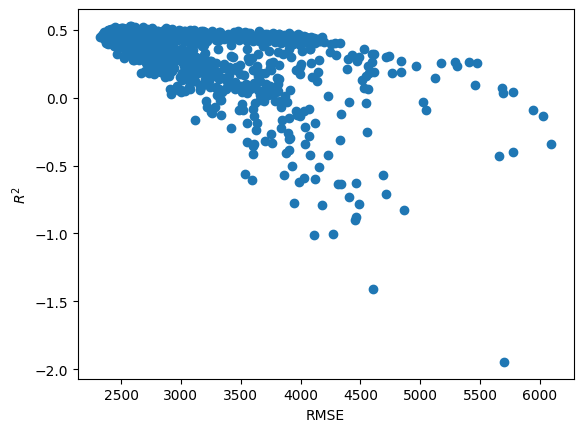

In [24]:
rmse=ut.plot_r2_rmse(df_model)

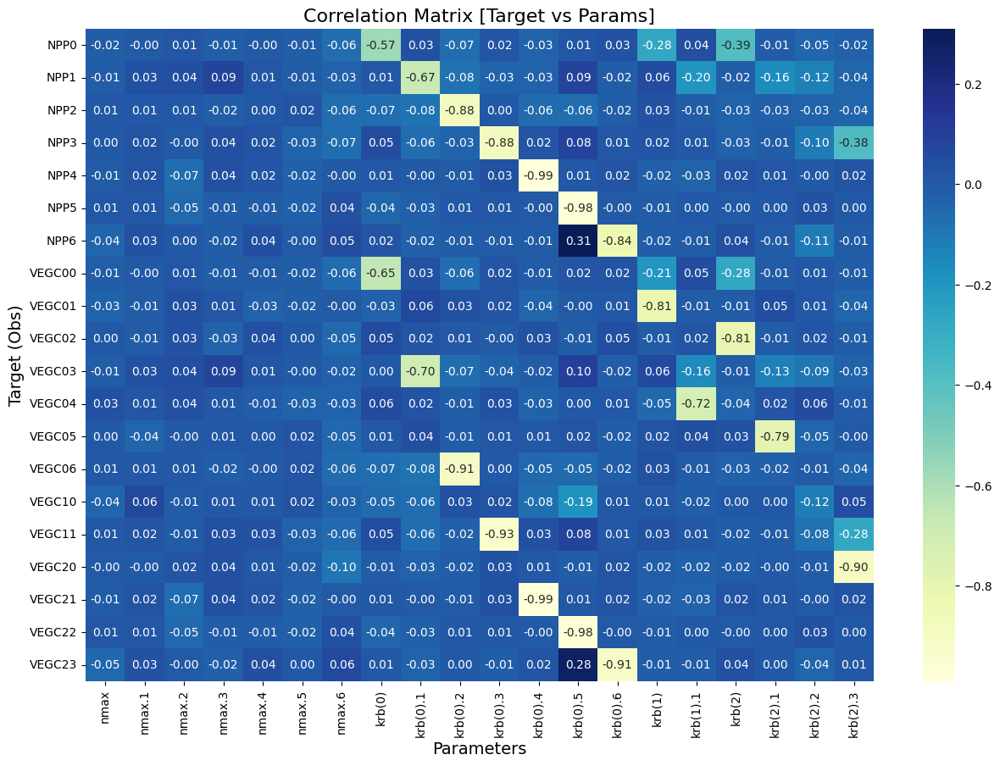

In [25]:
corr_mp=ut.get_output_param_corr(df_param,df_model)

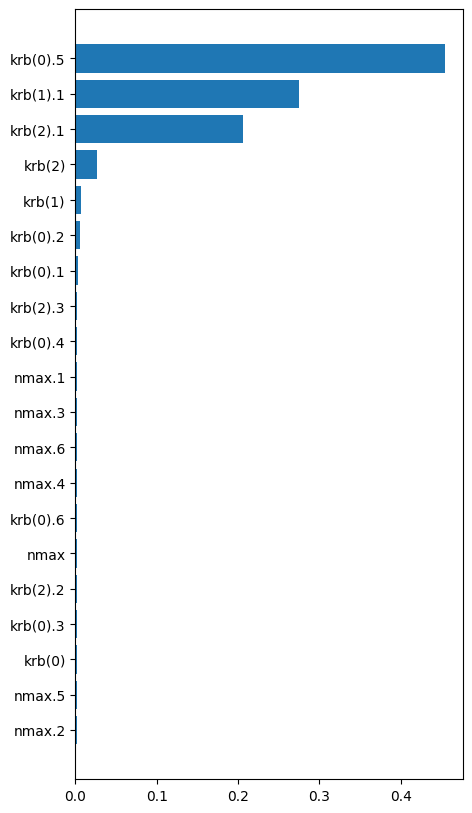

In [26]:
e_rmse=ut.find_important_features_err(df_param,df_model,error='rmse')

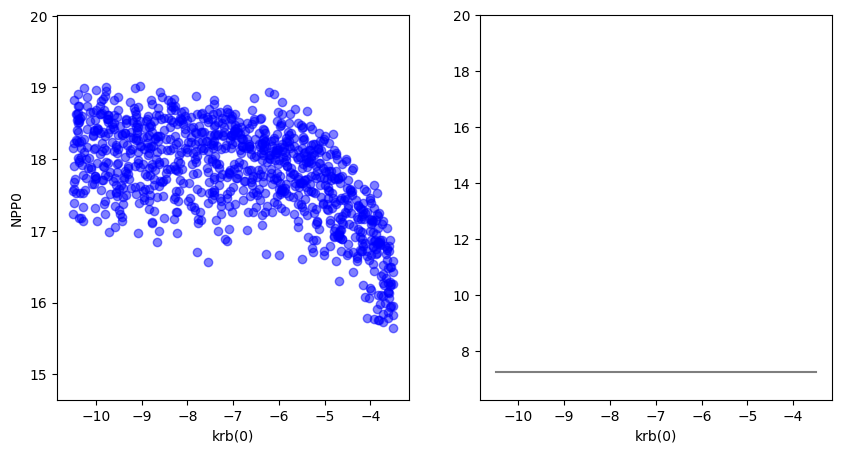

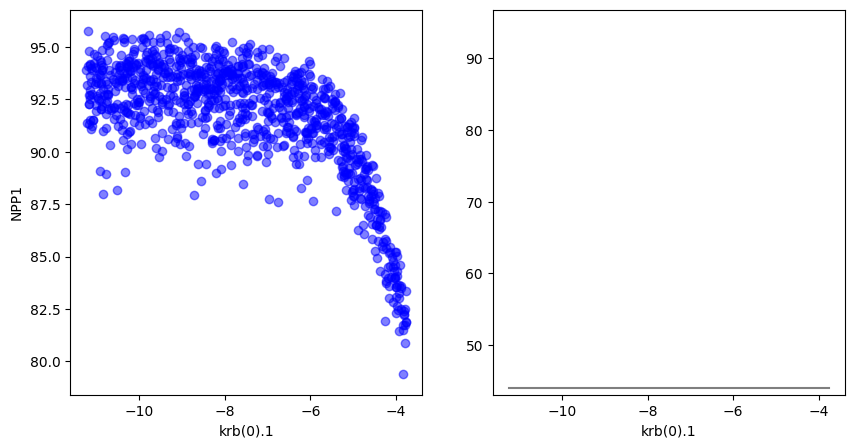

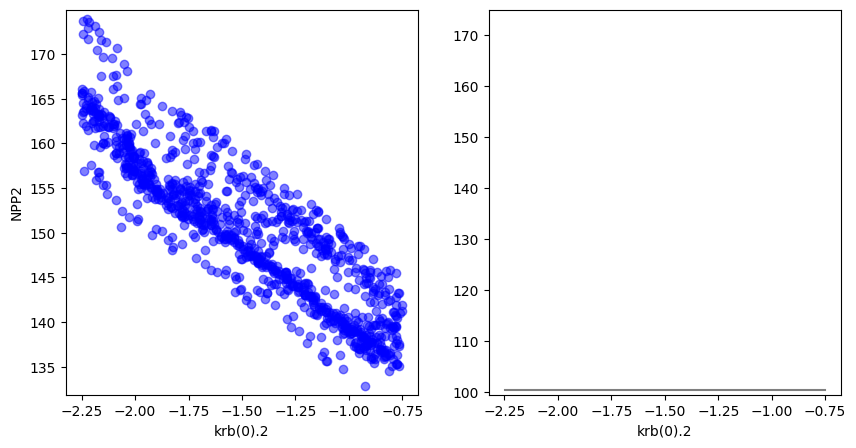

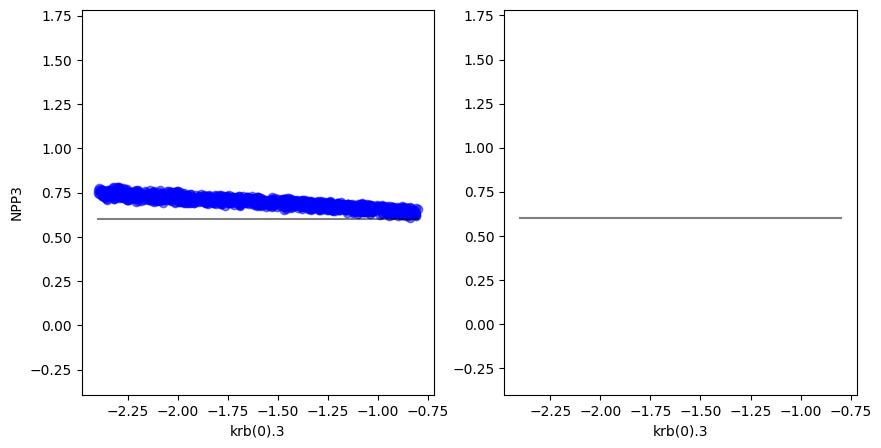

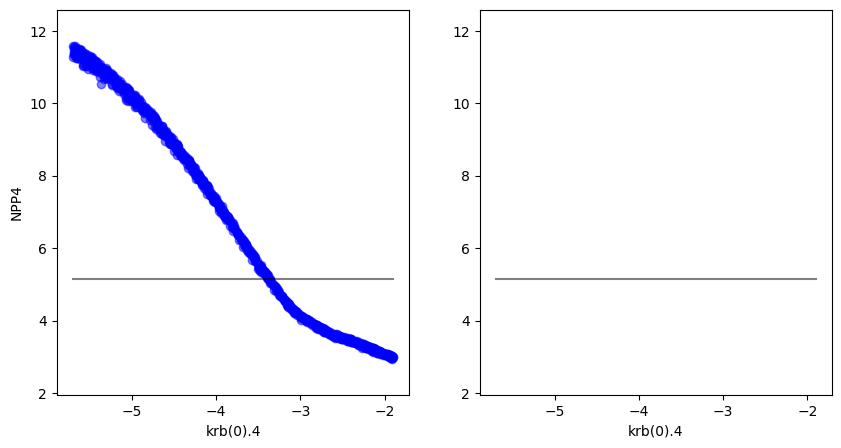

...

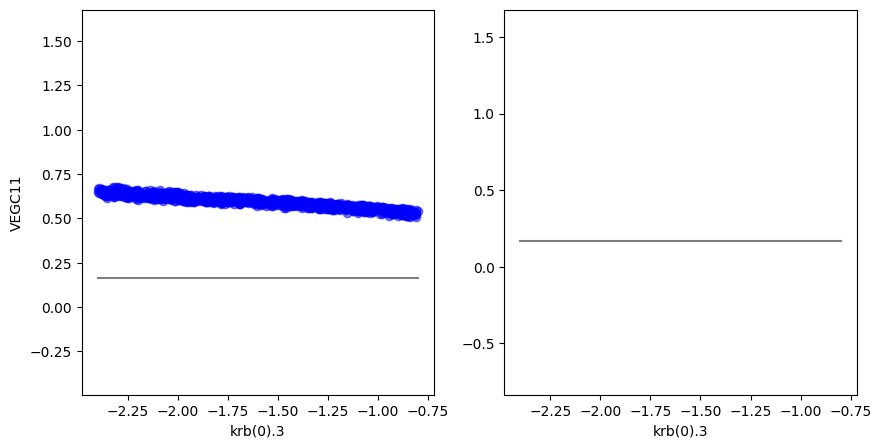

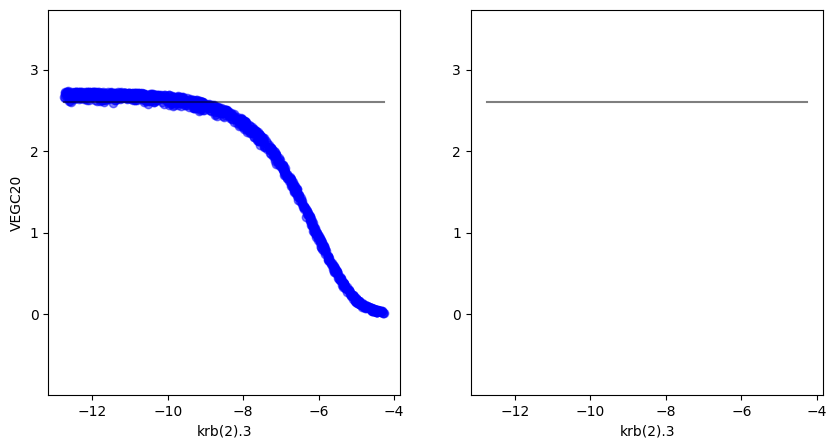

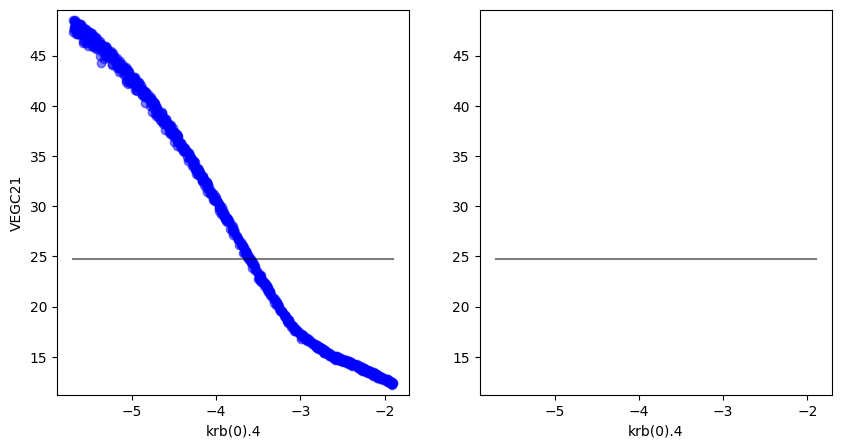

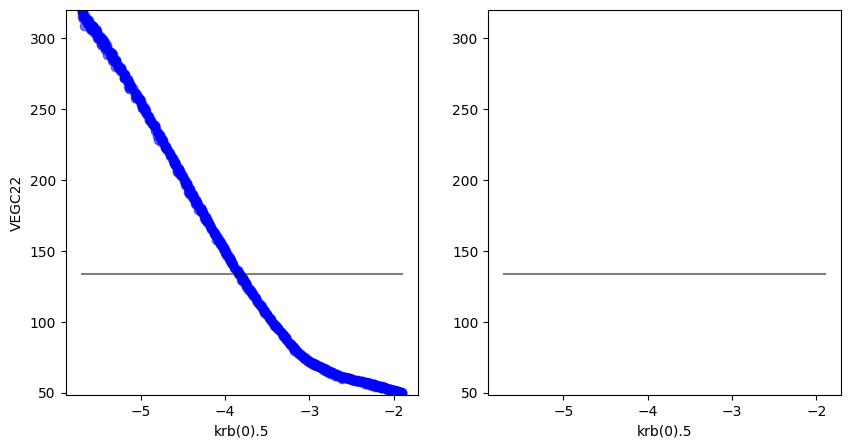

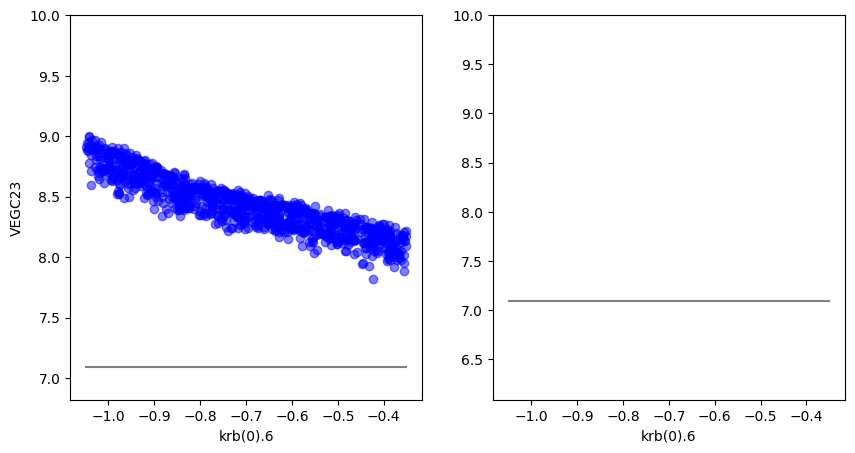

In [27]:
ut.plot_relationships(corr_mp,df_param,df_model,corr_thresh=0.50)

## (with cmax fixed) nmax + krb -> NPP + VEGC 

not much improvement...

In [59]:
params='sa_nmaxkrb_EML21_090_AK-2/sample_matrix.csv'
model='sa_nmaxkrb_EML21_090_AK-2/results.txt'
df_param = pd.read_csv(path_SA+params)
df_model = pd.read_csv(path_SA+model,header=None)

output_name = ['NPP0','NPP1','NPP2','NPP3','NPP4','NPP5','NPP6',\
               'VEGC00','VEGC01','VEGC02','VEGC03','VEGC04','VEGC05','VEGC06',\
                'VEGC10','VEGC11',\
                'VEGC20','VEGC21','VEGC22','VEGC23']
df_model.columns = output_name
units_NPP = 'gC/m2/year'
units_VEGC = 'gC/m2'
title_1='One to One Match Plot for Nmax targeting NPP'
title_2='Spaghetti Match Plot for Nmax targeting NPP'
title_3='Log Scale Spaghetti Match Plot for Nmax targeting NPP'

title_4='One to One Match Plot for krb targeting VEGC'
title_5='Spaghetti Match Plot for krb targeting VEGC'
title_6='Log Scale Spaghetti Match Plot for krb targeting VEGC'

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for Nmax targeting NPP')

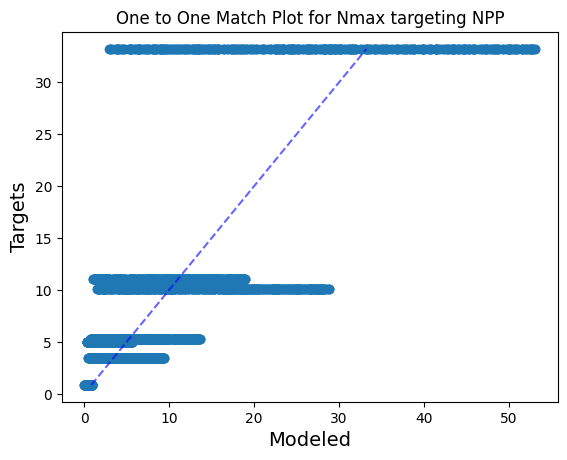

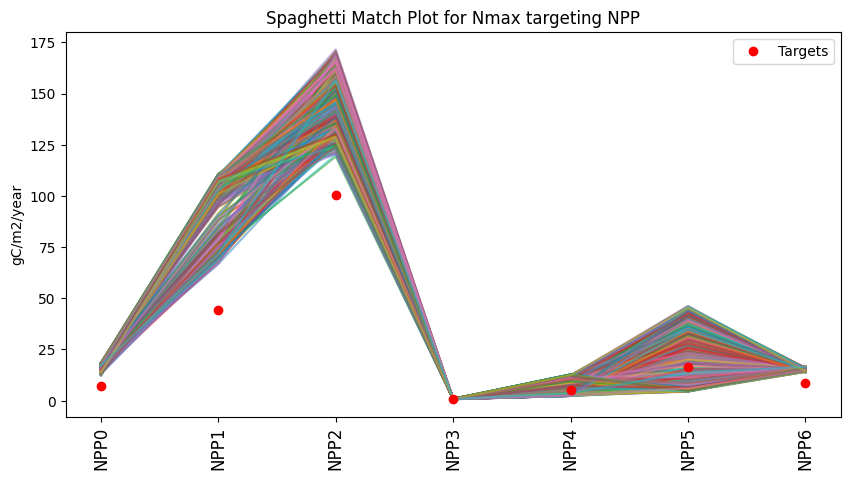

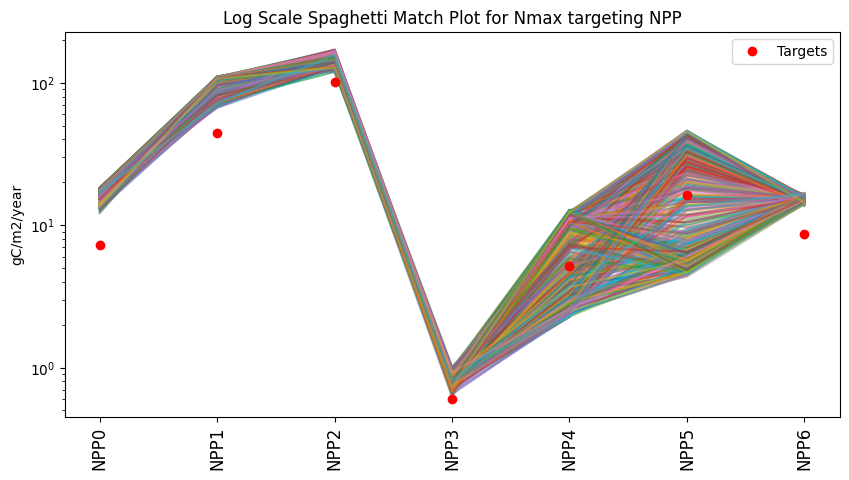

In [60]:
ut.one_to_one_match_plot(df_param.iloc[:,0:7])
plt.title(title_1)
ut.spaghetti_match_plot(df_param.iloc[:,0:7], df_model.iloc[:,0:7])
plt.ylabel(units_NPP)
plt.title(title_2)
ut.spaghetti_match_plot(df_param.iloc[:,0:7], df_model.iloc[:,0:7], logy=True)
plt.ylabel(units_NPP)
plt.title(title_3)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for krb targeting VEGC')

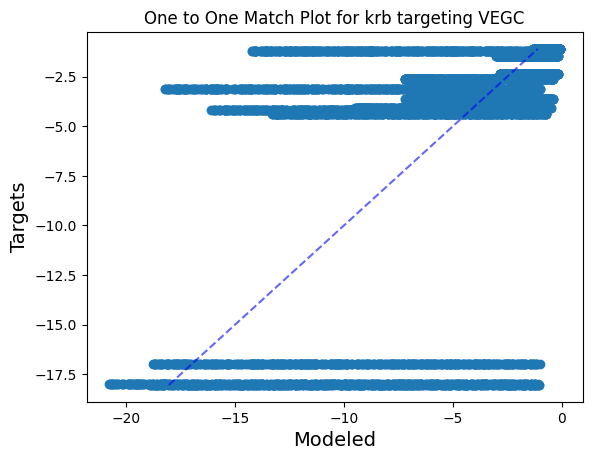

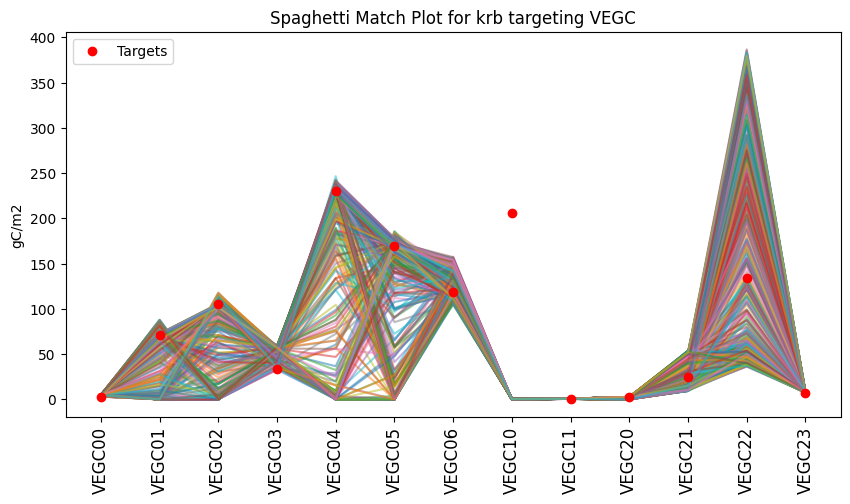

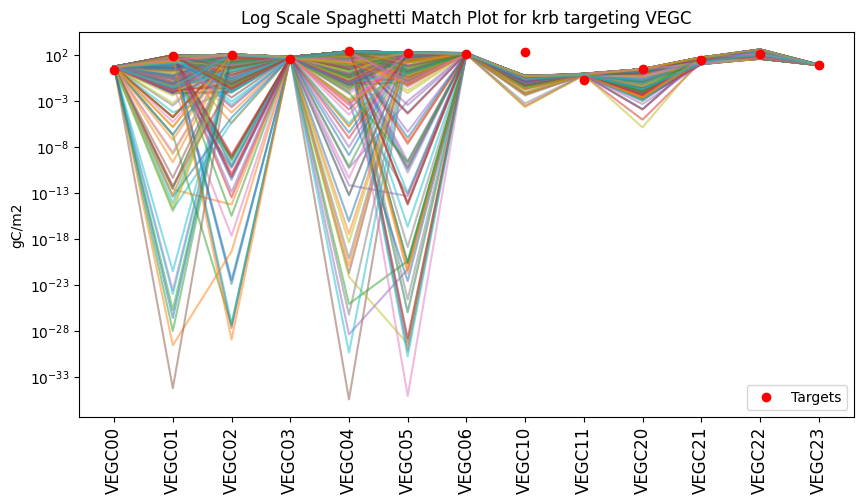

In [61]:
ut.one_to_one_match_plot(df_param.iloc[:,7:])
plt.title(title_4)
ut.spaghetti_match_plot(df_param.iloc[:,7:], df_model.iloc[:,7:])
plt.ylabel(units_VEGC)
plt.title(title_5)
ut.spaghetti_match_plot(df_param.iloc[:,7:], df_model.iloc[:,7:], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_6)

In [63]:
xparams, ymodel =  ut.get_params_r2_rmse(df_param,df_model,r2lim=0.5)
len(xparams)

4

# nmax -> NPP 

with variance of 0.9
nmax 2 is most important, but highly overestimated target. Not clear how to adjust param range to lower NPP2

In [12]:
params='sample_matrix_STEP2-MD21-EML-nmax1.csv'
model='results_STEP2-MD21-EML-nmax1.txt'
df_param = pd.read_csv(path_SA+params)
df_model = pd.read_csv(path_SA+model,header=None)

output_name = ['NPP0','NPP1','NPP2','NPP3','NPP4','NPP5','NPP6']
df_model.columns = output_name
units_NPP = 'gC/m2/year'
units_VEGC = 'gC/m2'
title_1='One to One Match Plot for Nmax targeting NPP'
title_2='Spaghetti Match Plot for Nmax targeting NPP'
title_3='Log Scale Spaghetti Match Plot for Nmax targeting NPP'

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for Nmax targeting NPP')

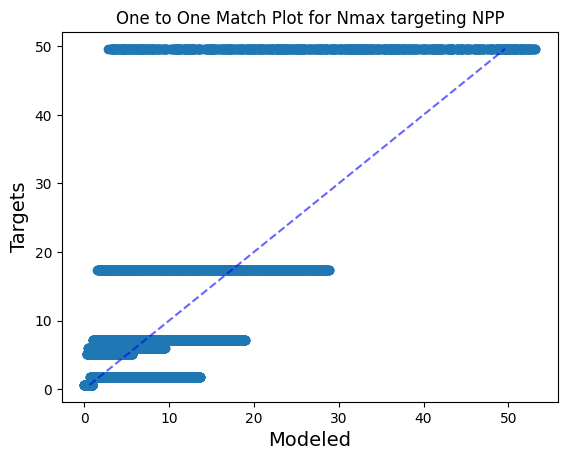

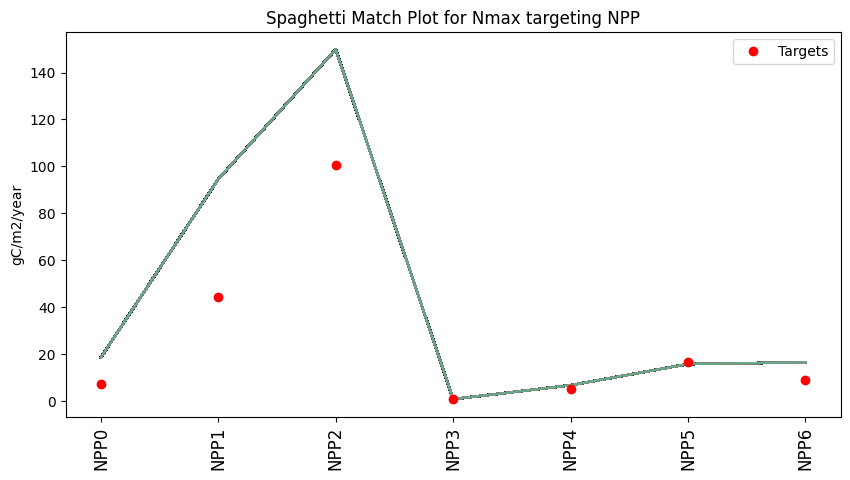

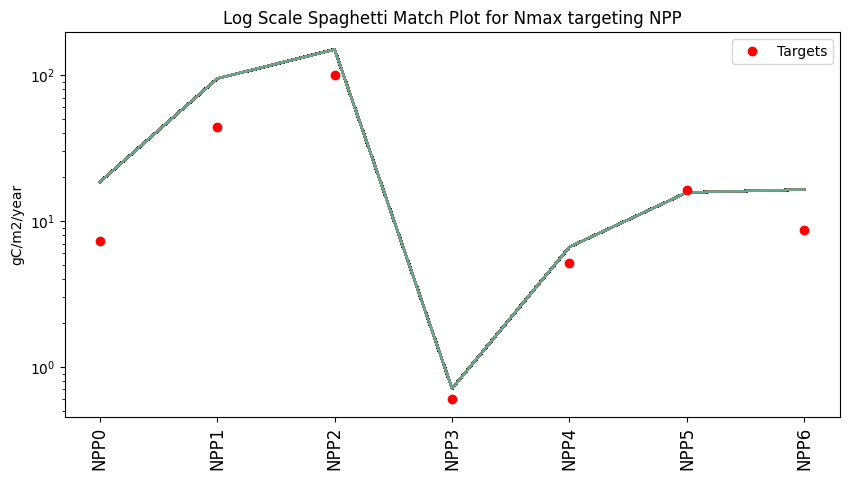

In [6]:
ut.one_to_one_match_plot(df_param)
plt.title(title_1)
ut.spaghetti_match_plot(df_param, df_model)
plt.ylabel(units_NPP)
plt.title(title_2)
ut.spaghetti_match_plot(df_param, df_model, logy=True)
plt.ylabel(units_NPP)
plt.title(title_3)

In [19]:
df_model.iloc[-1,:]

NPP0      7.277
NPP1     44.082
NPP2    100.470
NPP3      0.598
NPP4      5.156
NPP5     16.357
NPP6      8.713
Name: 1000, dtype: float64

In [11]:
xparams, ymodel =  ut.get_params_r2_rmse(df_param,df_model,r2lim=0.7)
xparams

,nmax,nmax.1,nmax.2,nmax.3,nmax.4,nmax.5,nmax.6,$R^2$,RMSE,MAPE
0,5.574040,50.716001,21.547354,0.588793,1.142501,3.807901,1.022753,0.73105,739.478074,0.337509
1,11.945643,33.096197,20.892866,0.068526,5.537513,15.983968,2.411052,0.73105,739.478073,0.337509
2,3.076452,12.043587,9.844068,0.522281,2.632503,6.242125,6.006676,0.73105,739.478104,0.337509
3,2.527840,17.524090,11.543660,0.460463,4.539950,4.594128,5.128110,0.73105,739.478073,0.337509
4,8.397693,5.141101,18.142427,0.203472,0.651279,18.079940,9.190688,0.73105,739.478052,0.337509
...,...,...,...,...,...,...,...,...,...,...
995,2.358977,45.264747,11.429289,0.644423,2.842409,4.580736,5.915179,0.73105,739.478022,0.337509
996,1.506453,23.632460,16.475385,0.442442,4.342830,15.902649,7.441188,0.73105,739.478000,0.337509
997,1.223016,12.584090,16.201581,0.891340,4.808767,16.165621,3.228874,0.73105,739.478000,0.337509
998,6.285645,26.523580,5.825687,0.077961,5.413276,5.332827,2.659540,0.73105,739.477961,0.337509


In [12]:
best=xparams[xparams.MAPE<1]
best_model=ymodel[xparams.MAPE<1]
best

,nmax,nmax.1,nmax.2,nmax.3,nmax.4,nmax.5,nmax.6,$R^2$,RMSE,MAPE
0,5.574040,50.716001,21.547354,0.588793,1.142501,3.807901,1.022753,0.73105,739.478074,0.337509
1,11.945643,33.096197,20.892866,0.068526,5.537513,15.983968,2.411052,0.73105,739.478073,0.337509
2,3.076452,12.043587,9.844068,0.522281,2.632503,6.242125,6.006676,0.73105,739.478104,0.337509
3,2.527840,17.524090,11.543660,0.460463,4.539950,4.594128,5.128110,0.73105,739.478073,0.337509
4,8.397693,5.141101,18.142427,0.203472,0.651279,18.079940,9.190688,0.73105,739.478052,0.337509
...,...,...,...,...,...,...,...,...,...,...
995,2.358977,45.264747,11.429289,0.644423,2.842409,4.580736,5.915179,0.73105,739.478022,0.337509
996,1.506453,23.632460,16.475385,0.442442,4.342830,15.902649,7.441188,0.73105,739.478000,0.337509
997,1.223016,12.584090,16.201581,0.891340,4.808767,16.165621,3.228874,0.73105,739.478000,0.337509
998,6.285645,26.523580,5.825687,0.077961,5.413276,5.332827,2.659540,0.73105,739.477961,0.337509


In [21]:
#print bounds of param from best scores
x_max = best.max()
x_min = best.min()

# Create a list of pairs [x_min, x_max] where x_min and x_max correspond to the same index in xparams
result = [[x_min[i], x_max[i]] for i in range(len(x_max))]

for pair in result:
    print("Uniform({:.5f}, {:.5f})".format(pair[0], pair[1]))

Uniform(0.72040, 13.66565)
Uniform(2.84755, 53.17045)
Uniform(1.53636, 28.86790)
Uniform(0.05141, 0.94929)
Uniform(0.30006, 5.68884)
Uniform(1.02437, 18.99029)
Uniform(0.51001, 9.49746)
Uniform(0.73105, 0.73105)
Uniform(739.47718, 739.47818)
Uniform(0.33751, 0.33751)


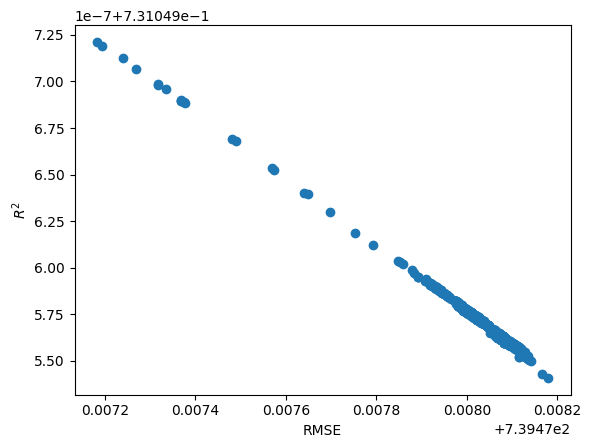

In [13]:
rmse=ut.plot_r2_rmse(df_model)

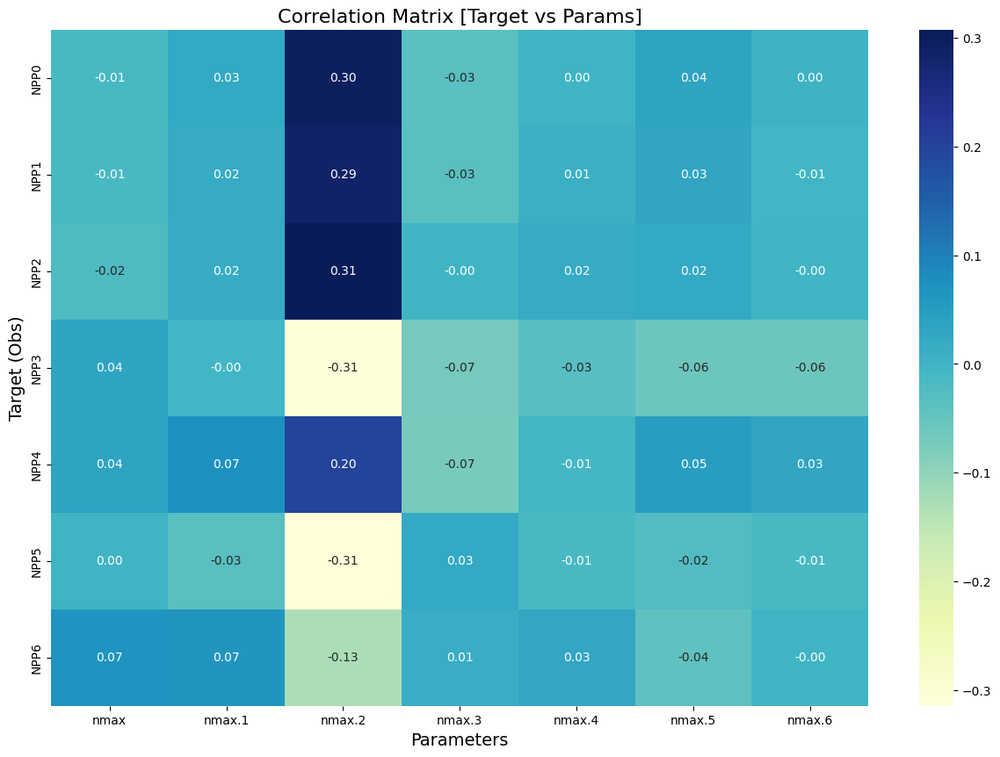

In [14]:
corr_mp=ut.get_output_param_corr(df_param,df_model)

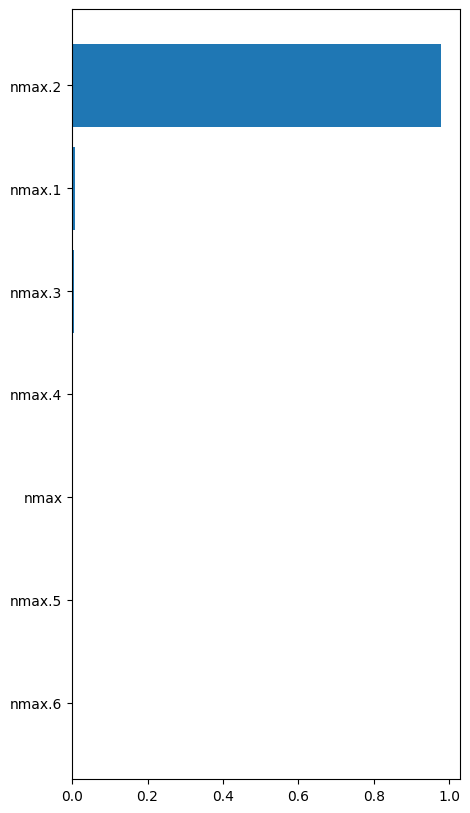

In [15]:
e_rmse=ut.find_important_features_err(df_param,df_model,error='rmse')

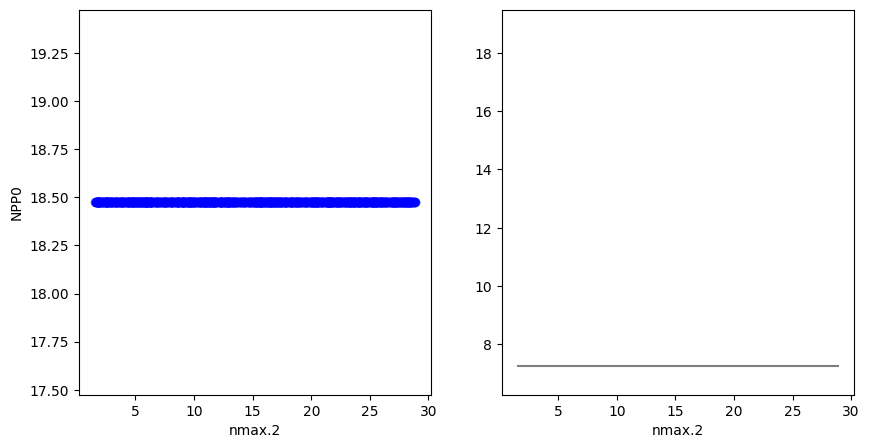

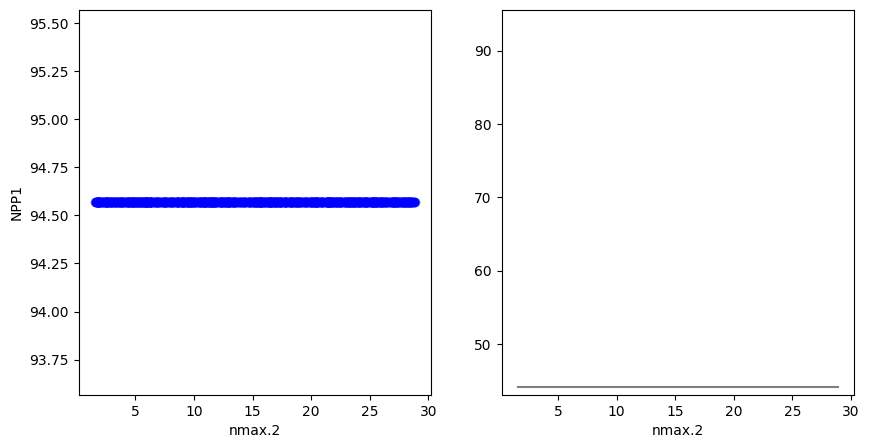

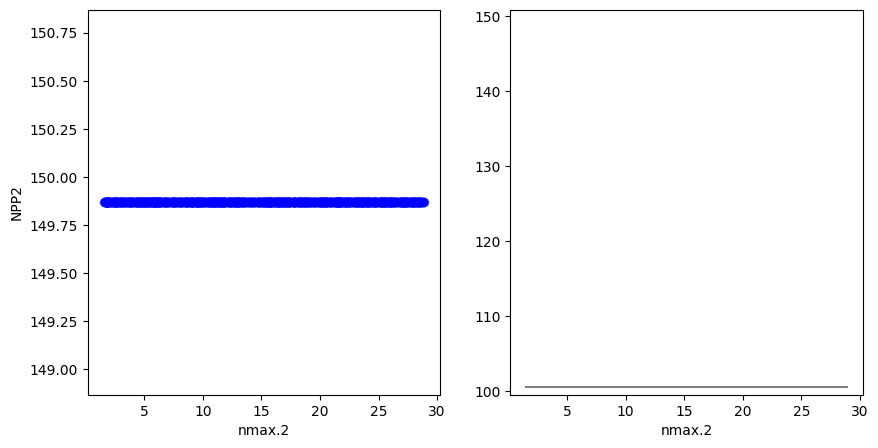

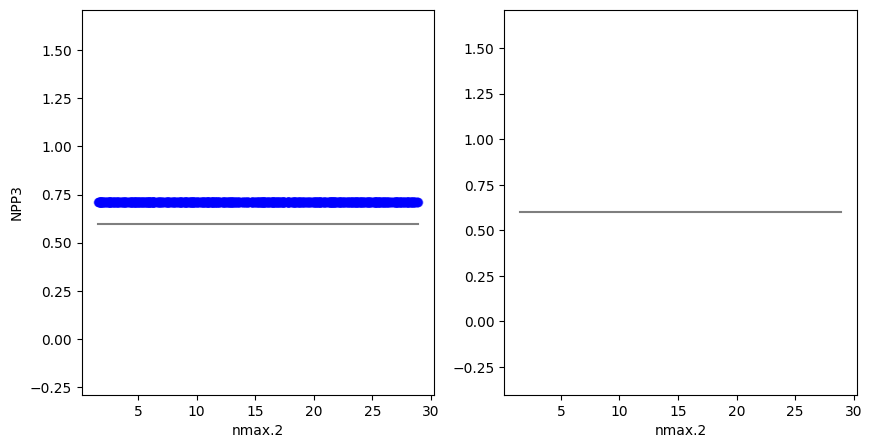

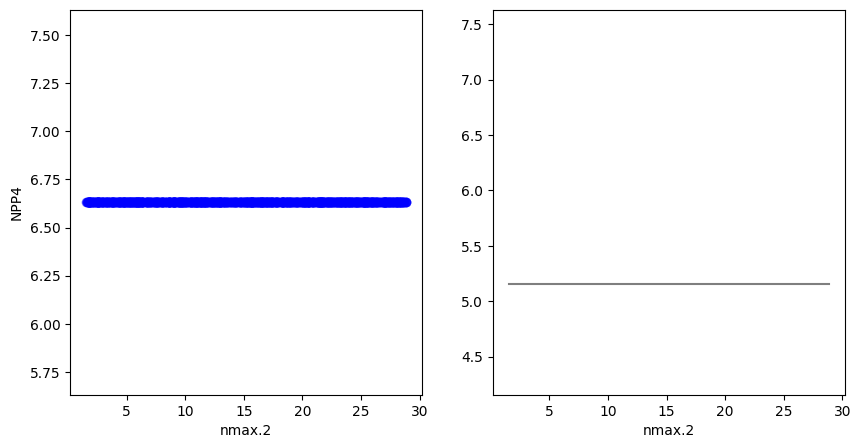

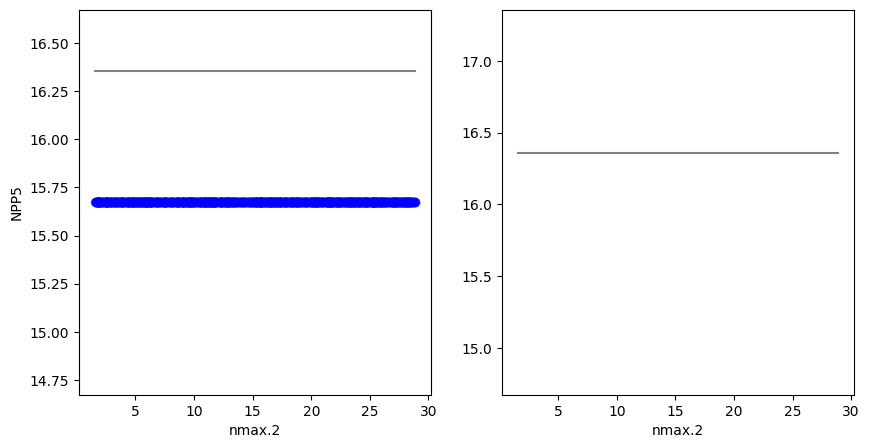

In [15]:
ut.plot_relationships(corr_mp,df_param,df_model,corr_thresh=0.20)

# krb -> NPP + VEGC

In [16]:
params='sa_krb_EML21_090_AK/sample_matrix.csv'
model='sa_krb_EML21_090_AK/results.txt'
df_param = pd.read_csv(path_SA+params)
df_model = pd.read_csv(path_SA+model,header=None)

output_name = ['NPP0','NPP1','NPP2','NPP3','NPP4','NPP5','NPP6',\
               'VEGC00','VEGC01','VEGC02','VEGC03','VEGC04','VEGC05','VEGC06',\
                'VEGC10','VEGC11',\
                'VEGC20','VEGC21','VEGC22','VEGC23',\
                'VEGN00','VEGN01','VEGN02','VEGN03','VEGN04','VEGN05','VEGN06',\
                'VEGN10','VEGN11',\
                'VEGN20','VEGN21','VEGN22','VEGN23']
df_model.columns = output_name
units_NPP = 'gC/m2/year'
units_VEGC = 'gC/m2'
title_1='One to One Match Plot for Nmax targeting NPP'
title_2='Spaghetti Match Plot for Nmax targeting NPP'
title_3='Log Scale Spaghetti Match Plot for Nmax targeting NPP'

title_4='One to One Match Plot for krb targeting VEGC'
title_5='Spaghetti Match Plot for krb targeting VEGC'
title_6='Log Scale Spaghetti Match Plot for krb targeting VEGC'

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for Nmax targeting NPP')

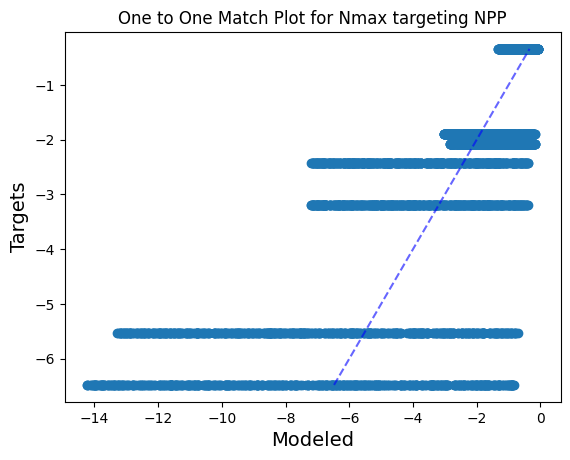

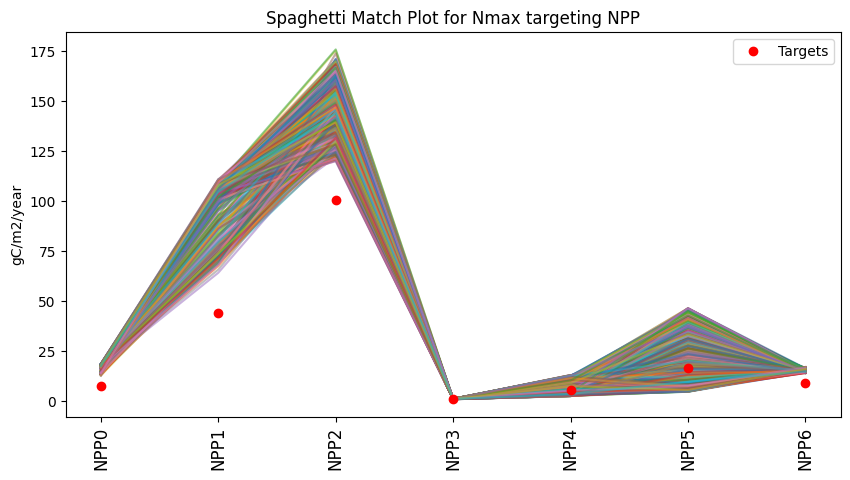

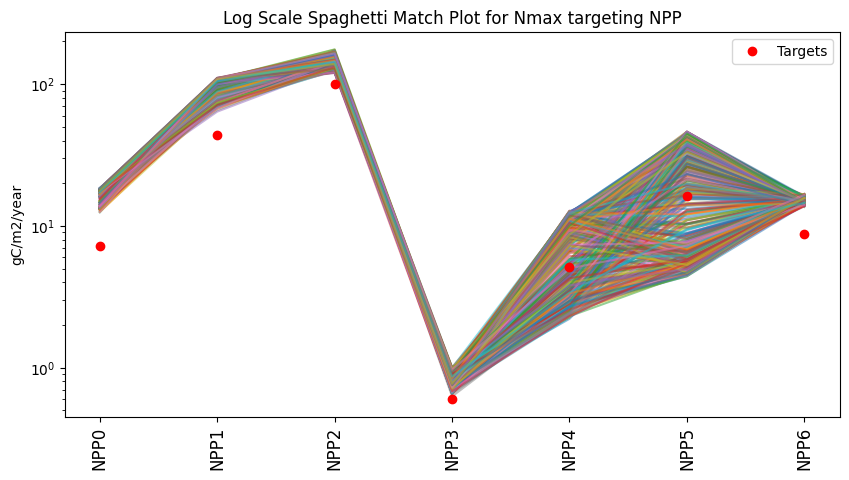

In [5]:
ut.one_to_one_match_plot(df_param.iloc[:,0:7])
plt.title(title_1)
ut.spaghetti_match_plot(df_param.iloc[:,0:7], df_model.iloc[:,0:7])
plt.ylabel(units_NPP)
plt.title(title_2)
ut.spaghetti_match_plot(df_param.iloc[:,0:7], df_model.iloc[:,0:7], logy=True)
plt.ylabel(units_NPP)
plt.title(title_3)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for krb targeting VEGC')

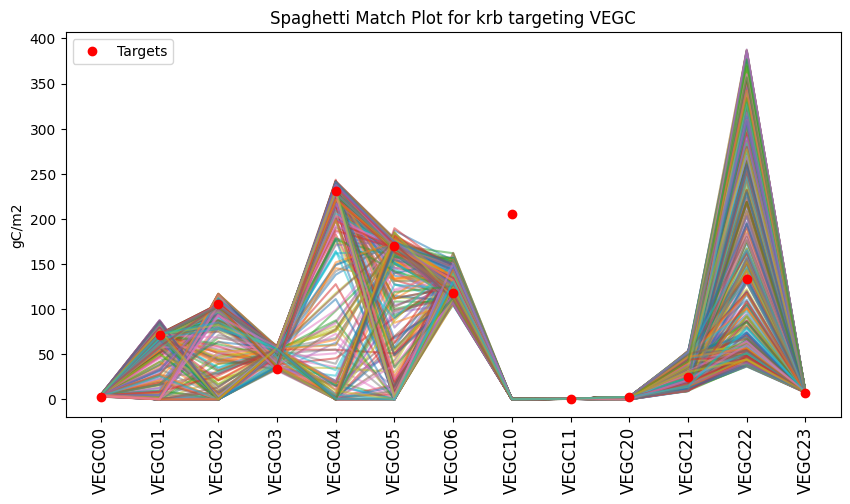

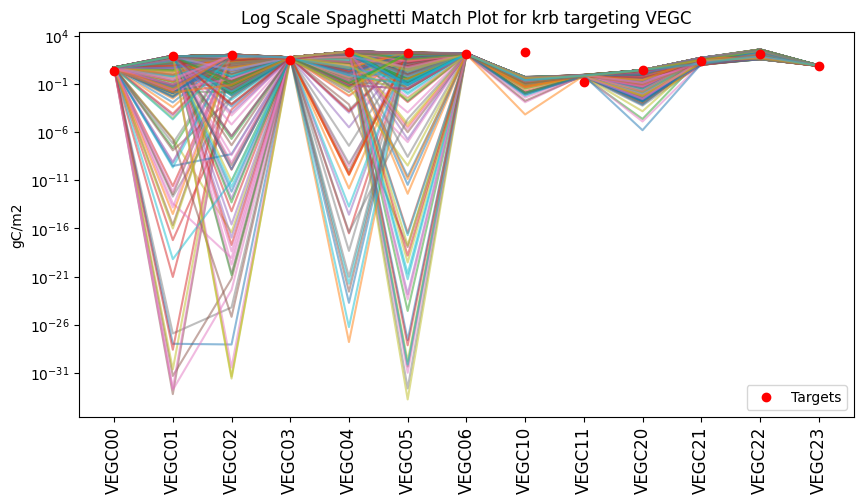

In [6]:
ut.spaghetti_match_plot(df_param.iloc[:,7:20], df_model.iloc[:,7:20])
plt.ylabel(units_VEGC)
plt.title(title_5)
ut.spaghetti_match_plot(df_param.iloc[:,7:20], df_model.iloc[:,7:20], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_6)

In [ ]:
ut.one_to_one_match_plot(df_param.iloc[:,20:])
plt.title(title_4)
ut.spaghetti_match_plot(df_param.iloc[:,20:], df_model.iloc[:,20:])
plt.ylabel(units_VEGC)
plt.title(title_5)
ut.spaghetti_match_plot(df_param.iloc[:,20:], df_model.iloc[:,20:], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_6)

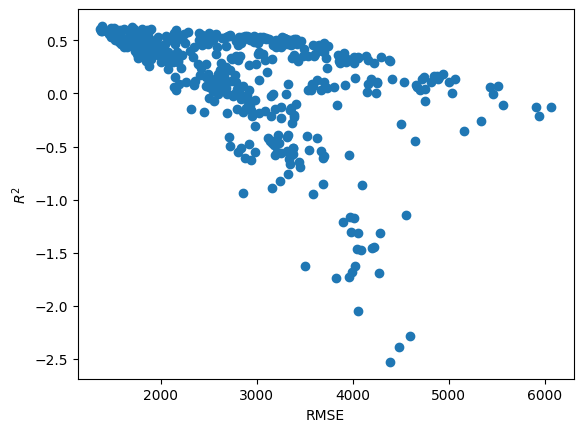

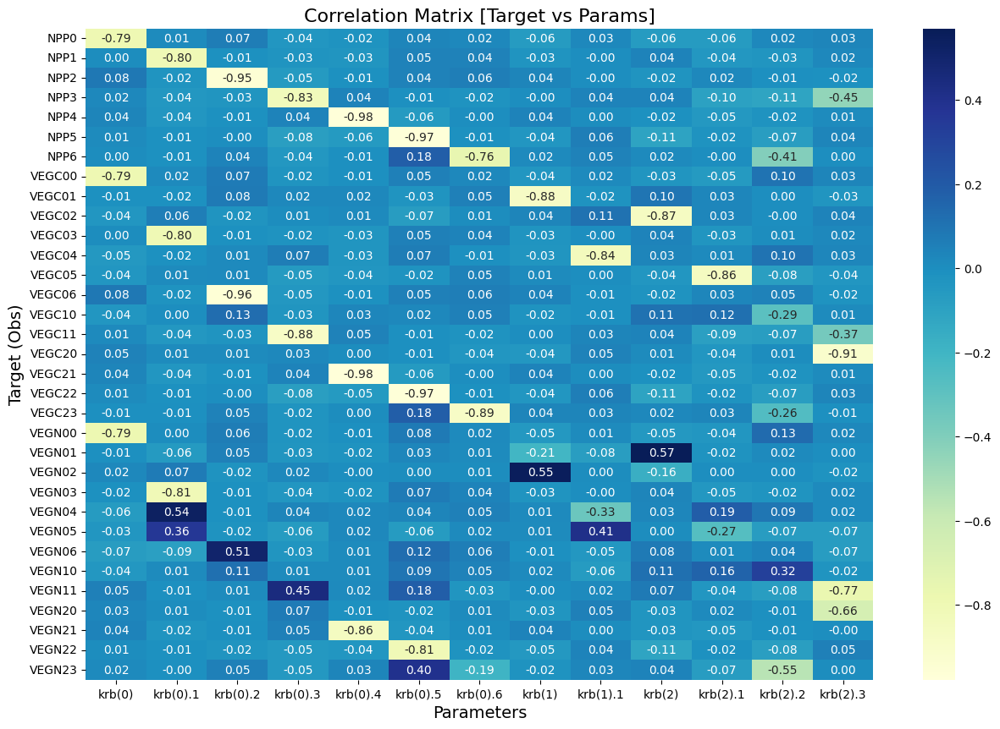

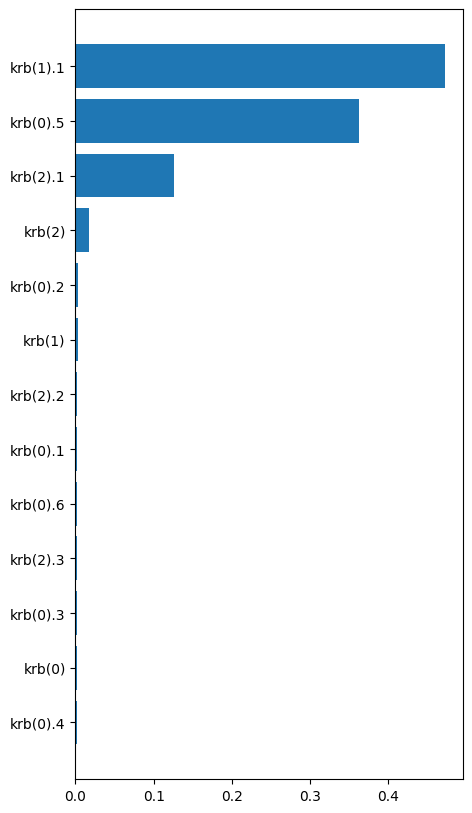

In [17]:
rmse=ut.plot_r2_rmse(df_model)
corr_mp=ut.get_output_param_corr(df_param,df_model)
e_rmse=ut.find_important_features_err(df_param,df_model,error='rmse')

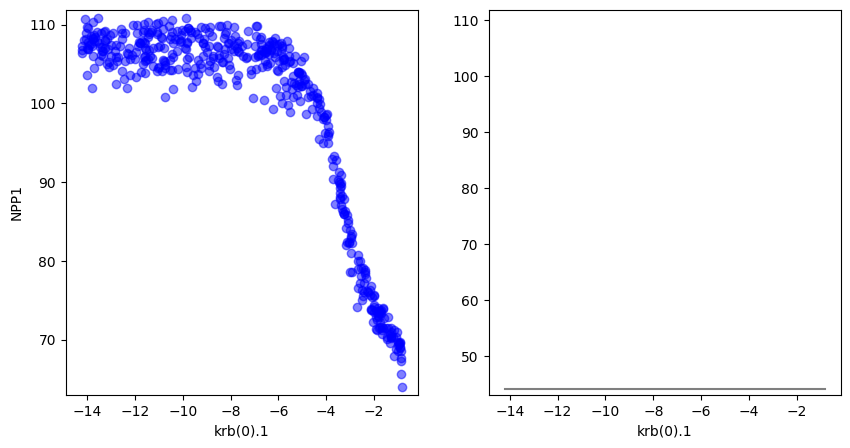

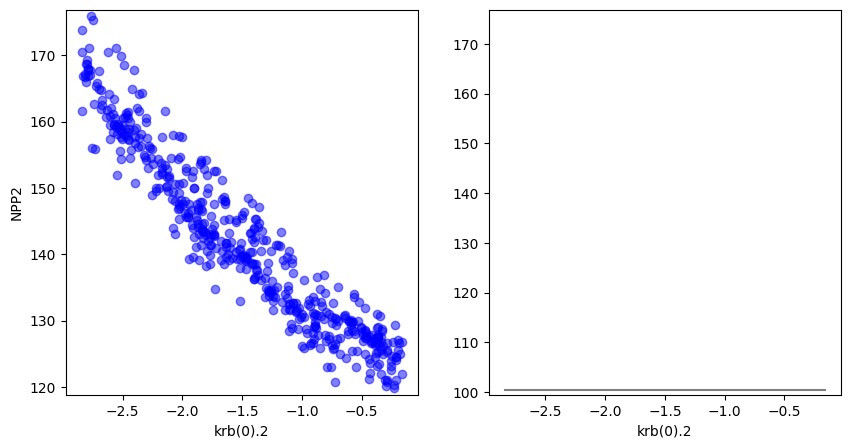

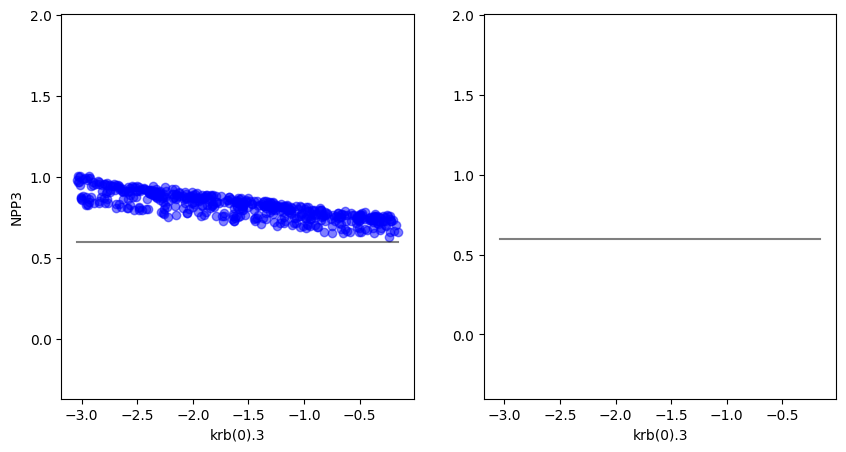

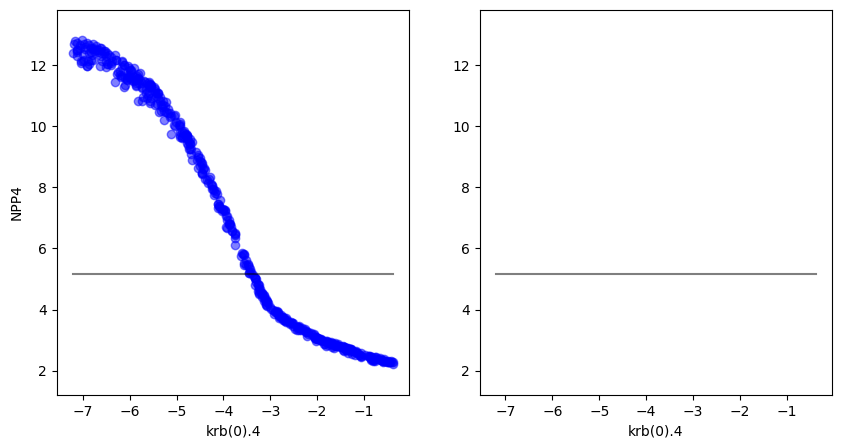

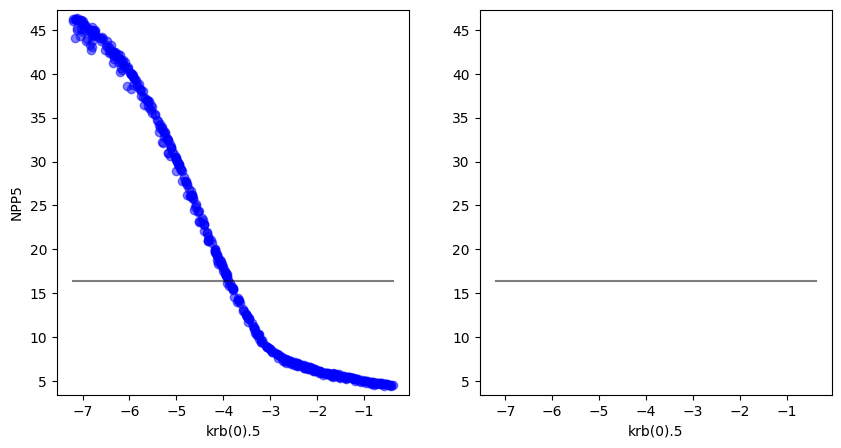

...

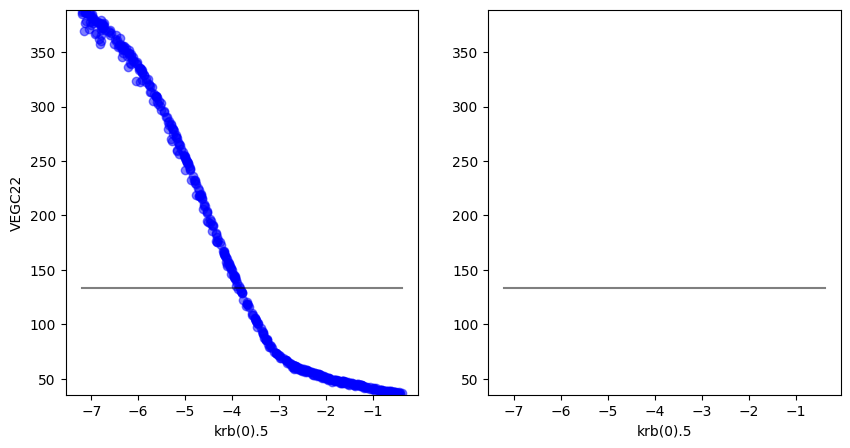

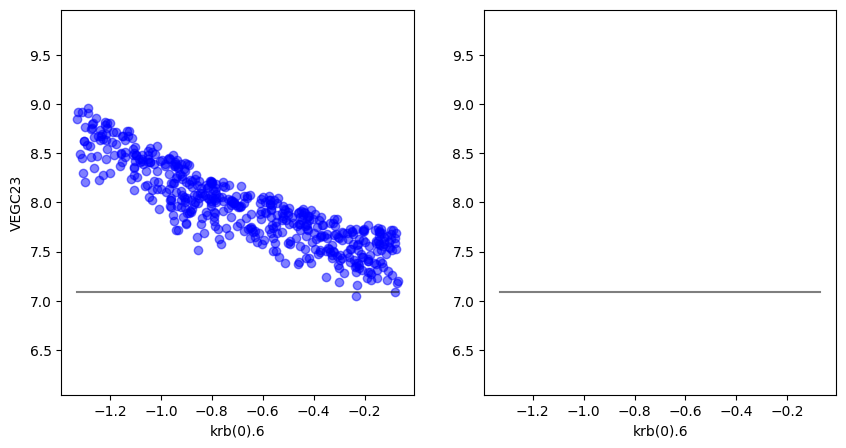

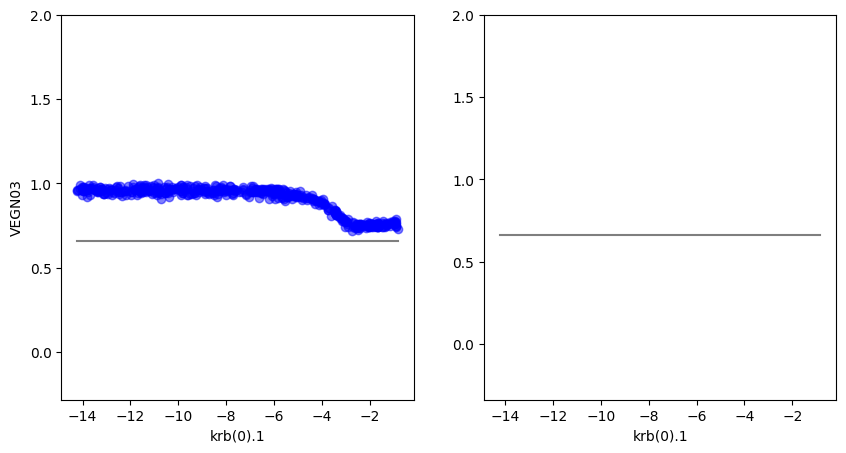

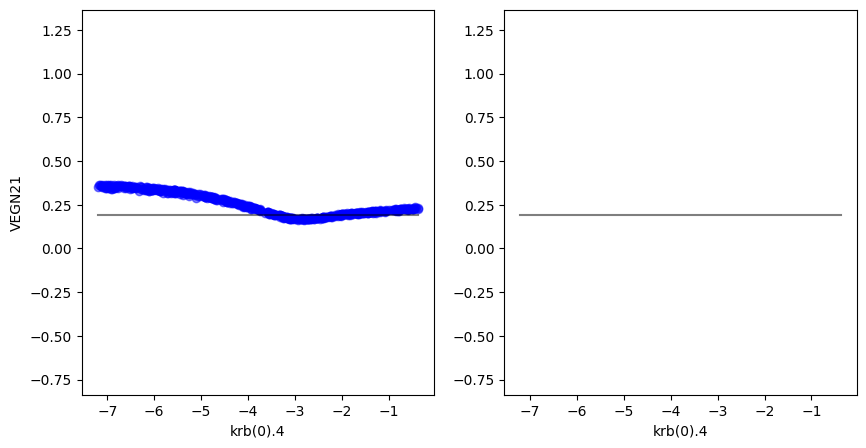

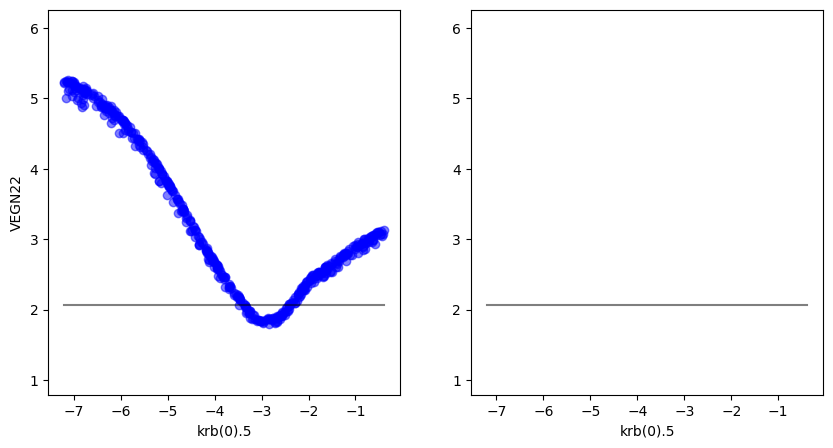

In [18]:
ut.plot_relationships(corr_mp,df_param,df_model,corr_thresh=0.80)

In [22]:
xparams, ymodel =  ut.get_params_r2_rmse(df_param,df_model,r2lim=0.6)
len(xparams)

12

In [23]:
xparams.describe()

,krb(0),krb(0).1,krb(0).2,krb(0).3,krb(0).4,krb(0).5,krb(0).6,krb(1),krb(1).1,krb(2),krb(2).1,krb(2).2,krb(2).3,$R^2$,RMSE,MAPE
count,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000,1.200000e+01
mean,-7.468797,-4.655425,-1.712649,-1.638795,-3.609087,-4.512899,-0.709526,-11.532046,-14.452295,-12.326511,-13.652944,-5.790081,-6.826175,0.611883,1665.764017,8.151288e+14
std,4.071051,3.278564,0.631922,0.924729,1.429775,0.472017,0.435668,4.556073,3.998037,3.561541,2.576863,2.683947,5.212910,0.011179,236.746156,2.823689e+15
min,-12.897762,-9.785122,-2.793249,-2.934878,-6.788792,-5.307427,-1.325243,-18.164749,-19.459603,-18.755639,-18.568249,-9.180290,-14.414910,0.600153,1366.881072,2.661656e+01
25%,-11.706494,-7.177891,-2.005135,-2.402667,-3.963816,-4.835176,-1.071673,-14.073773,-17.784817,-14.868863,-15.429610,-7.672776,-11.563347,0.604119,1488.815414,3.231326e+01
50%,-7.483367,-3.877913,-1.637837,-1.653006,-3.558818,-4.633751,-0.618009,-12.501716,-14.407258,-11.548735,-13.985780,-6.427923,-5.227448,0.609152,1659.464701,4.793861e+01
75%,-4.276554,-1.620991,-1.391919,-0.812486,-2.846563,-4.135513,-0.397440,-8.824915,-10.542959,-9.485714,-11.455508,-3.043664,-2.334023,0.616080,1819.410950,6.105466e+01
max,-1.042310,-0.883972,-0.565216,-0.363606,-1.674099,-3.785038,-0.156258,-1.290326,-9.909362,-7.769085,-10.282230,-1.629952,-1.109299,0.636304,2156.995605,9.781545e+15


# cfall -> NPP + VEGC + VEGN

In [11]:
params='sa_cfall_EML21_090_AK/sample_matrix.csv'
model='sa_cfall_EML21_090_AK/results.txt'
df_param = pd.read_csv(path_SA_old+params)
df_model = pd.read_csv(path_SA_old+model,header=None)

output_name = ['NPP0','NPP1','NPP2','NPP3','NPP4','NPP5','NPP6',\
               'VEGC00','VEGC01','VEGC02','VEGC03','VEGC04','VEGC05','VEGC06',\
                'VEGC10','VEGC11',\
                'VEGC20','VEGC21','VEGC22','VEGC23',\
                'VEGN00','VEGN01','VEGN02','VEGN03','VEGN04','VEGN05','VEGN06',\
                'VEGN10','VEGN11',\
                'VEGN20','VEGN21','VEGN22','VEGN23']
df_model.columns = output_name
units_NPP = 'gC/m2/year'
units_VEGC = 'gC/m2'
title_1='One to One Match Plot for cfall targeting NPP'
title_2='Spaghetti Match Plot for cfall targeting NPP'
title_3='Log Scale Spaghetti Match Plot for cfall targeting NPP'

title_4='One to One Match Plot for cfall targeting VEGC'
title_5='Spaghetti Match Plot for cfall targeting VEGC'
title_6='Log Scale Spaghetti Match Plot for cfall targeting VEGC'

title_4='One to One Match Plot for cfall targeting VEGN'
title_5='Spaghetti Match Plot for cfall targeting VEGN'
title_6='Log Scale Spaghetti Match Plot for cfall targeting VEGN'


In [21]:
!cat ../../old_tem_repo/dvm-dos-tem/mads_calibration/SA/EML/sa_cfall_EML21_090_AK/param_props.csv

name,bounds,initial,cmtnum,pftnum
cfall(0),"[0.014999999999999986, 0.28500000000000003]",0.15,21,0
cfall(0),"[0.002999999999999999, 0.056999999999999995]",0.03,21,1
cfall(0),"[0.002999999999999999, 0.056999999999999995]",0.03,21,2
cfall(0),"[0.0019999999999999983, 0.038000000000000006]",0.02,21,3
cfall(0),"[0.0009999999999999992, 0.019000000000000003]",0.01,21,4
cfall(0),"[0.013899999999999996, 0.2641]",0.139,21,5
cfall(0),"[5.000000000000003e-07, 9.5e-06]",5e-06,21,6
cfall(1),"[4e-07, 7.6e-06]",4e-06,21,0
cfall(1),"[1.0000000000000006e-06, 1.9e-05]",1e-05,21,1
cfall(2),"[1.0000000000000006e-06, 1.9e-05]",1e-05,21,0
cfall(2),"[0.001899999999999999, 0.0361]",0.019,21,1
cfall(2),"[1.0000000000000006e-06, 1.9e-05]",1e-05,21,2
cfall(2),"[1.0000000000000006e-06, 1.9e-05]",1e-05,21,3


Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for cfall targeting NPP')

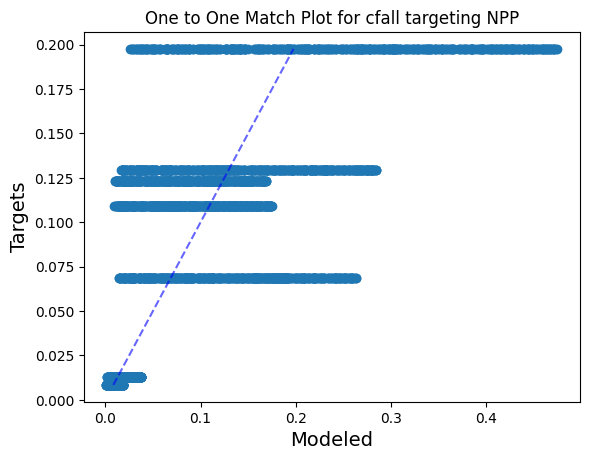

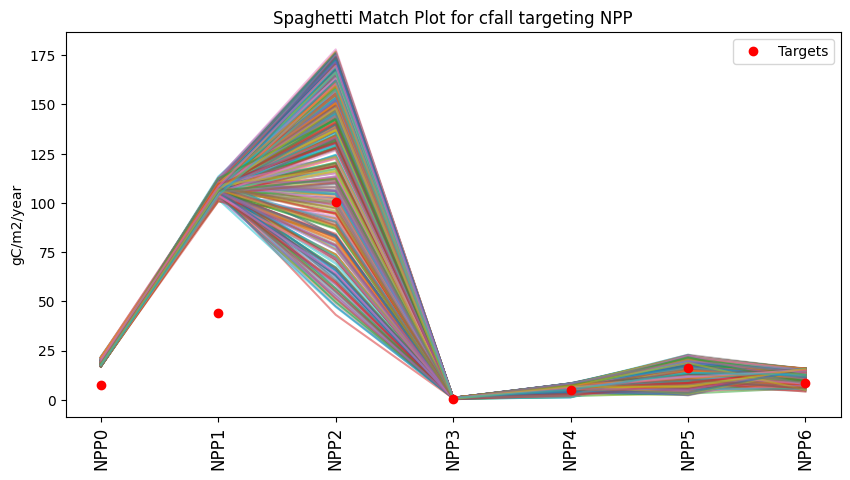

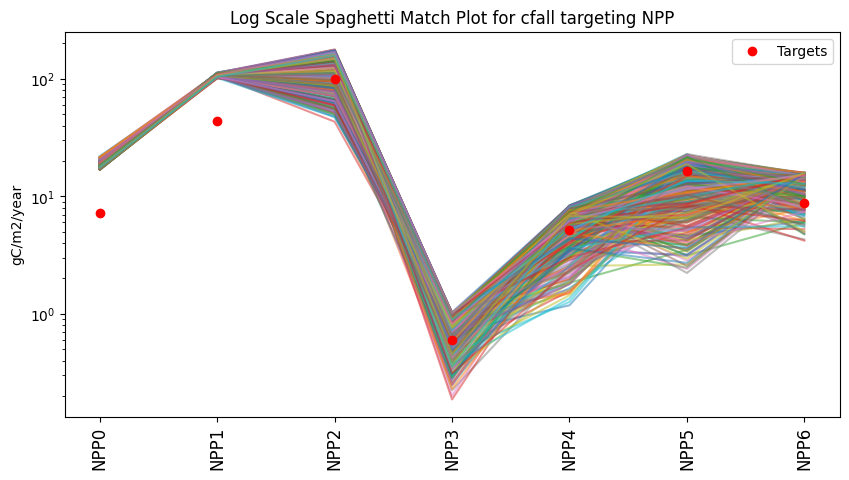

In [33]:
ut.one_to_one_match_plot(df_param.iloc[:,0:7])
plt.title(title_1)
ut.spaghetti_match_plot(df_param.iloc[:,0:7], df_model.iloc[:,0:7])
plt.ylabel(units_NPP)
plt.title(title_2)
ut.spaghetti_match_plot(df_param.iloc[:,0:7], df_model.iloc[:,0:7], logy=True)
plt.ylabel(units_NPP)
plt.title(title_3)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for cfall targeting VEGN')

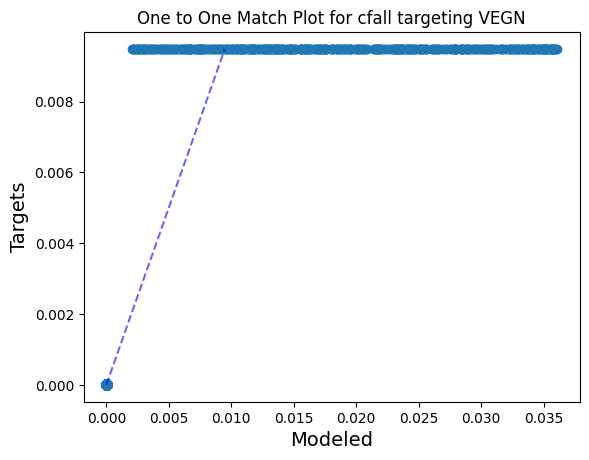

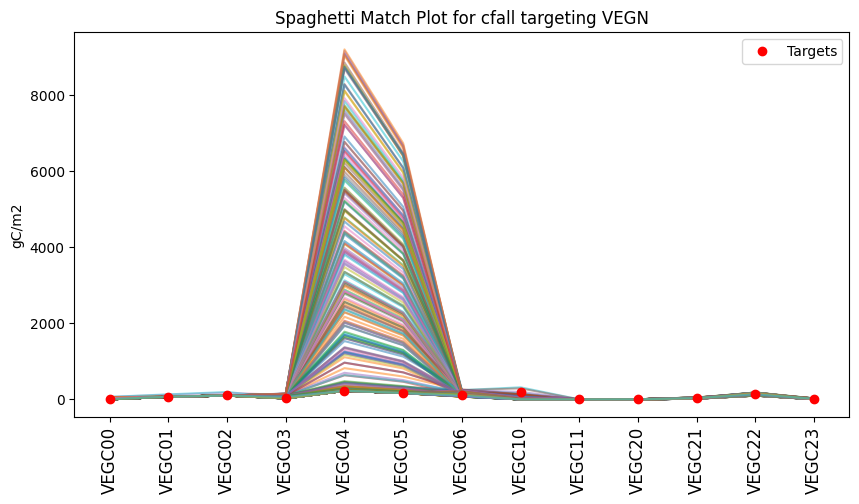

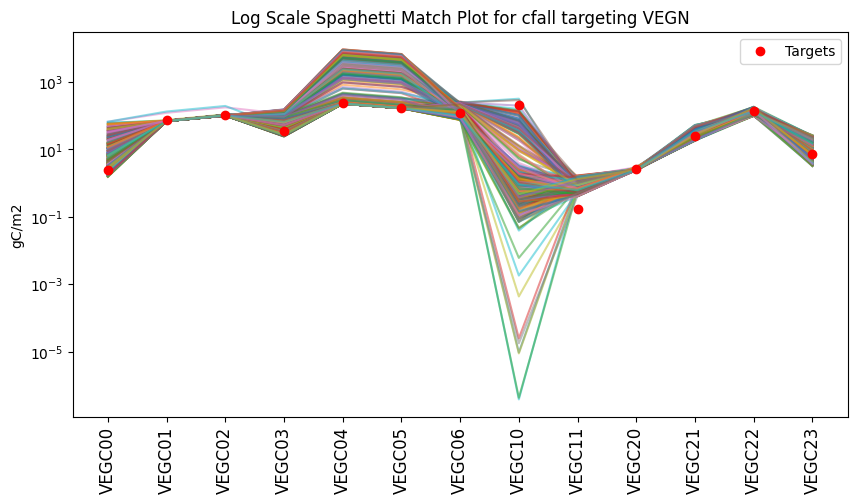

In [34]:
ut.one_to_one_match_plot(df_param.iloc[:,7:20])
plt.title(title_4)
ut.spaghetti_match_plot(df_param.iloc[:,7:20], df_model.iloc[:,7:20])
plt.ylabel(units_VEGC)
plt.title(title_5)
ut.spaghetti_match_plot(df_param.iloc[:,7:20], df_model.iloc[:,7:20], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_6)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for cfall targeting VEGN')

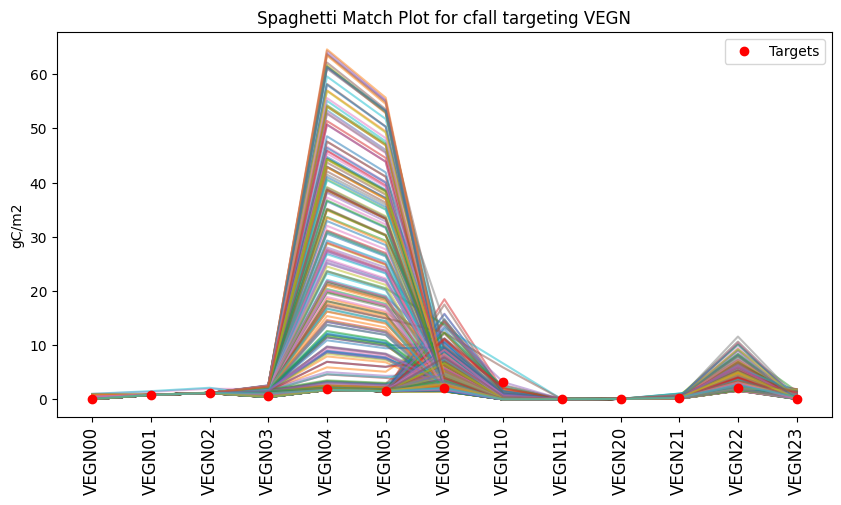

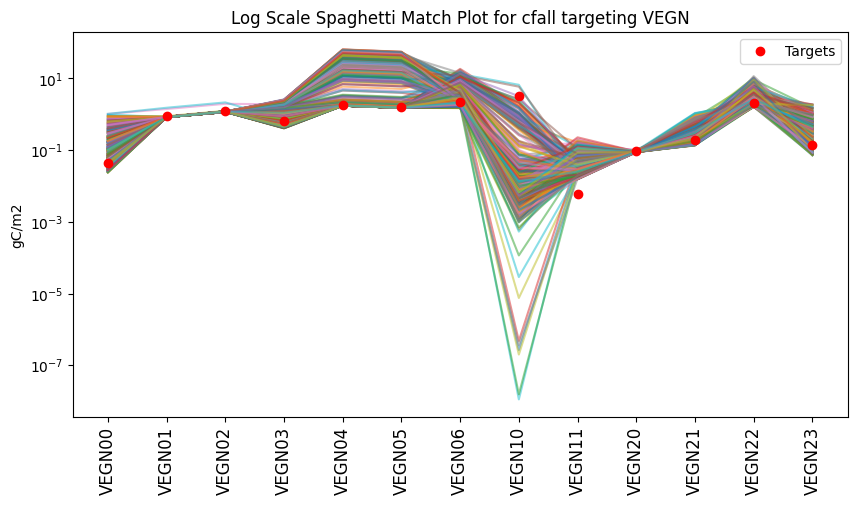

In [37]:
ut.spaghetti_match_plot(df_param, df_model.iloc[:,20:])
plt.ylabel(units_VEGC)
plt.title(title_5)
ut.spaghetti_match_plot(df_param, df_model.iloc[:,20:], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_6)

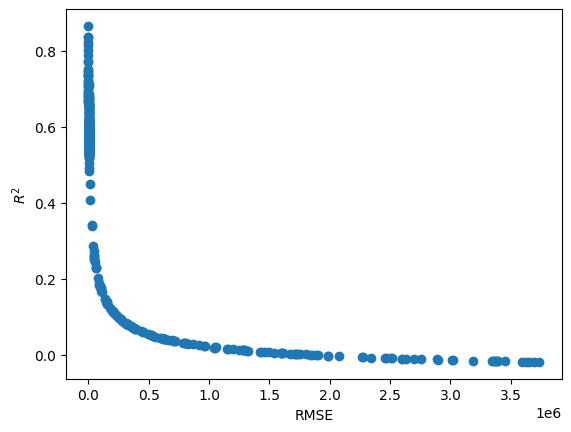

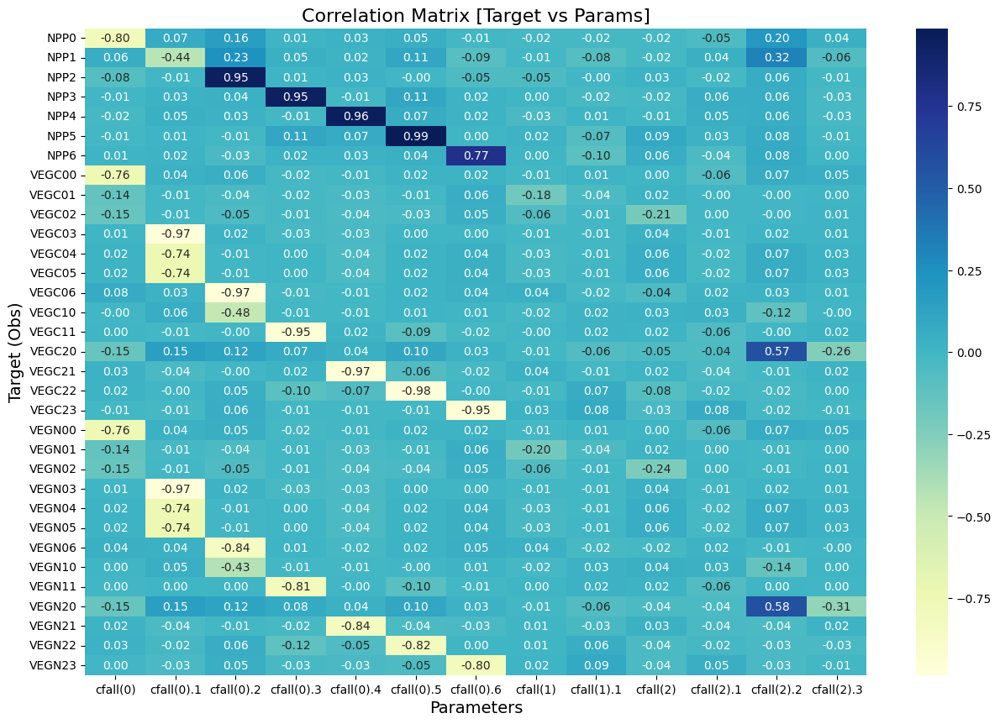

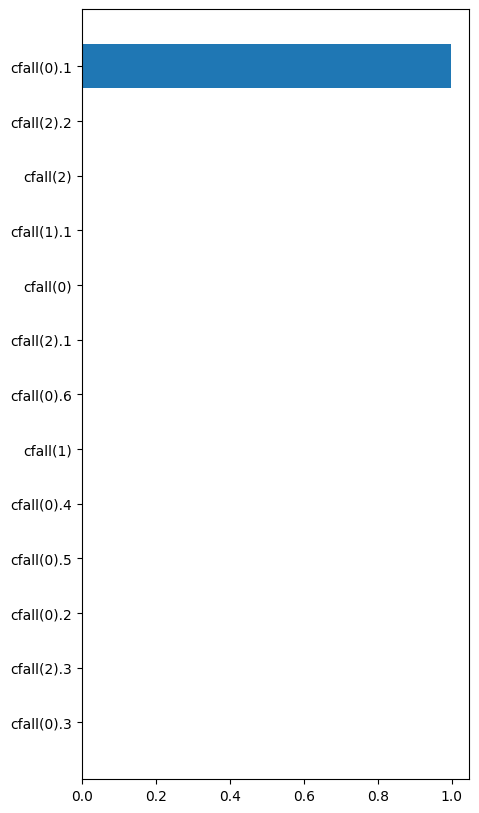

In [12]:
rmse=ut.plot_r2_rmse(df_model)
corr_mp=ut.get_output_param_corr(df_param,df_model)
e_rmse=ut.find_important_features_err(df_param,df_model,error='rmse')

In [13]:
xparams, ymodel =  ut.get_params_r2_rmse(df_param,df_model,r2lim=0.8)
len(xparams)

6

In [14]:
xparams.describe()

,cfall(0),cfall(0).1,cfall(0).2,cfall(0).3,cfall(0).4,cfall(0).5,cfall(0).6,cfall(1),cfall(1).1,cfall(2),cfall(2).1,cfall(2).2,cfall(2).3,$R^2$,RMSE,MAPE
count,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000e+00,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000
mean,0.327725,0.171247,0.016378,0.064064,0.023440,0.007786,0.105344,4.185605e-06,0.000005,0.000011,0.000003,0.004886,0.000010,0.829392,841.888702,0.349886
std,0.135589,0.052886,0.002953,0.043246,0.011577,0.005236,0.086261,2.921811e-06,0.000002,0.000004,0.000001,0.002068,0.000008,0.021507,133.590020,0.028074
min,0.140719,0.108155,0.013405,0.021717,0.006639,0.003630,0.013957,8.879010e-07,0.000002,0.000006,0.000001,0.002118,0.000001,0.802465,688.045881,0.310556
25%,0.223429,0.133753,0.014009,0.044207,0.017733,0.005303,0.042546,2.113950e-06,0.000003,0.000008,0.000002,0.003206,0.000003,0.816943,749.029817,0.341010
50%,0.365333,0.166522,0.016187,0.051167,0.022138,0.006468,0.080715,3.826239e-06,0.000005,0.000010,0.000003,0.005796,0.000010,0.828707,834.696715,0.348268
75%,0.434831,0.201422,0.017525,0.067158,0.033329,0.006920,0.175457,5.677850e-06,0.000006,0.000014,0.000003,0.006348,0.000017,0.836122,894.506275,0.354630
max,0.460842,0.250398,0.021232,0.145955,0.036403,0.018165,0.219815,8.735014e-06,0.000006,0.000016,0.000005,0.006729,0.000018,0.864859,1058.975923,0.396883


In [15]:
best_model = pd.concat([ymodel, df_model.iloc[-1:]], ignore_index=True)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for cfall targeting NPP')

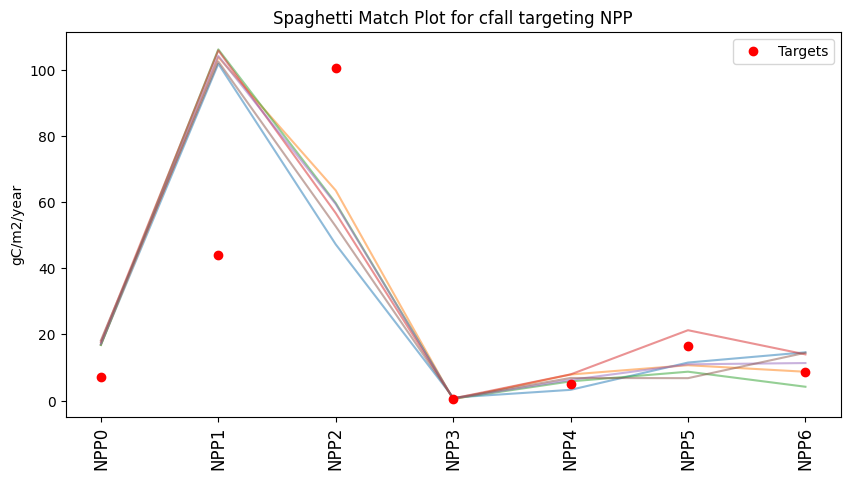

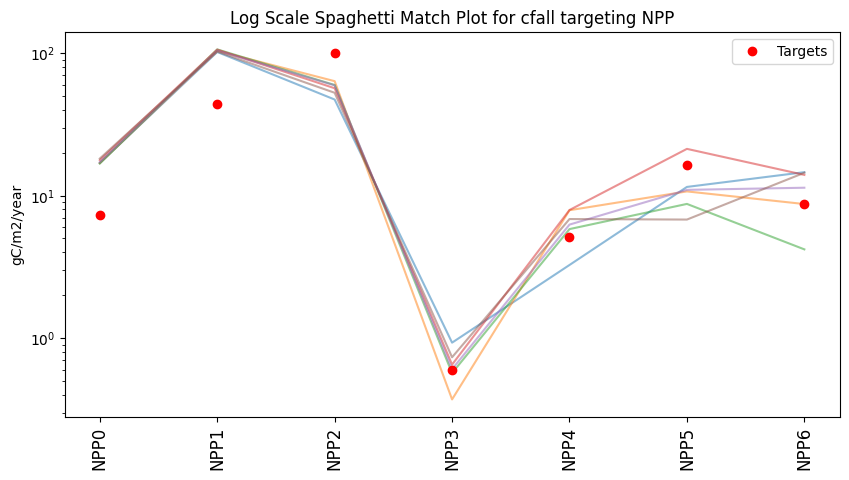

In [16]:
ut.spaghetti_match_plot(xparams.iloc[:,0:7], best_model.iloc[:,0:7])
plt.ylabel(units_NPP)
plt.title(title_2)
ut.spaghetti_match_plot(xparams.iloc[:,0:7], best_model.iloc[:,0:7], logy=True)
plt.ylabel(units_NPP)
plt.title(title_3)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for cfall targeting VEGN')

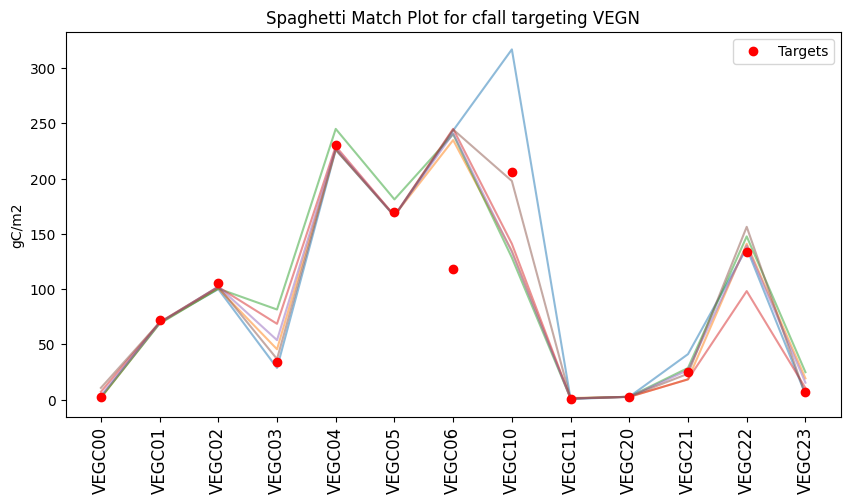

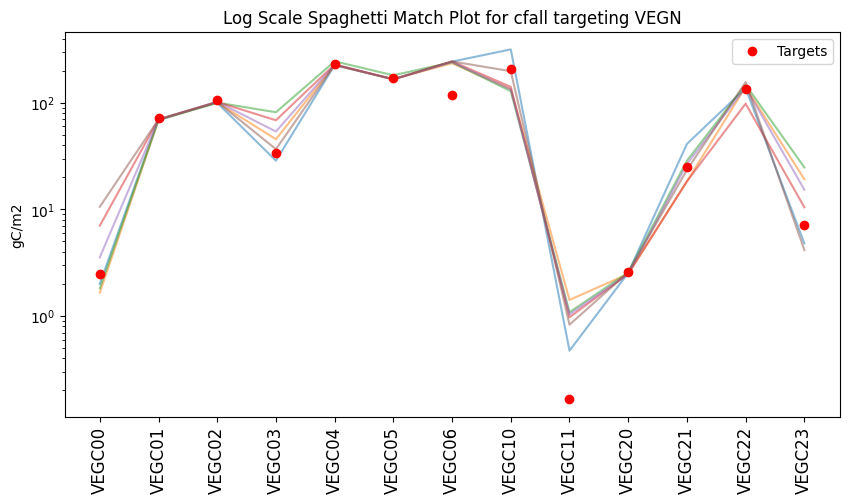

In [17]:
ut.spaghetti_match_plot(xparams.iloc[:,7:20], best_model.iloc[:,7:20])
plt.ylabel(units_VEGC)
plt.title(title_5)
ut.spaghetti_match_plot(xparams.iloc[:,7:20], best_model.iloc[:,7:20], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_6)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for cfall targeting VEGN')

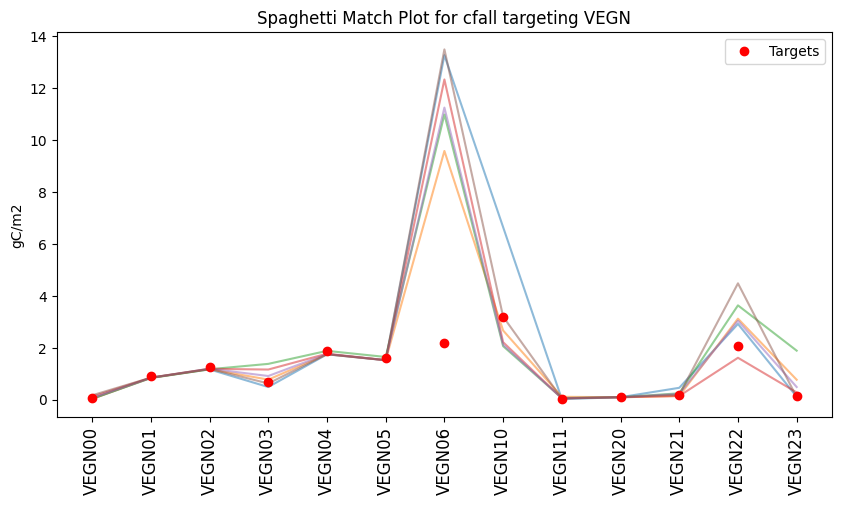

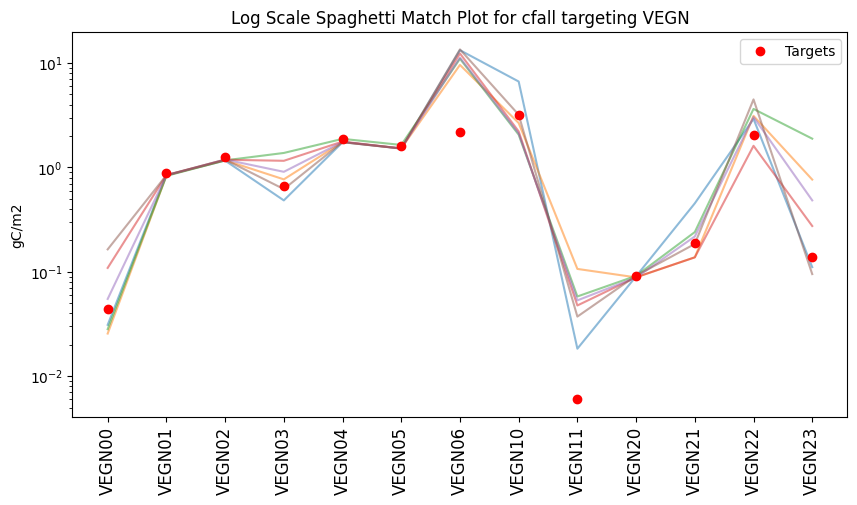

In [18]:
ut.spaghetti_match_plot(xparams.iloc[:,20:], best_model.iloc[:,20:])
plt.ylabel(units_VEGC)
plt.title(title_5)
ut.spaghetti_match_plot(xparams.iloc[:,20:], best_model.iloc[:,20:], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_6)

In [19]:
#print bounds of param from best scores
x_max = xparams.max()
x_min = xparams.min()

# Create a list of pairs [x_min, x_max] where x_min and x_max correspond to the same index in xparams
result = [[x_min[i], x_max[i]] for i in range(len(x_max))]

for pair in result:
    print("Uniform({:.5f}, {:.5f})".format(pair[0], pair[1]))

Uniform(0.14072, 0.46084)
Uniform(0.10815, 0.25040)
Uniform(0.01341, 0.02123)
Uniform(0.02172, 0.14596)
Uniform(0.00664, 0.03640)
Uniform(0.00363, 0.01817)
Uniform(0.01396, 0.21982)
Uniform(0.00000, 0.00001)
Uniform(0.00000, 0.00001)
Uniform(0.00001, 0.00002)
Uniform(0.00000, 0.00001)
Uniform(0.00212, 0.00673)
Uniform(0.00000, 0.00002)
Uniform(0.80247, 0.86486)
Uniform(688.04588, 1058.97592)
Uniform(0.31056, 0.39688)


## adjusted IG

In [25]:
params='sa_cfall-IG_EML21_090_AK/sample_matrix.csv'
model='sa_cfall-IG_EML21_090_AK/results.txt'
df_param = pd.read_csv(path_SA+params)
df_model = pd.read_csv(path_SA+model,header=None)

output_name = ['NPP0','NPP1','NPP2','NPP3','NPP4','NPP5','NPP6',\
               'VEGC00','VEGC01','VEGC02','VEGC03','VEGC04','VEGC05','VEGC06',\
                'VEGC10','VEGC11',\
                'VEGC20','VEGC21','VEGC22','VEGC23',\
                'VEGN00','VEGN01','VEGN02','VEGN03','VEGN04','VEGN05','VEGN06',\
                'VEGN10','VEGN11',\
                'VEGN20','VEGN21','VEGN22','VEGN23']
df_model.columns = output_name
units_NPP = 'gC/m2/year'
units_VEGC = 'gC/m2'
title_1='One to One Match Plot for cfall targeting NPP'
title_2='Spaghetti Match Plot for cfall targeting NPP'
title_3='Log Scale Spaghetti Match Plot for cfall targeting NPP'

title_4='One to One Match Plot for cfall targeting VEGC'
title_5='Spaghetti Match Plot for cfall targeting VEGC'
title_6='Log Scale Spaghetti Match Plot for cfall targeting VEGC'

title_7='One to One Match Plot for cfall targeting VEGN'
title_8='Spaghetti Match Plot for cfall targeting VEGN'
title_9='Log Scale Spaghetti Match Plot for cfall targeting VEGN'

In [10]:
!cat ../../dvm-dos-tem/mads_calibration/SA/EML/sa_cfall-IG_EML21_090_AK/param_props.csv

name,bounds,initial,cmtnum,pftnum
cfall(0),"[0.014999999999999986, 0.28500000000000003]",0.15,21,0
cfall(0),"[0.002999999999999999, 0.056999999999999995]",0.03,21,1
cfall(0),"[0.002999999999999999, 0.056999999999999995]",0.03,21,2
cfall(0),"[0.0019999999999999983, 0.038000000000000006]",0.02,21,3
cfall(0),"[0.0009999999999999992, 0.019000000000000003]",0.01,21,4
cfall(0),"[0.013899999999999996, 0.2641]",0.139,21,5
cfall(0),"[5.000000000000003e-07, 9.5e-06]",5e-06,21,6
cfall(1),"[4e-07, 7.6e-06]",4e-06,21,0
cfall(1),"[1.0000000000000006e-06, 1.9e-05]",1e-05,21,1
cfall(2),"[1.0000000000000006e-06, 1.9e-05]",1e-05,21,0
cfall(2),"[0.001899999999999999, 0.0361]",0.019,21,1
cfall(2),"[1.0000000000000006e-06, 1.9e-05]",1e-05,21,2
cfall(2),"[1.0000000000000006e-06, 1.9e-05]",1e-05,21,3


Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for cfall targeting NPP')

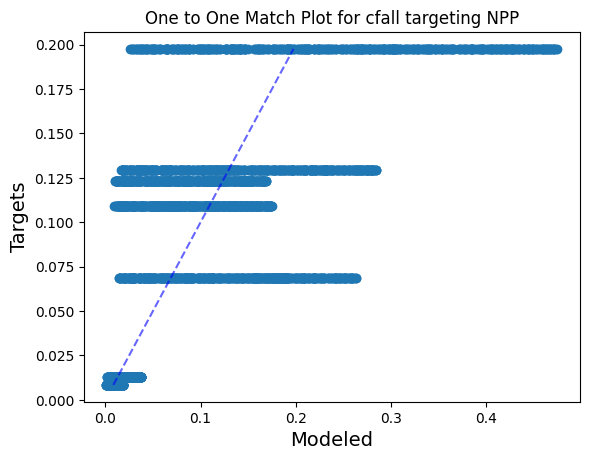

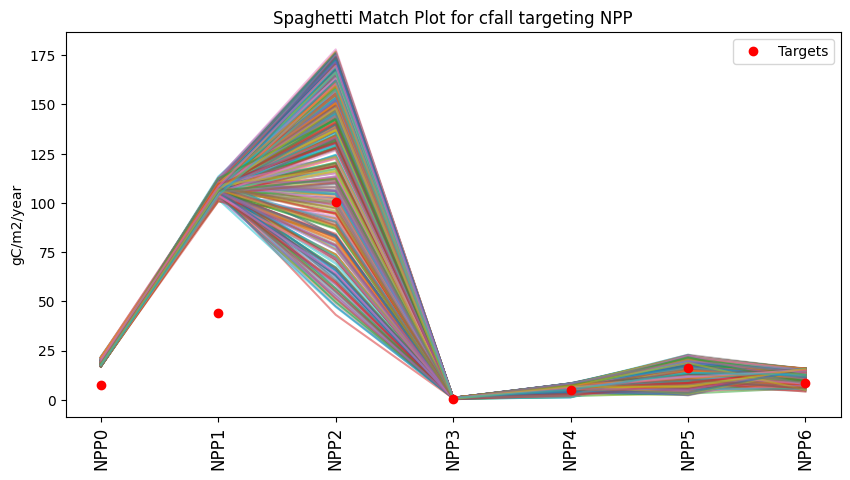

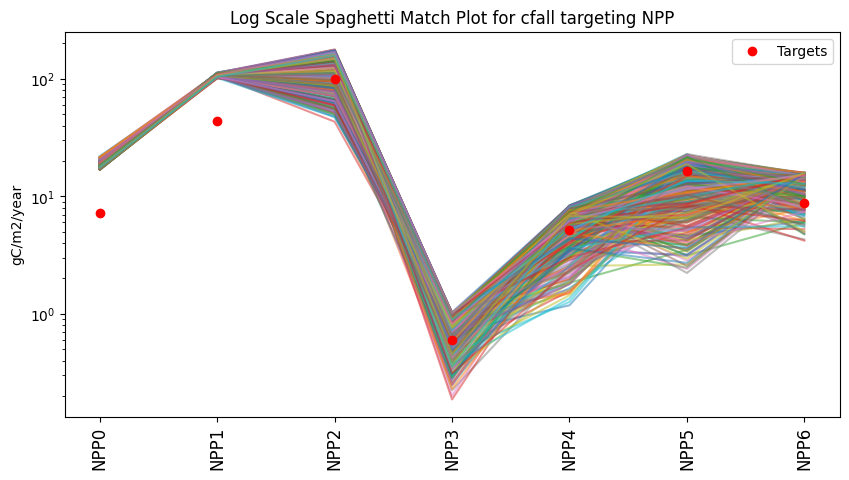

In [9]:
ut.one_to_one_match_plot(df_param.iloc[:,0:7])
plt.title(title_1)
ut.spaghetti_match_plot(df_param.iloc[:,0:7], df_model.iloc[:,0:7])
plt.ylabel(units_NPP)
plt.title(title_2)
ut.spaghetti_match_plot(df_param.iloc[:,0:7], df_model.iloc[:,0:7], logy=True)
plt.ylabel(units_NPP)
plt.title(title_3)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for cfall targeting VEGN')

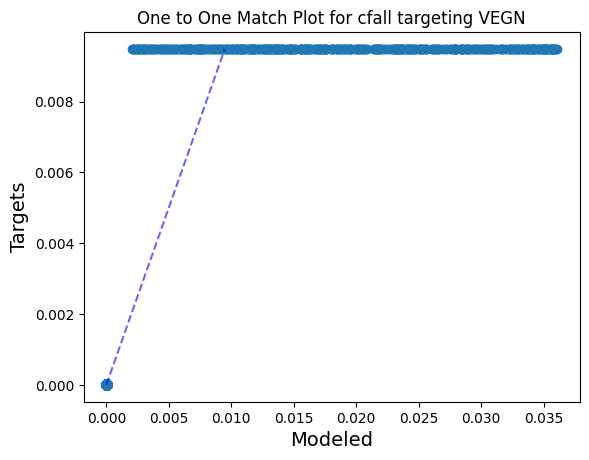

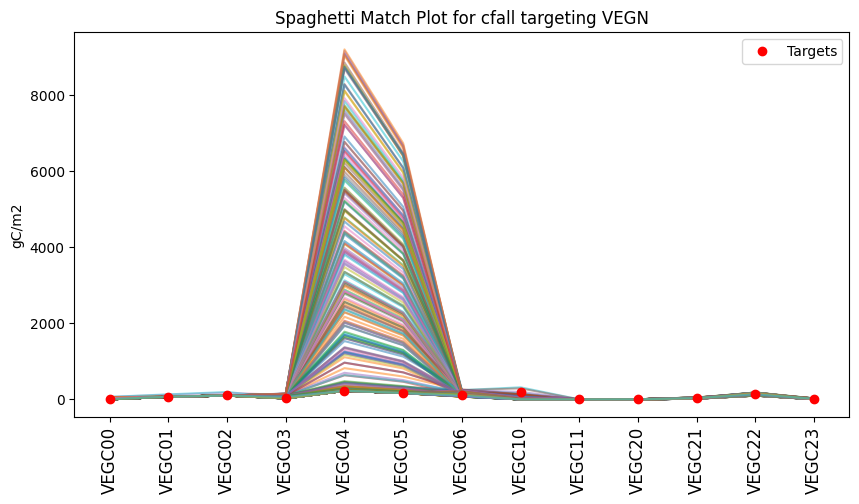

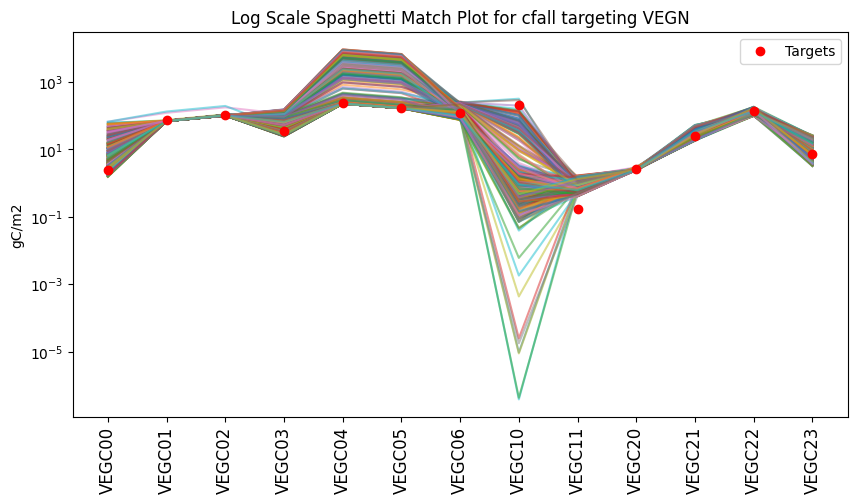

In [11]:
ut.one_to_one_match_plot(df_param.iloc[:,7:20])
plt.title(title_4)
ut.spaghetti_match_plot(df_param.iloc[:,7:20], df_model.iloc[:,7:20])
plt.ylabel(units_VEGC)
plt.title(title_5)
ut.spaghetti_match_plot(df_param.iloc[:,7:20], df_model.iloc[:,7:20], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_6)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for cfall targeting VEGN')

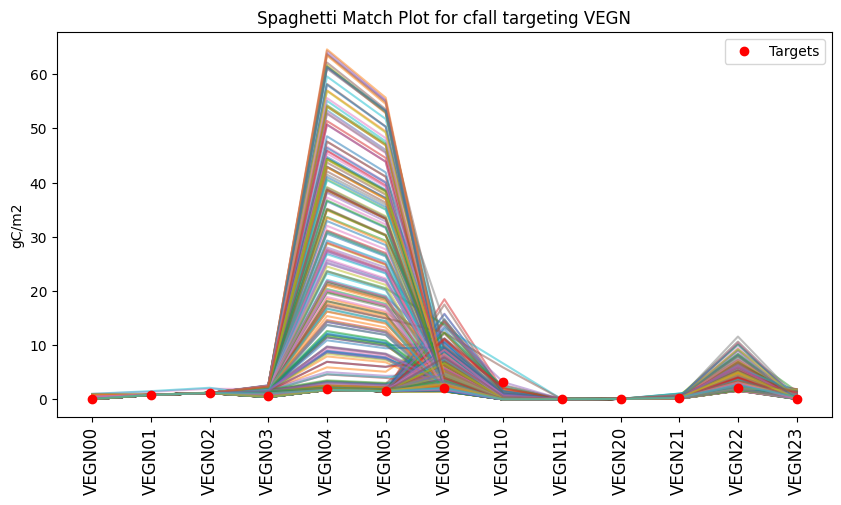

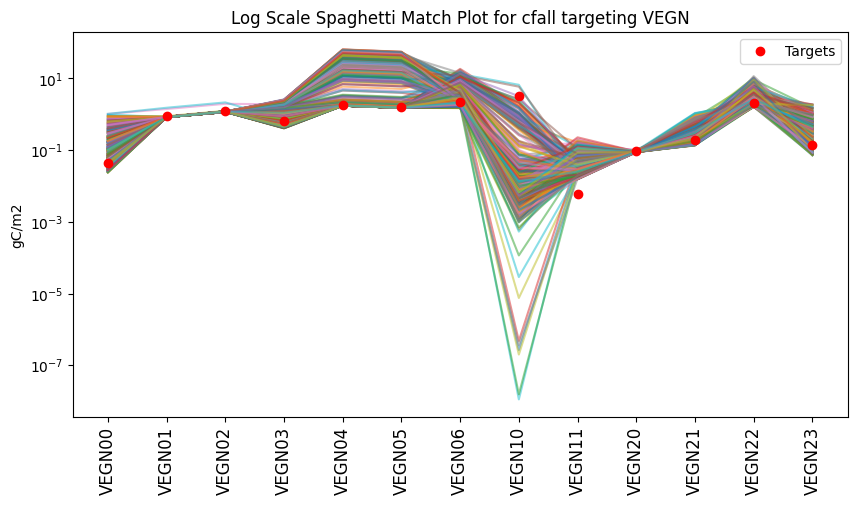

In [12]:
ut.spaghetti_match_plot(df_param, df_model.iloc[:,20:])
plt.ylabel(units_VEGC)
plt.title(title_5)
ut.spaghetti_match_plot(df_param, df_model.iloc[:,20:], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_6)

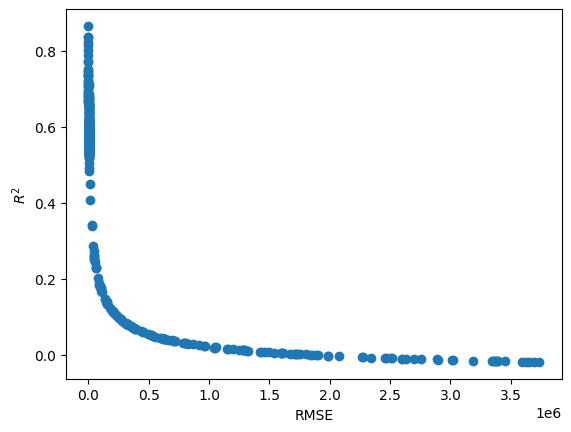

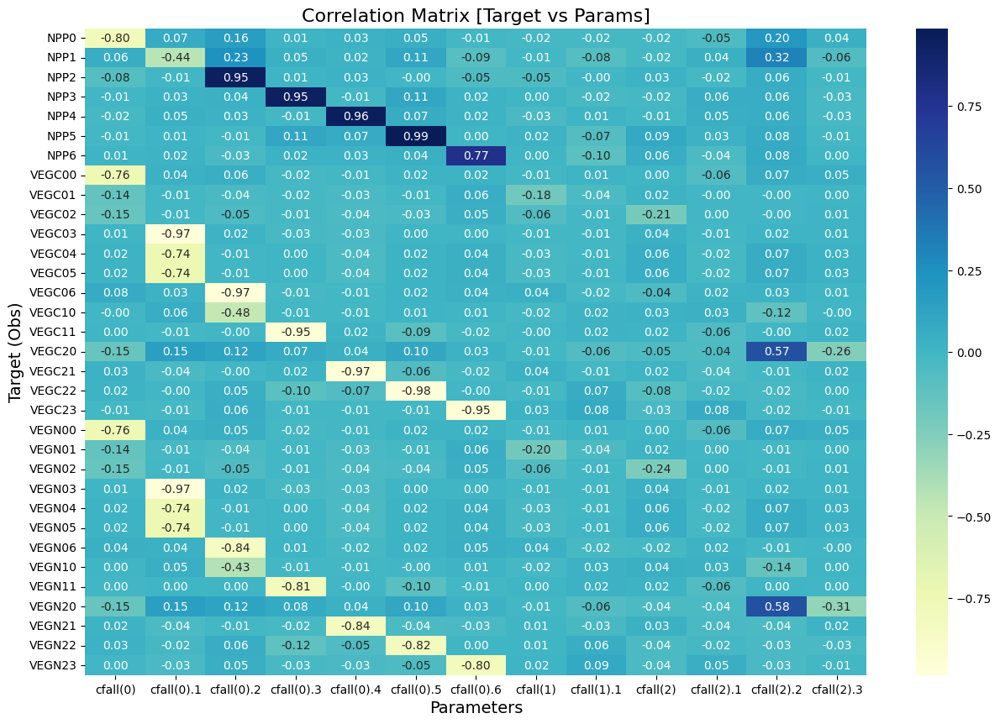

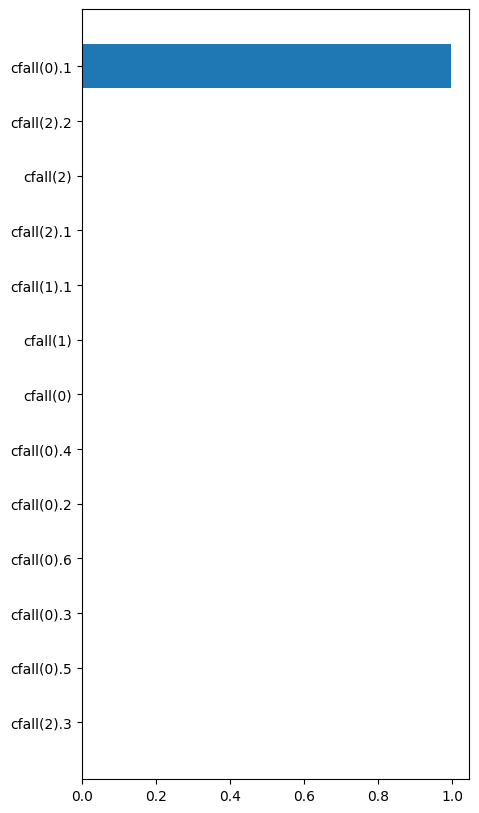

In [13]:
rmse=ut.plot_r2_rmse(df_model)
corr_mp=ut.get_output_param_corr(df_param,df_model)
e_rmse=ut.find_important_features_err(df_param,df_model,error='rmse')

### best error

In [16]:
xparams, ymodel =  ut.get_params_r2_rmse(df_param,df_model,r2lim=0.75)
len(xparams)

10

In [19]:
best=xparams[xparams.MAPE<1]
best_model=ymodel[xparams.MAPE<1]
len(best)
best_model = pd.concat([best_model, df_model.iloc[-1:]], ignore_index=True)

In [29]:
xparams.describe()

,cfall(0),cfall(0).1,cfall(0).2,cfall(0).3,cfall(0).4,cfall(0).5,cfall(0).6,cfall(1),cfall(1).1,cfall(2),cfall(2).1,cfall(2).2,cfall(2).3,$R^2$,RMSE,MAPE
count,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,1.000000e+01,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000
mean,0.284373,0.177383,0.014906,0.064836,0.019277,0.009427,0.119775,3.873378e-06,0.000004,0.000013,0.000003,0.006627,0.000009,0.805908,927.552241,0.351523
std,0.146076,0.047074,0.003433,0.034154,0.011055,0.004469,0.084213,2.612159e-06,0.000002,0.000004,0.000001,0.003301,0.000006,0.035324,166.605228,0.031617
min,0.025704,0.108155,0.009642,0.021717,0.004143,0.003630,0.013957,8.879010e-07,0.000002,0.000006,0.000001,0.002118,0.000001,0.751542,688.045881,0.308864
25%,0.180582,0.136121,0.012726,0.048786,0.011699,0.006409,0.057989,1.802363e-06,0.000003,0.000009,0.000002,0.005685,0.000004,0.776991,815.298332,0.334694
50%,0.300088,0.182405,0.014432,0.054133,0.018393,0.008853,0.090238,3.116198e-06,0.000004,0.000013,0.000003,0.006249,0.000007,0.808718,897.417309,0.348268
75%,0.412278,0.206412,0.017096,0.069622,0.023797,0.012269,0.196366,5.677850e-06,0.000006,0.000016,0.000003,0.007511,0.000013,0.831631,1047.792739,0.369450
max,0.460842,0.250398,0.021232,0.145955,0.036403,0.018165,0.244048,8.735014e-06,0.000006,0.000019,0.000005,0.013564,0.000018,0.864859,1184.467472,0.399972


In [23]:
best

,cfall(0),cfall(0).1,cfall(0).2,cfall(0).3,cfall(0).4,cfall(0).5,cfall(0).6,cfall(1),cfall(1).1,cfall(2),cfall(2).1,cfall(2).2,cfall(2).3,$R^2$,RMSE,MAPE
13,0.290902,0.197942,0.011557,0.094003,0.010154,0.012613,0.057526,6.718440e-06,0.000003,0.000018,0.000001,0.013564,0.000003,0.787100,893.324079,0.332745
63,0.175839,0.231770,0.009642,0.064427,0.016334,0.010673,0.244048,3.617114e-06,0.000003,0.000014,0.000003,0.009581,0.000009,0.751542,1132.155458,0.374333
71,0.384935,0.129808,0.012500,0.053693,0.021499,0.012403,0.078423,1.754205e-06,0.000006,0.000019,0.000003,0.007771,0.000006,0.770465,1014.243188,0.308864
89,0.421392,0.250398,0.013585,0.145955,0.006639,0.007032,0.199926,1.946839e-06,0.000006,0.000016,0.000003,0.002118,0.000006,0.836644,1058.975923,0.340541
179,0.025704,0.186828,0.017092,0.051860,0.004143,0.011868,0.185685,1.530389e-06,0.000003,0.000009,0.000002,0.006039,0.000009,0.773621,1184.467472,0.399972
235,0.460842,0.177982,0.021232,0.021717,0.036251,0.006351,0.036935,5.891401e-06,0.000005,0.000013,0.000002,0.002417,0.000018,0.834556,733.406441,0.354117
363,0.439311,0.108155,0.017668,0.043022,0.017073,0.004953,0.013957,8.735014e-06,0.000006,0.000014,0.000001,0.006016,0.000002,0.814971,901.510540,0.396883
372,0.194813,0.126649,0.015278,0.054572,0.036403,0.018165,0.102052,8.879010e-07,0.000002,0.000008,0.000005,0.006729,0.000015,0.802465,873.493482,0.354801
423,0.309275,0.155062,0.017097,0.047761,0.019712,0.006584,0.059377,5.037196e-06,0.000003,0.000006,0.000003,0.006458,0.000018,0.822857,795.899948,0.310556
444,0.140719,0.209235,0.013405,0.071353,0.024563,0.003630,0.219815,2.615282e-06,0.000005,0.000008,0.000004,0.005575,0.000001,0.864859,688.045881,0.342419


Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for cfall targeting VEGC')

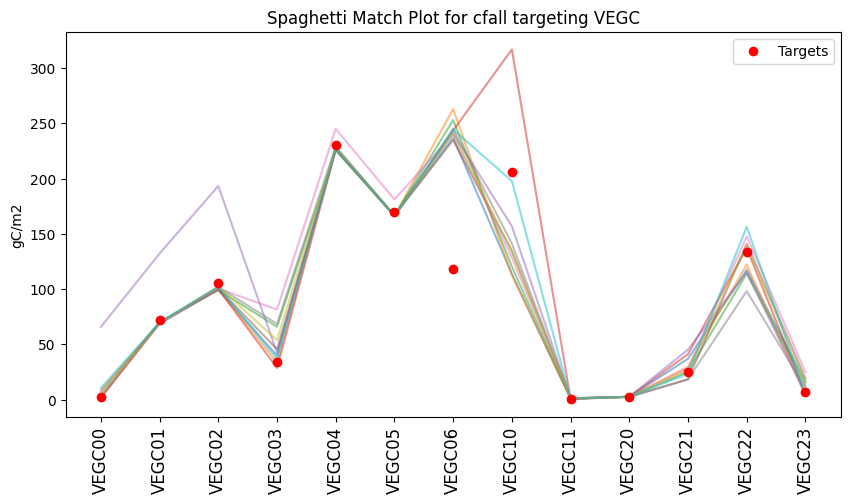

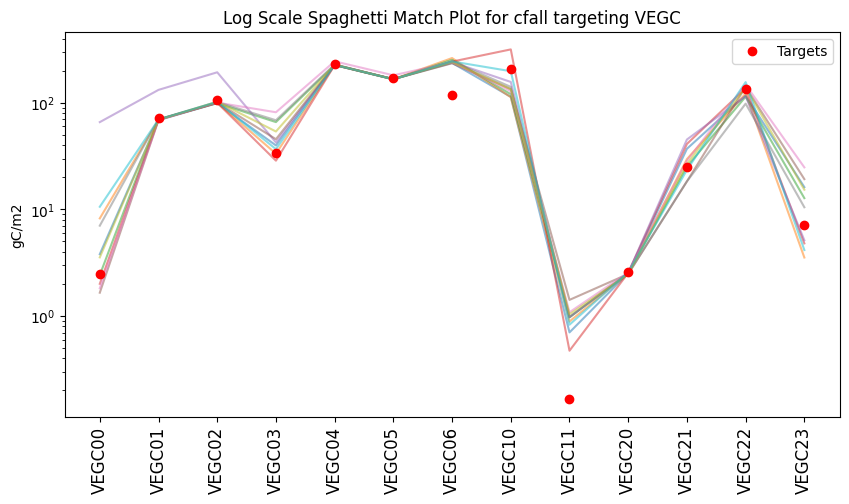

In [27]:
ut.spaghetti_match_plot(best.iloc[:,7:20], best_model.iloc[:,7:20])
plt.ylabel(units_VEGC)
plt.title(title_5)
ut.spaghetti_match_plot(best.iloc[:,7:20], best_model.iloc[:,7:20], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_6)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for cfall targeting VEGN')

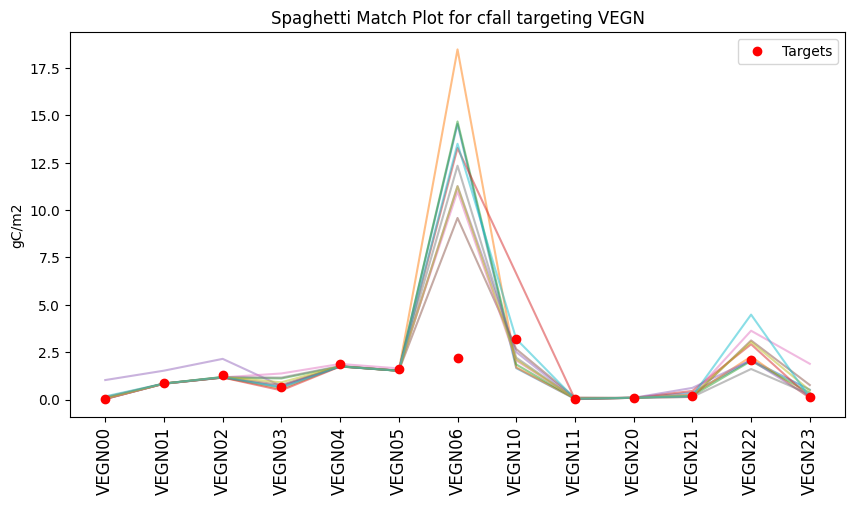

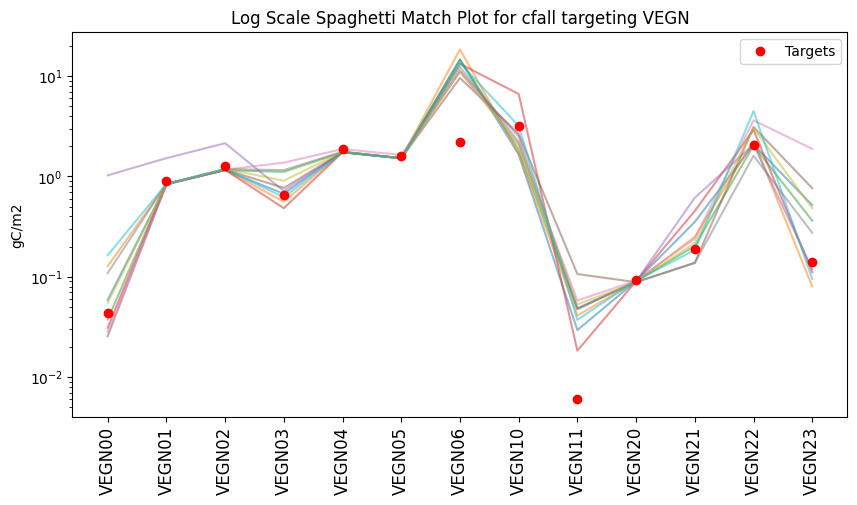

In [26]:
ut.spaghetti_match_plot(best, best_model.iloc[:,20:])
plt.ylabel(units_VEGC)
plt.title(title_8)
ut.spaghetti_match_plot(best, best_model.iloc[:,20:], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_9)

# nmax+krb+cfall -> NPP+VEGC+VEGN

In [3]:
params='sample_matrix_STEP3-MD21-EML.csv'
model='results_STEP3-MD21-EML.txt'
df_param = pd.read_csv(path_SA+params)
df_model = pd.read_csv(path_SA+model,header=None)

output_name = ['NPP0','NPP1','NPP2','NPP3','NPP4','NPP5','NPP6',\
               'VEGC00','VEGC01','VEGC02','VEGC03','VEGC04','VEGC05','VEGC06',\
                'VEGC10','VEGC11',\
                'VEGC20','VEGC21','VEGC22','VEGC23',\
                'VEGN00','VEGN01','VEGN02','VEGN03','VEGN04','VEGN05','VEGN06',\
                'VEGN10','VEGN11',\
                'VEGN20','VEGN21','VEGN22','VEGN23']
df_model.columns = output_name
units_NPP = 'gC/m2/year'
units_VEGC = 'gC/m2'
title_1='One to One Match Plot for Nmax targeting NPP'
title_2='Spaghetti Match Plot for Nmax targeting NPP'
title_3='Log Scale Spaghetti Match Plot for Nmax targeting NPP'

title_4='One to One Match Plot for krb targeting VEGC'
title_5='Spaghetti Match Plot for krb targeting VEGC'
title_6='Log Scale Spaghetti Match Plot for krb targeting VEGC'

title_7='One to One Match Plot for krb/cfall/nfall targeting VEGN'
title_8='Spaghetti Match Plot for krb/cfall/nfall targeting VEGN'
title_9='Log Scale Spaghetti Match Plot for krb/cfall/nfall targeting VEGN'

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for Nmax targeting NPP')

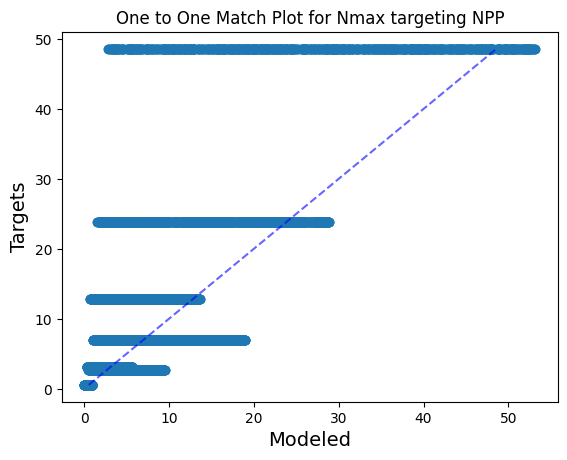

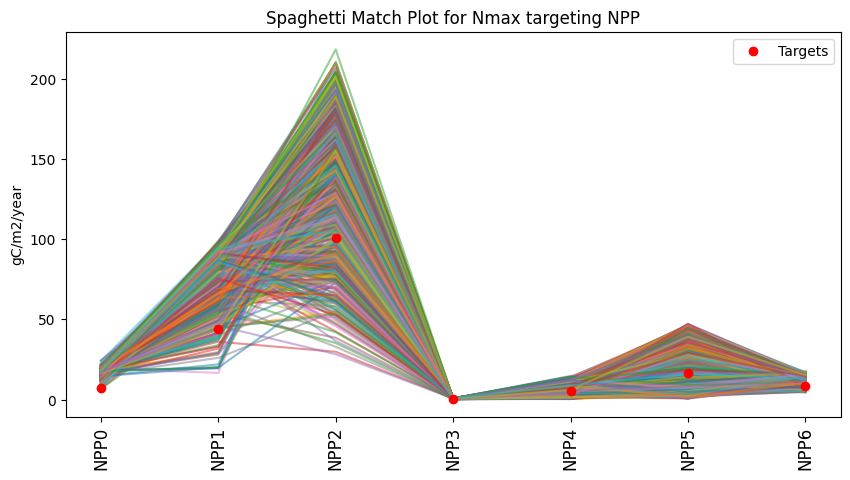

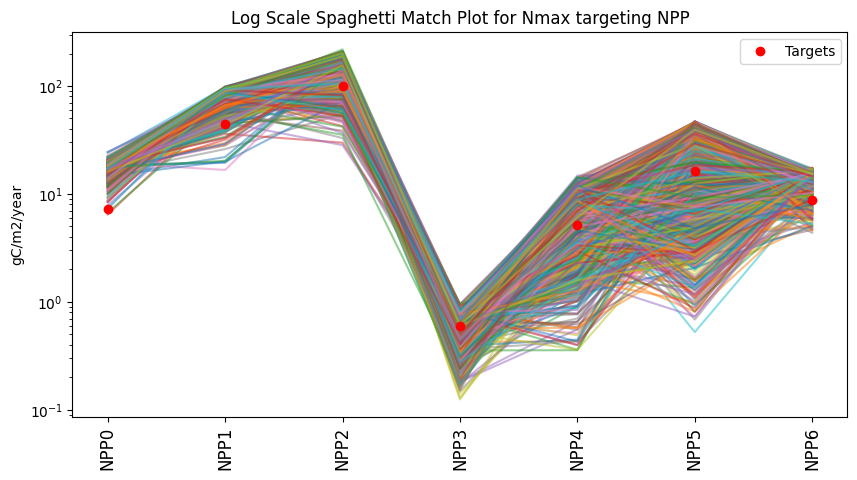

In [37]:
ut.one_to_one_match_plot(df_param.iloc[:,0:7])
plt.title(title_1)
ut.spaghetti_match_plot(df_param.iloc[:,0:7], df_model.iloc[:,0:7])
plt.ylabel(units_NPP)
plt.title(title_2)
ut.spaghetti_match_plot(df_param.iloc[:,0:7], df_model.iloc[:,0:7], logy=True)
plt.ylabel(units_NPP)
plt.title(title_3)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for krb targeting VEGC')

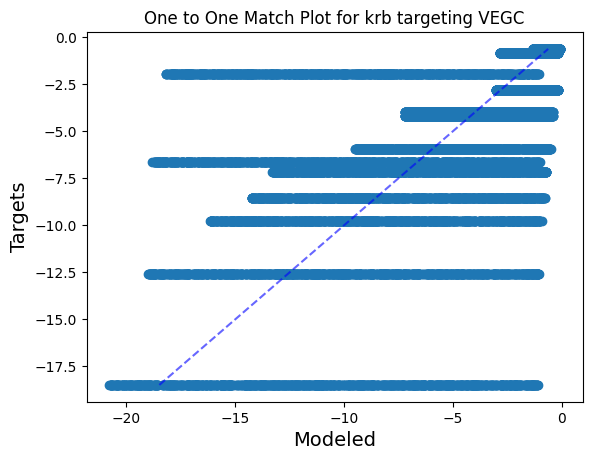

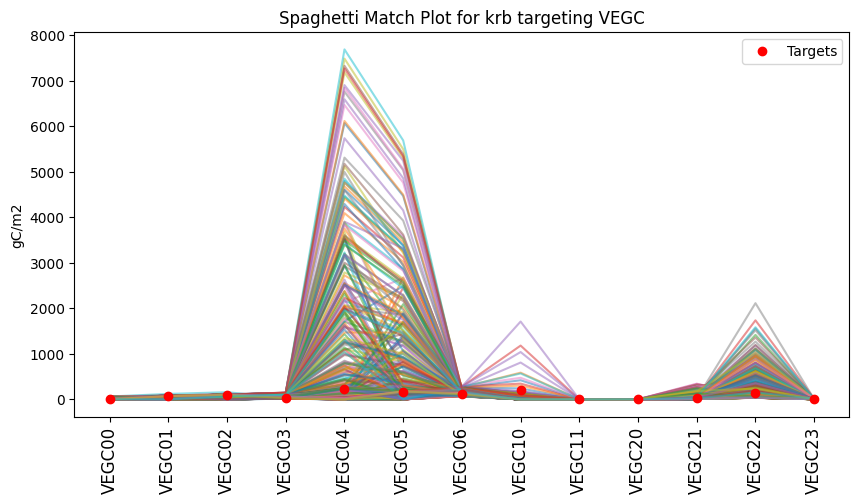

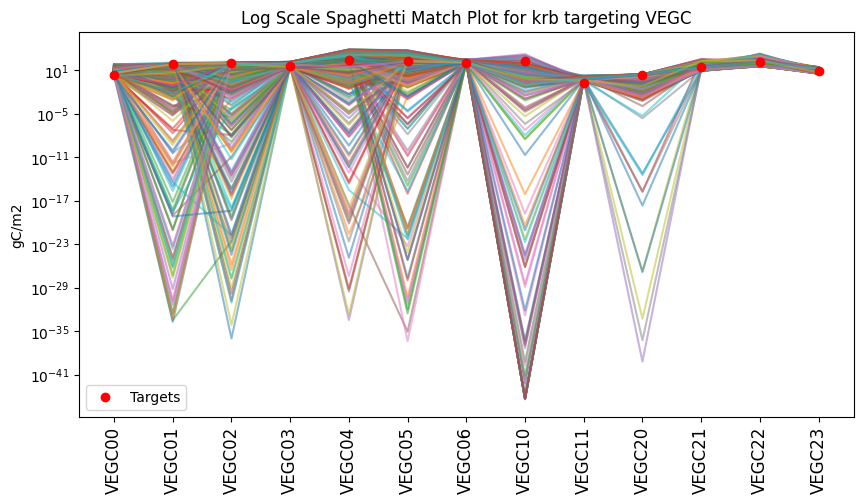

In [39]:
ut.one_to_one_match_plot(df_param.iloc[:,7:20])
plt.title(title_4)
ut.spaghetti_match_plot(df_param.iloc[:,7:20], df_model.iloc[:,7:20])
plt.ylabel(units_VEGC)
plt.title(title_5)
ut.spaghetti_match_plot(df_param.iloc[:,7:20], df_model.iloc[:,7:20], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_6)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for krb targeting VEGC')

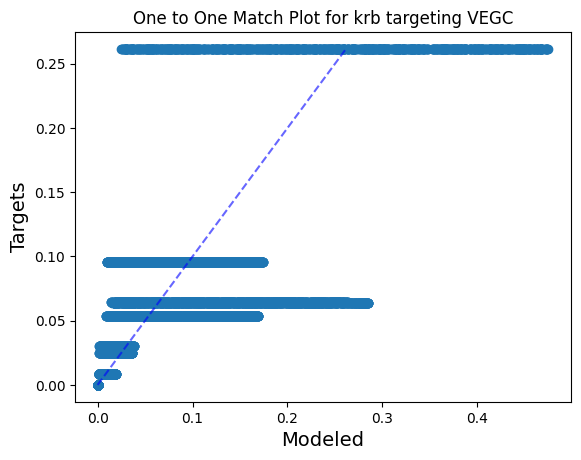

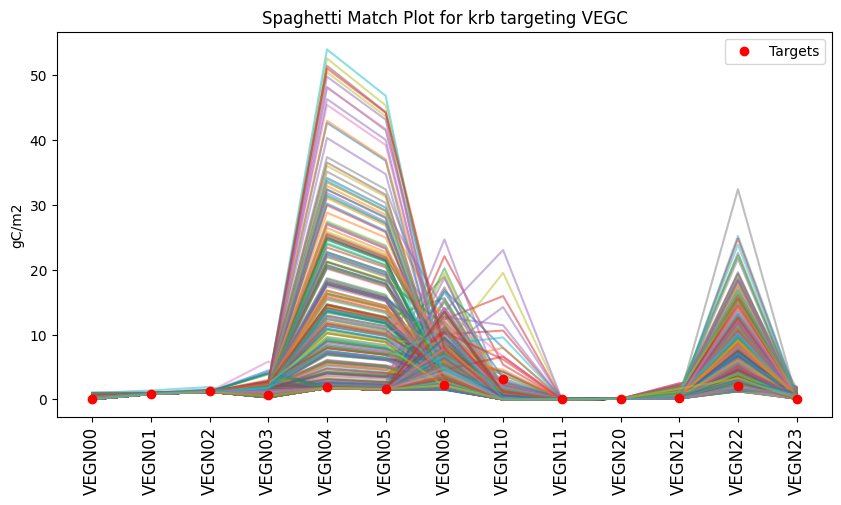

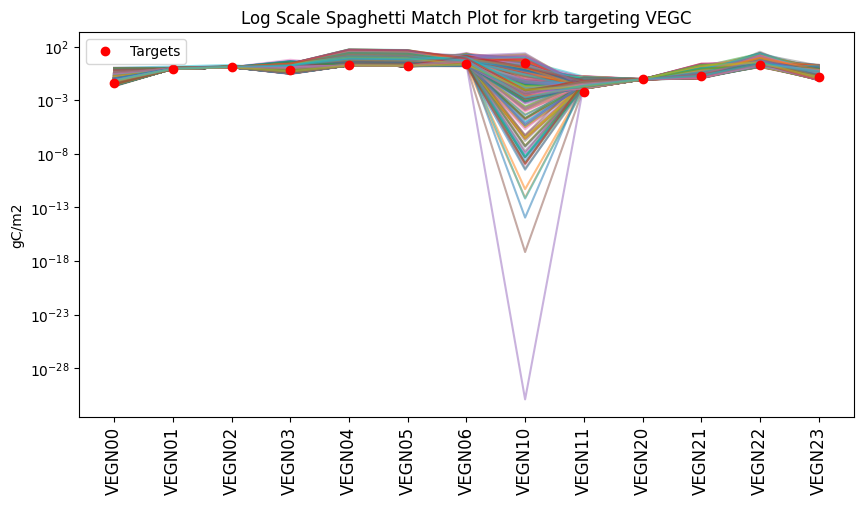

In [40]:
ut.one_to_one_match_plot(df_param.iloc[:,20:])
plt.title(title_4)
ut.spaghetti_match_plot(df_param.iloc[:,20:], df_model.iloc[:,20:])
plt.ylabel(units_VEGC)
plt.title(title_5)
ut.spaghetti_match_plot(df_param.iloc[:,20:], df_model.iloc[:,20:], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_6)

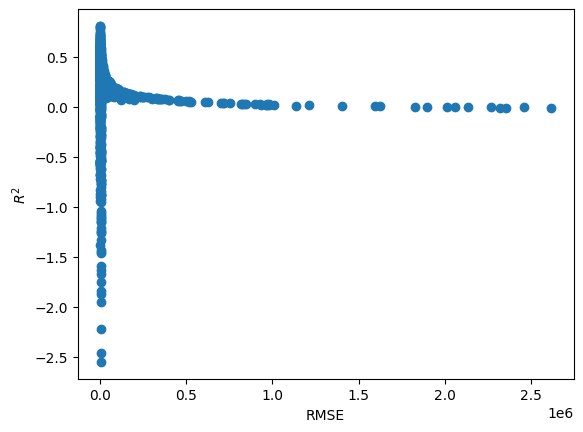

In [44]:
rmse=ut.plot_r2_rmse(df_model)

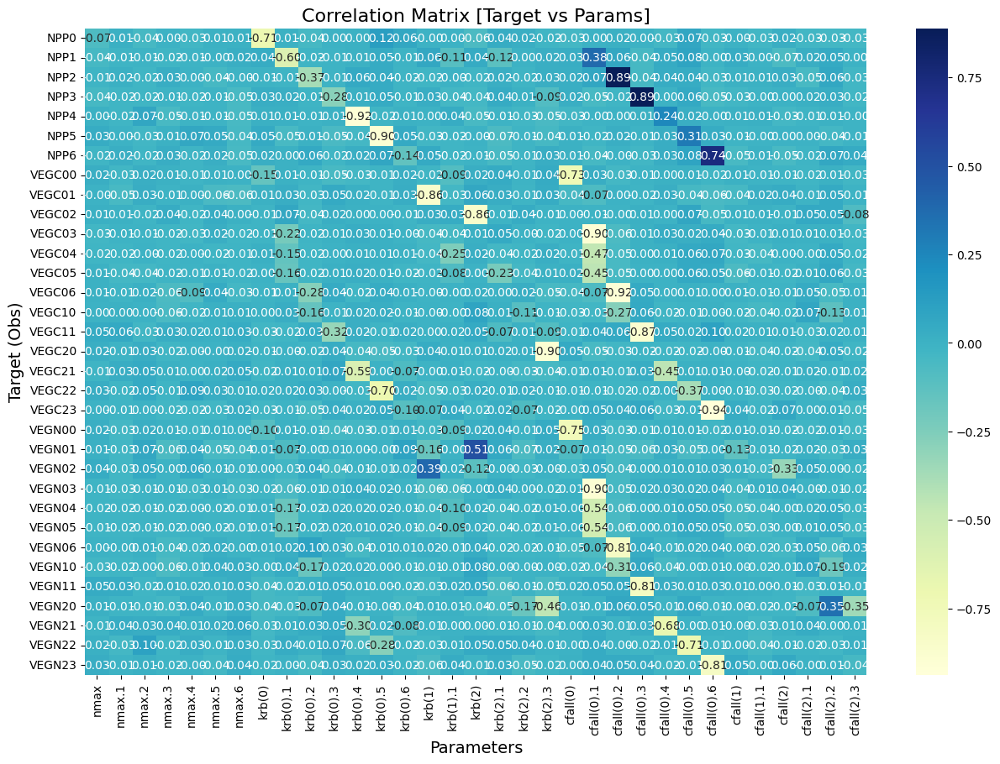

In [45]:
corr_mp=ut.get_output_param_corr(df_param,df_model)

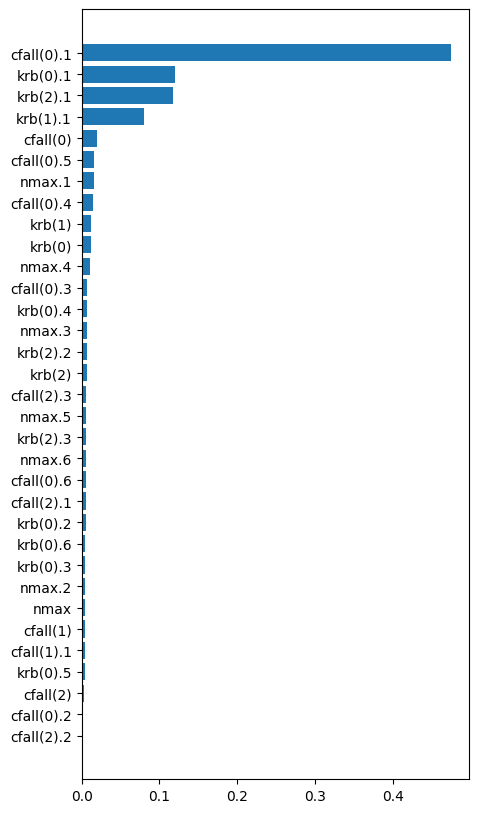

In [46]:
e_rmse=ut.find_important_features_err(df_param,df_model,error='rmse')

/home/akabeer/post_processing_git/MADS-TEM-calibration/utils.py:856: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,5))


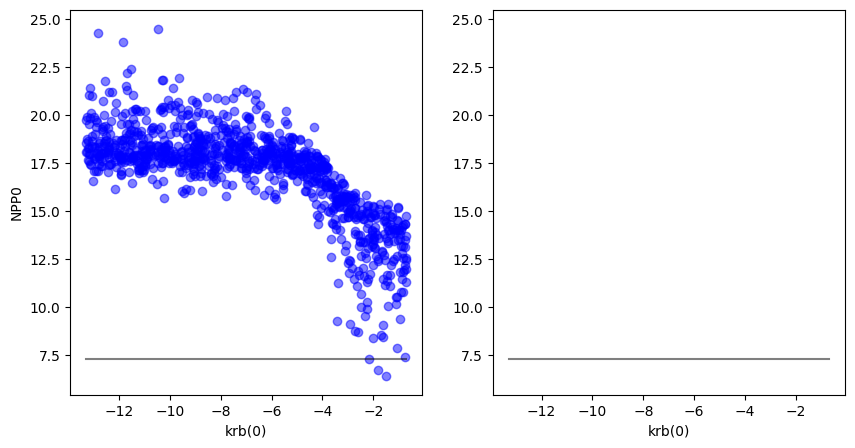

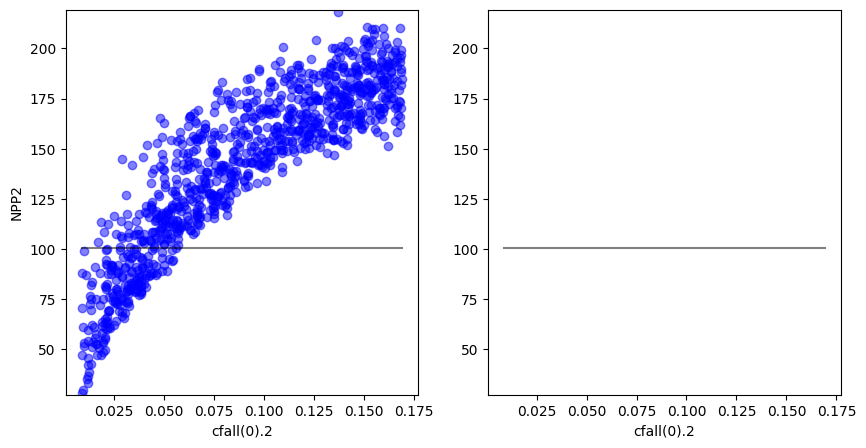

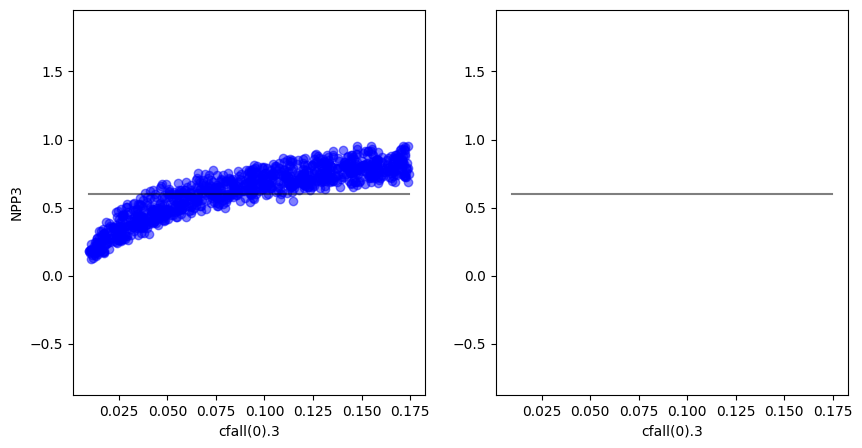

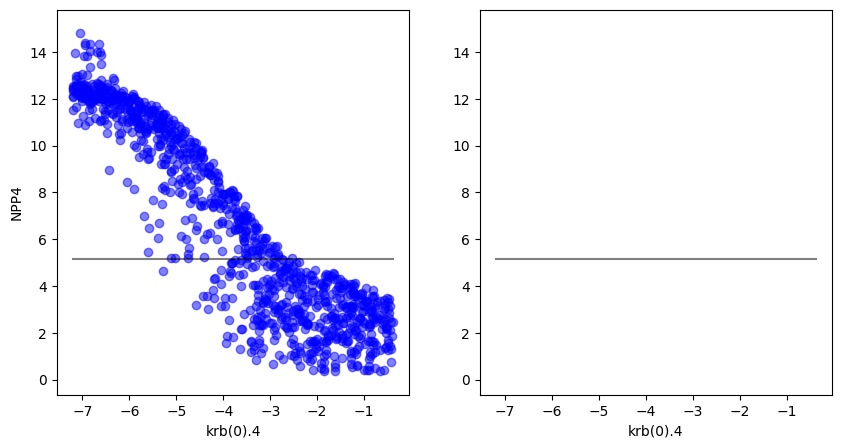

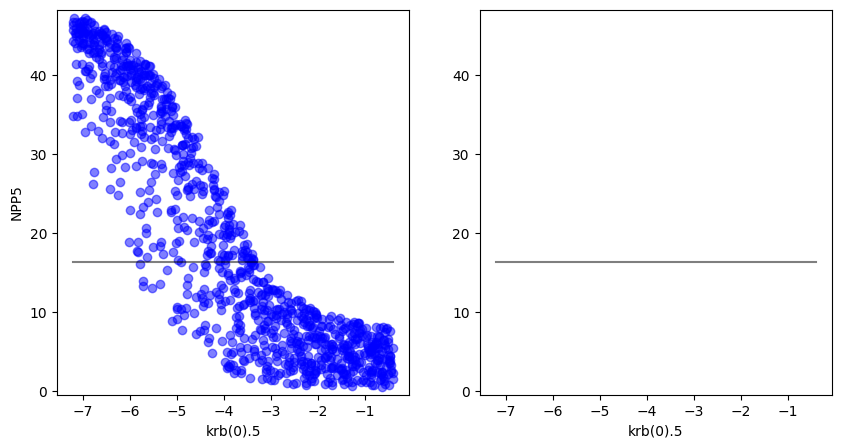

...

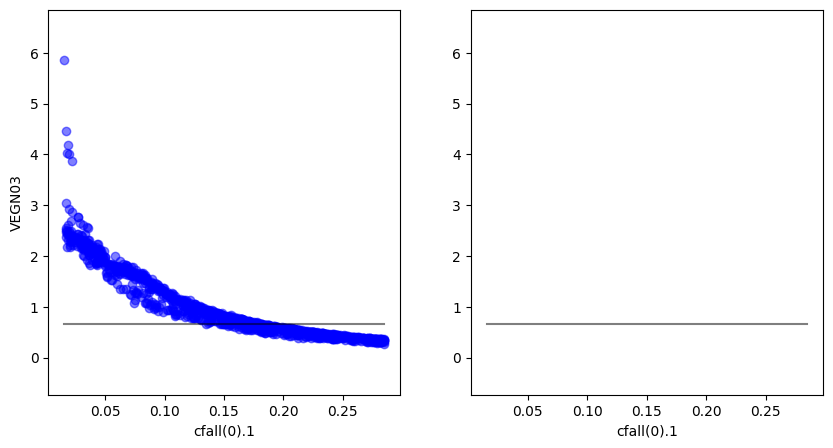

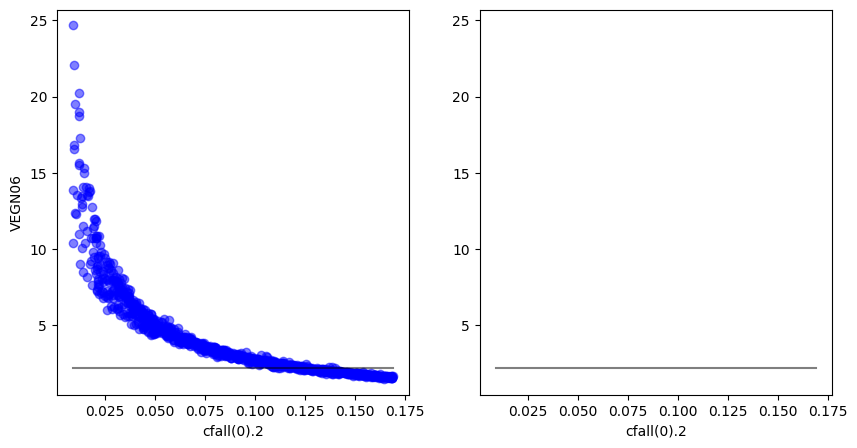

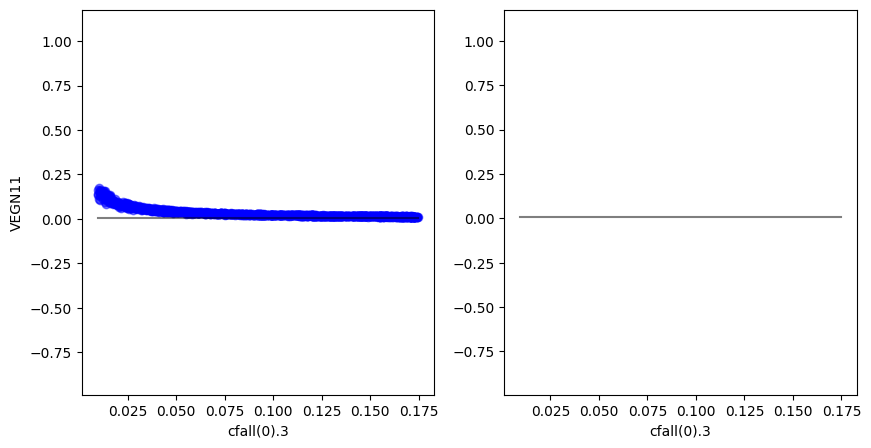

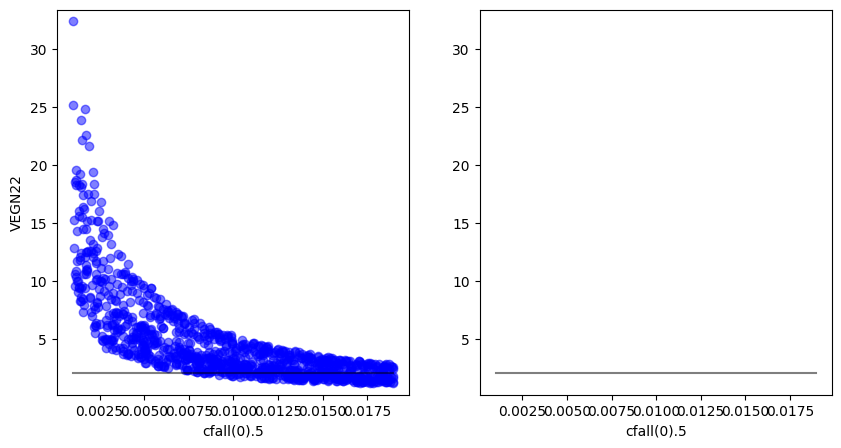

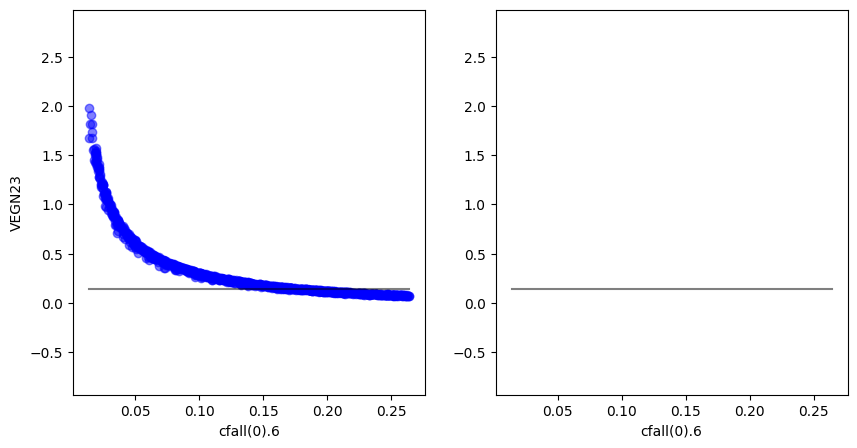

In [47]:
ut.plot_relationships(corr_mp,df_param,df_model,corr_thresh=0.70)

best errors

In [24]:
xparams, ymodel =  ut.get_params_r2_rmse(df_param,df_model,r2lim=0.5)
len(xparams)

206

In [1]:
#limit r2
#xparams - check range

In [25]:
best=xparams[xparams.MAPE<1]
best_model=ymodel[xparams.MAPE<1]
len(best)
best_model = pd.concat([best_model, df_model.iloc[-1:]], ignore_index=True)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for Nmax targeting NPP')

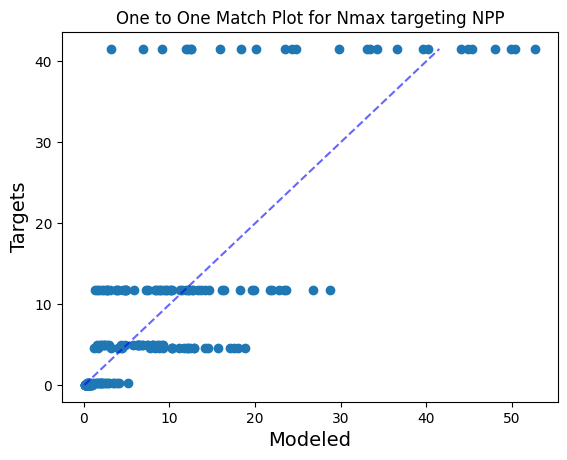

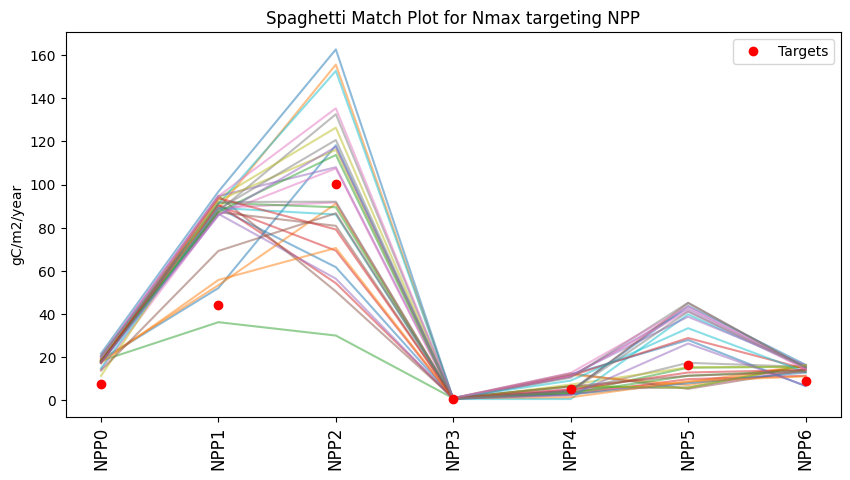

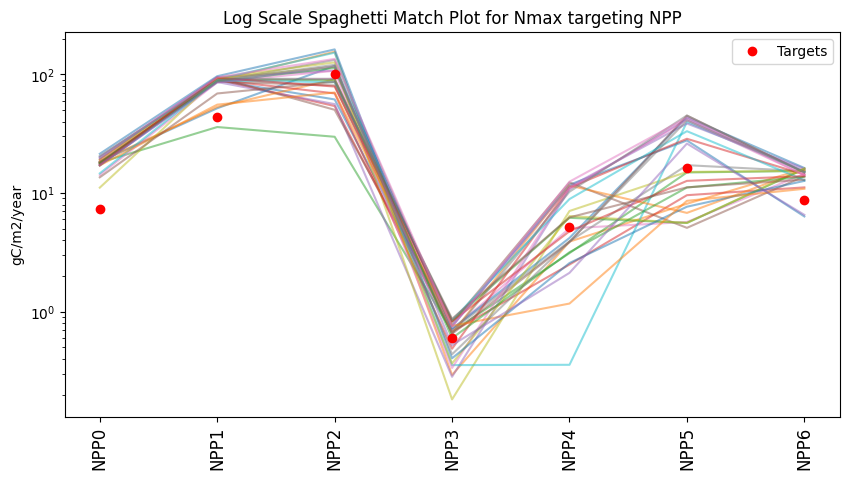

In [26]:
ut.one_to_one_match_plot(best.iloc[:,0:7])
plt.title(title_1)
ut.spaghetti_match_plot(best.iloc[:,0:7], best_model.iloc[:,0:7])
plt.ylabel(units_NPP)
plt.title(title_2)
ut.spaghetti_match_plot(best.iloc[:,0:7], best_model.iloc[:,0:7], logy=True)
plt.ylabel(units_NPP)
plt.title(title_3)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for krb targeting VEGC')

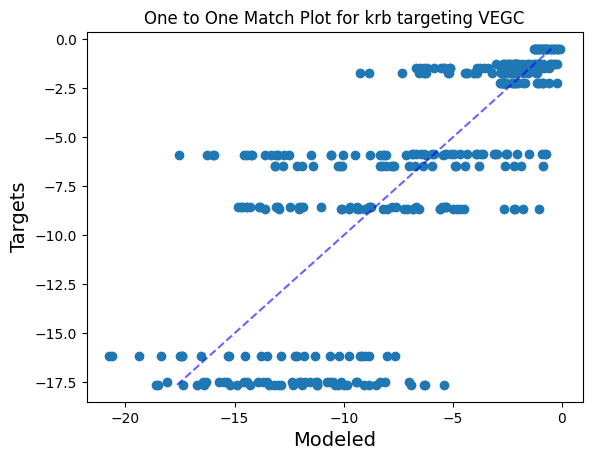

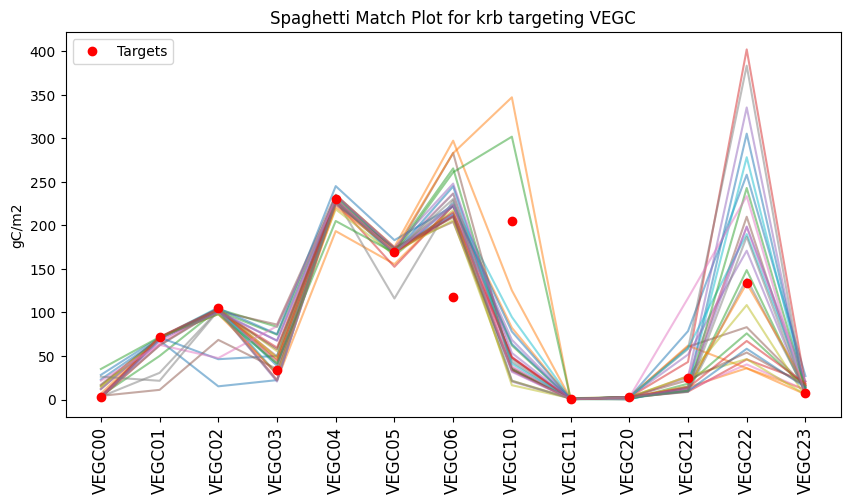

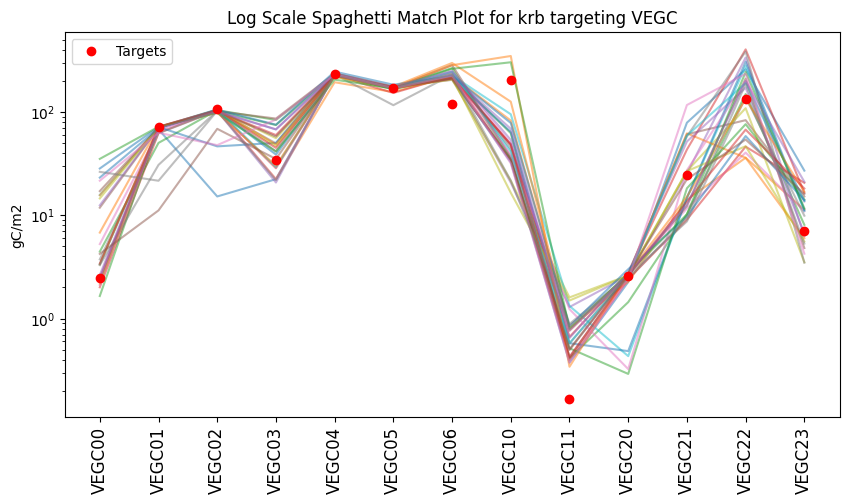

In [27]:
ut.one_to_one_match_plot(best.iloc[:,7:20])
plt.title(title_4)
ut.spaghetti_match_plot(best.iloc[:,7:20], best_model.iloc[:,7:20])
plt.ylabel(units_VEGC)
plt.title(title_5)
ut.spaghetti_match_plot(best.iloc[:,7:20], best_model.iloc[:,7:20], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_6)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for krb targeting VEGC')

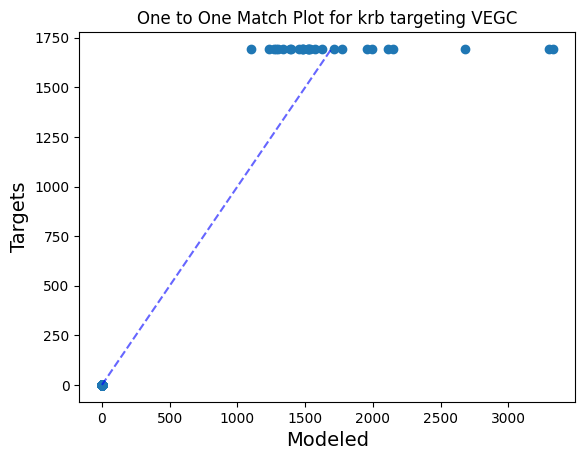

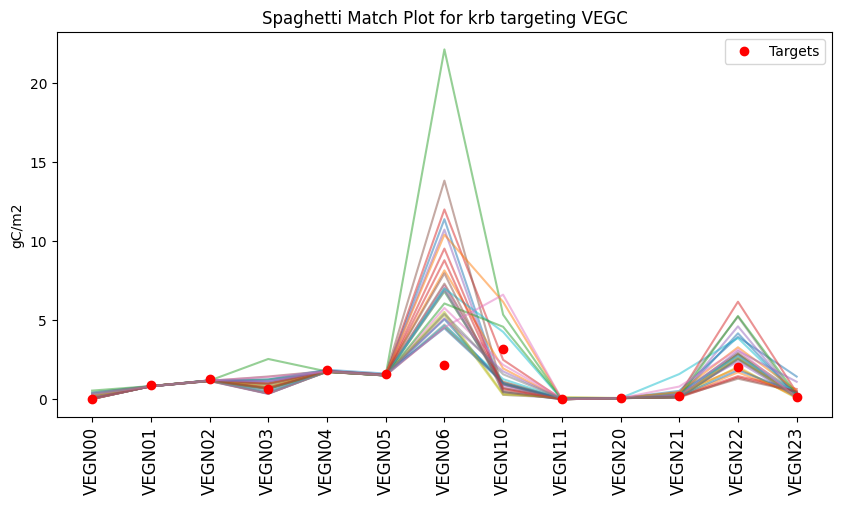

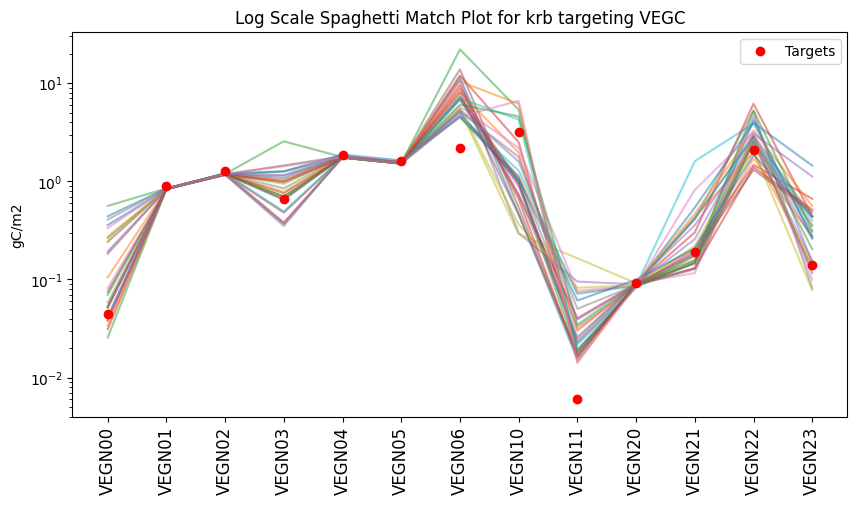

In [28]:
ut.one_to_one_match_plot(best.iloc[:,20:])
plt.title(title_4)
ut.spaghetti_match_plot(best.iloc[:,20:], best_model.iloc[:,20:])
plt.ylabel(units_VEGC)
plt.title(title_5)
ut.spaghetti_match_plot(best.iloc[:,20:], best_model.iloc[:,20:], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_6)

In [9]:
#print bounds of param from best scores
x_max = best.max()
x_min = best.min()

# Create a list of pairs [x_min, x_max] where x_min and x_max correspond to the same index in xparams
result = [[x_min[i], x_max[i]] for i in range(len(x_max))]

for pair in result:
    print("Uniform({:.5f}, {:.5f})".format(pair[0], pair[1]))

Uniform(1.29109, 13.65801)
Uniform(3.20089, 52.73291)
Uniform(2.69742, 28.78484)
Uniform(0.06693, 0.89925)
Uniform(0.32736, 5.10464)
Uniform(1.16498, 18.81761)
Uniform(1.55378, 9.28723)
Uniform(-13.15191, -0.86534)
Uniform(-13.60367, -1.06312)
Uniform(-2.84305, -0.23601)
Uniform(-3.02122, -0.22029)
Uniform(-6.70442, -0.57283)
Uniform(-6.88324, -0.70935)
Uniform(-1.29955, -0.08441)
Uniform(-17.52381, -5.46184)
Uniform(-20.74261, -7.62595)
Uniform(-18.60311, -5.41620)
Uniform(-18.08165, -7.01588)
Uniform(-9.24197, -1.16503)
Uniform(-14.84259, -5.30965)
Uniform(0.04318, 0.46098)
Uniform(0.03572, 0.27547)
Uniform(0.00893, 0.05033)
Uniform(0.00943, 0.15839)
Uniform(0.00202, 0.03655)
Uniform(0.00383, 0.01895)
Uniform(0.01938, 0.25711)
Uniform(0.00000, 0.00001)
Uniform(0.00000, 0.00001)
Uniform(0.00000, 0.00002)
Uniform(0.00000, 0.00001)
Uniform(0.00220, 0.03469)
Uniform(0.00000, 0.00002)
Uniform(0.53968, 0.80734)
Uniform(1096.91206, 3328.08251)
Uniform(0.37322, 0.99273)


# nmax+krb+cfall+nfall -> NPP+VEGC+VEGN

nfall doesn't do much other than improve VEGN20 - focus and most influence from cfall and krb
best ranges do become smaller in most cases, errors overall aren't great

In [4]:
params='sample_matrix_STEP3-MD21-EML.csv'
model='results_STEP3-MD21-EML.txt'
df_param = pd.read_csv(path_SA+params)
df_model = pd.read_csv(path_SA+model,header=None)

output_name = ['NPP0','NPP1','NPP2','NPP3','NPP4','NPP5','NPP6',\
               'VEGC00','VEGC01','VEGC02','VEGC03','VEGC04','VEGC05','VEGC06',\
                'VEGC10','VEGC11',\
                'VEGC20','VEGC21','VEGC22','VEGC23',\
                'VEGN00','VEGN01','VEGN02','VEGN03','VEGN04','VEGN05','VEGN06',\
                'VEGN10','VEGN11',\
                'VEGN20','VEGN21','VEGN22','VEGN23']
df_model.columns = output_name
units_NPP = 'gC/m2/year'
units_VEGC = 'gC/m2'
title_1='One to One Match Plot for Nmax targeting NPP'
title_2='Spaghetti Match Plot for Nmax targeting NPP'
title_3='Log Scale Spaghetti Match Plot for Nmax targeting NPP'

title_4='One to One Match Plot for krb targeting VEGC'
title_5='Spaghetti Match Plot for krb targeting VEGC'
title_6='Log Scale Spaghetti Match Plot for krb targeting VEGC'

title_7='One to One Match Plot for krb/cfall/nfall targeting VEGN'
title_8='Spaghetti Match Plot for krb/cfall/nfall targeting VEGN'
title_9='Log Scale Spaghetti Match Plot for krb/cfall/nfall targeting VEGN'

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for Nmax targeting NPP')

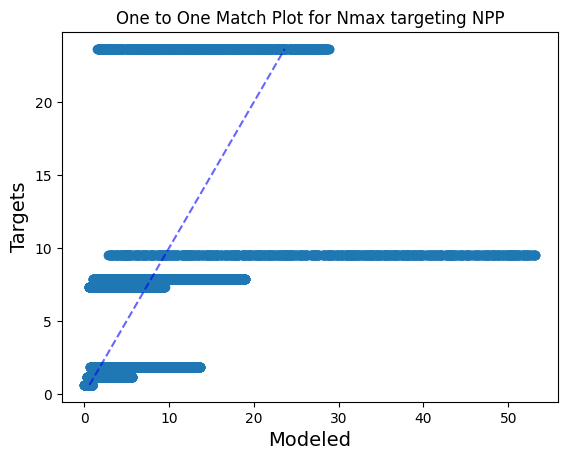

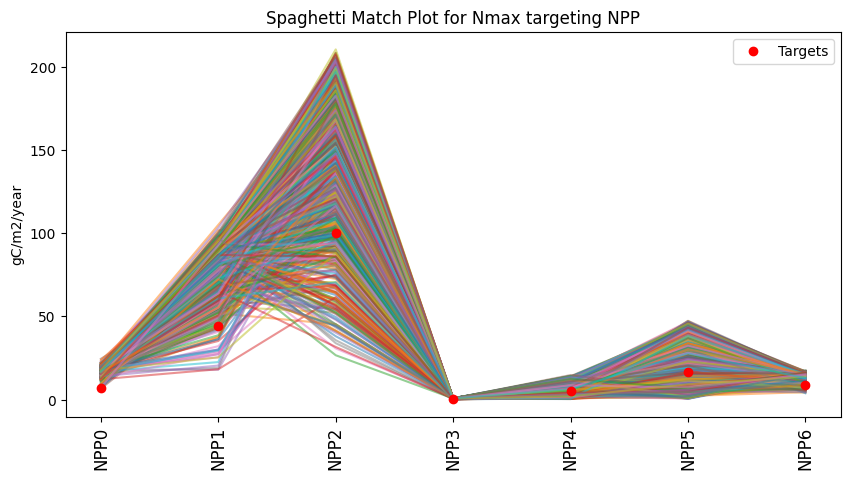

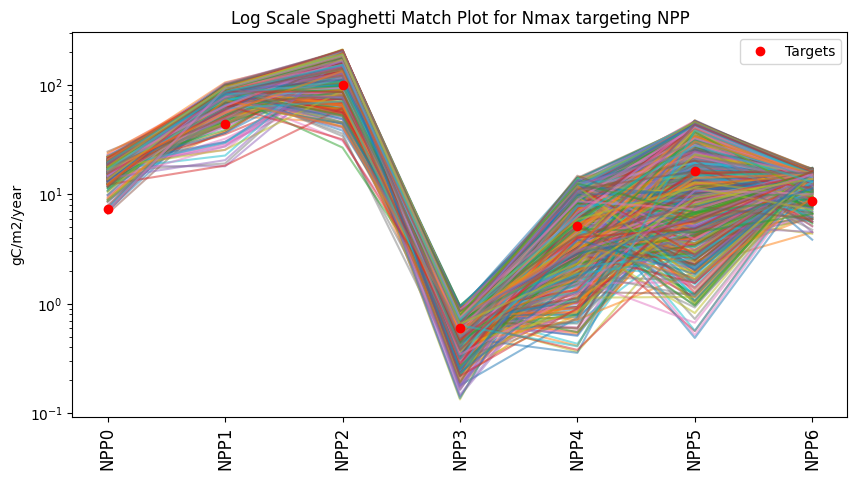

In [5]:
ut.one_to_one_match_plot(df_param.iloc[:,0:7])
plt.title(title_1)
ut.spaghetti_match_plot(df_param.iloc[:,0:7], df_model.iloc[:,0:7])
plt.ylabel(units_NPP)
plt.title(title_2)
ut.spaghetti_match_plot(df_param.iloc[:,0:7], df_model.iloc[:,0:7], logy=True)
plt.ylabel(units_NPP)
plt.title(title_3)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for krb targeting VEGC')

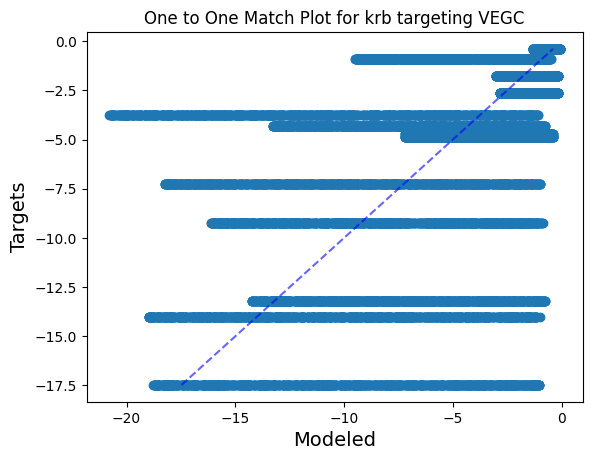

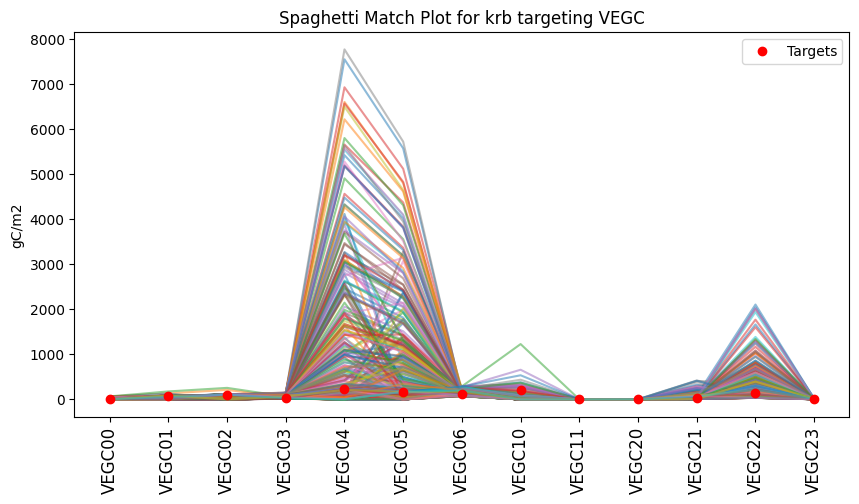

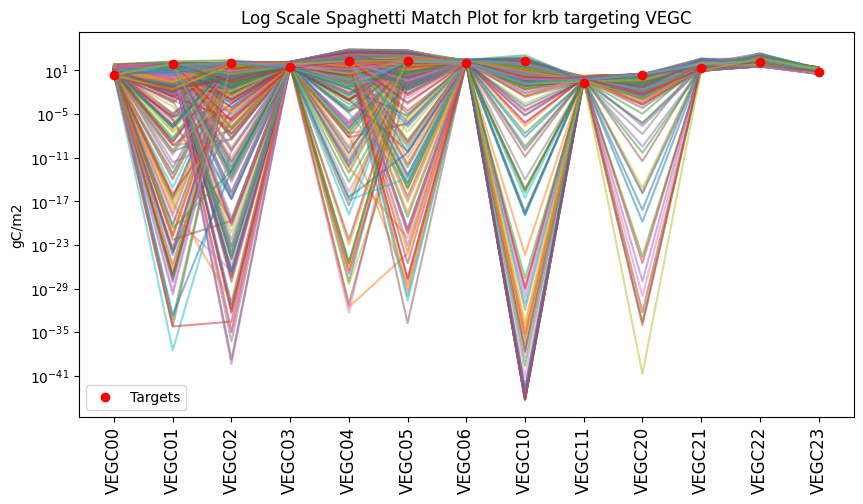

In [6]:
ut.one_to_one_match_plot(df_param.iloc[:,7:20])
plt.title(title_4)
ut.spaghetti_match_plot(df_param.iloc[:,7:20], df_model.iloc[:,7:20])
plt.ylabel(units_VEGC)
plt.title(title_5)
ut.spaghetti_match_plot(df_param.iloc[:,7:20], df_model.iloc[:,7:20], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_6)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for krb targeting VEGC')

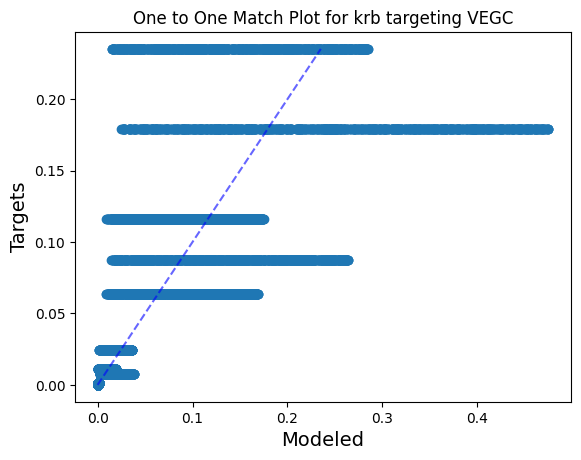

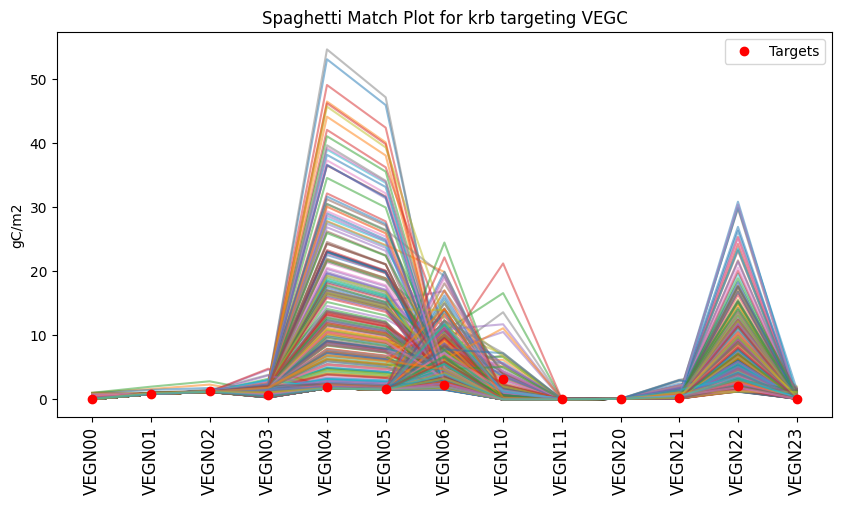

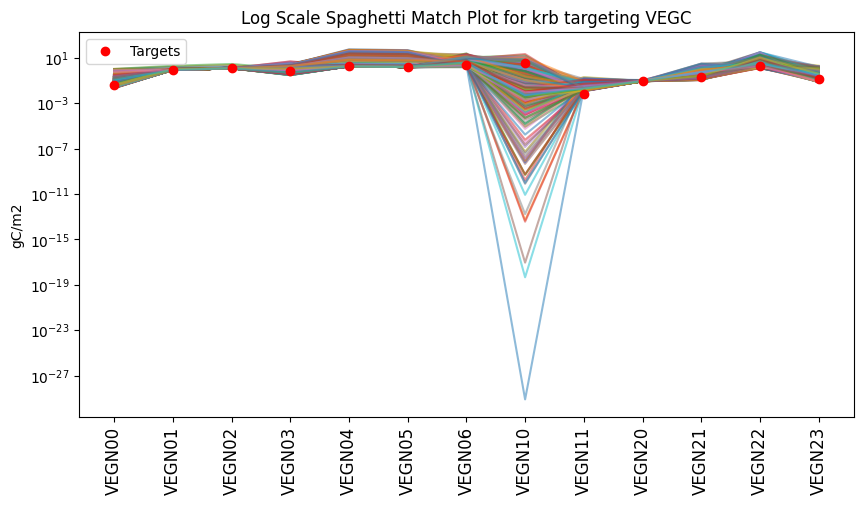

In [7]:
ut.one_to_one_match_plot(df_param.iloc[:,20:])
plt.title(title_4)
ut.spaghetti_match_plot(df_param.iloc[:,20:], df_model.iloc[:,20:])
plt.ylabel(units_VEGC)
plt.title(title_5)
ut.spaghetti_match_plot(df_param.iloc[:,20:], df_model.iloc[:,20:], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_6)

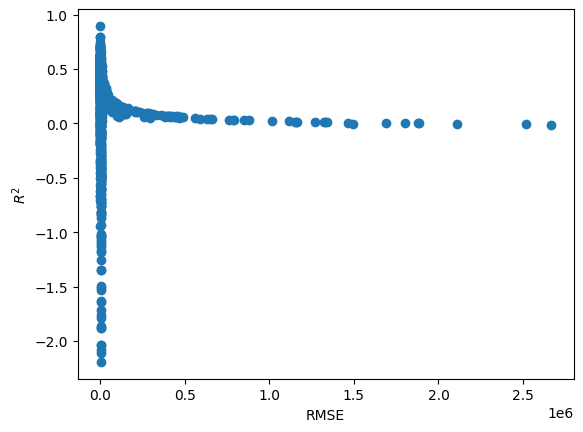

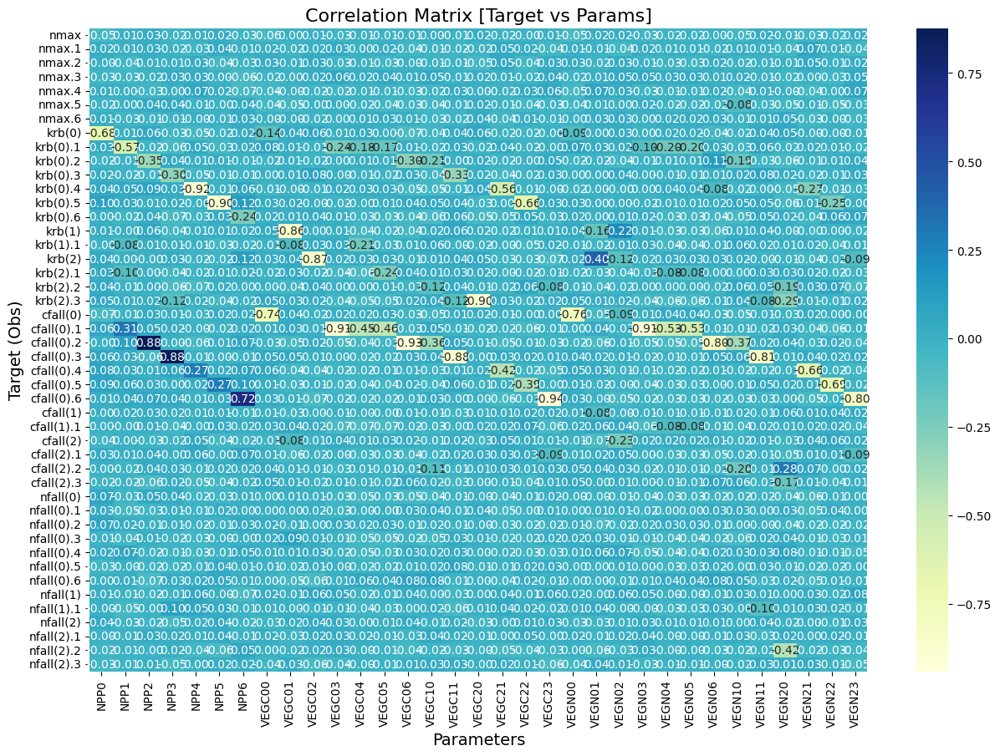

In [8]:
rmse=ut.plot_r2_rmse(df_model)
corr_mp=ut.get_output_param_corr(df_model,df_param)

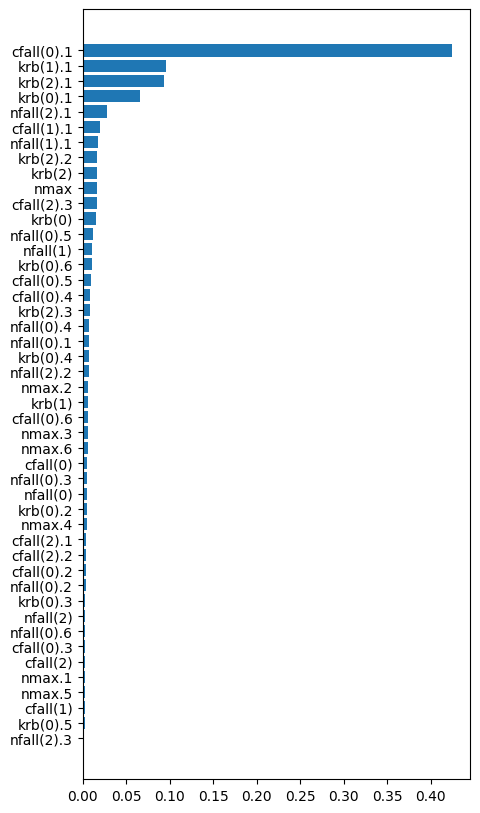

In [9]:
e_rmse=ut.find_important_features_err(df_param,df_model,error='rmse')

best errors

very few results have r2 > 0.7, using those, most targets are roughly in the center ish of range, and the range narrower than the run without nfall.

In [5]:
xparams, ymodel =  ut.get_params_r2_rmse(df_param,df_model,r2lim=0.7)
len(xparams)

11

In [6]:
xparams.describe()

,nmax,nmax.1,nmax.2,nmax.3,nmax.4,nmax.5,nmax.6,krb(0),krb(0).1,krb(0).2,...,nfall(0).6,nfall(1),nfall(1).1,nfall(2),nfall(2).1,nfall(2).2,nfall(2).3,$R^2$,RMSE,MAPE
count,11.000000,11.000000,11.000000,11.000000,11.000000,11.000000,11.000000,11.000000,11.000000,11.000000,...,11.000000,11.000000,11.000000,11.000000,11.000000,11.000000,11.000000,11.000000,11.000000,1.100000e+01
mean,8.068431,23.735558,16.960845,0.569940,3.546189,9.259765,4.509768,-8.101145,-7.874849,-2.181486,...,0.000510,0.000034,0.000021,0.000052,0.000085,0.005863,0.000955,0.748697,1429.159090,8.892314e+14
std,2.433176,14.751966,7.970918,0.262643,1.454686,4.770130,3.074097,2.961603,4.641379,0.417477,...,0.000207,0.000028,0.000010,0.000027,0.000044,0.004466,0.000335,0.059951,574.901715,2.949247e+15
min,4.249635,6.860264,4.082468,0.108730,0.782163,2.339337,0.561154,-12.622194,-14.144133,-2.767722,...,0.000089,0.000005,0.000007,0.000017,0.000028,0.001088,0.000568,0.704135,517.464039,2.853503e-01
25%,6.503700,13.518698,12.112418,0.374598,2.753078,6.362708,1.789105,-10.350108,-11.382852,-2.533534,...,0.000480,0.000010,0.000011,0.000030,0.000052,0.002386,0.000697,0.709263,1219.591119,4.279881e-01
50%,7.897277,22.139352,15.284400,0.595499,3.543209,8.632980,4.748701,-7.179010,-9.291610,-2.144111,...,0.000577,0.000031,0.000023,0.000052,0.000087,0.004038,0.000928,0.718988,1309.273863,5.555235e-01
75%,9.297133,25.942426,23.577713,0.755699,4.636153,11.824288,7.161874,-6.704633,-2.909413,-1.841465,...,0.000638,0.000049,0.000030,0.000072,0.000122,0.009513,0.001105,0.773034,1588.439400,3.590770e+00
max,12.654373,52.269686,26.930799,0.917671,5.427502,16.685268,8.774528,-2.381012,-1.726823,-1.483328,...,0.000710,0.000084,0.000032,0.000092,0.000148,0.012869,0.001512,0.896887,2613.318249,9.781545e+15


In [18]:
best=xparams[xparams.MAPE<1]
best_model=ymodel[xparams.MAPE<1]
len(best)
best_model = pd.concat([best_model, df_model.iloc[-1:]], ignore_index=True)

In [24]:
best

,nmax,nmax.1,nmax.2,nmax.3,nmax.4,nmax.5,nmax.6,krb(0),krb(0).1,krb(0).2,...,nfall(0).6,nfall(1),nfall(1).1,nfall(2),nfall(2).1,nfall(2).2,nfall(2).3,$R^2$,RMSE,MAPE
36,7.897277,18.198425,12.381414,0.452482,3.543209,10.282230,8.774528,-6.961740,-14.144133,-2.448847,...,0.000089,0.000007,0.000007,0.000092,0.000087,0.012869,0.000703,0.704135,1202.977082,0.602814
167,8.689143,27.114150,4.082468,0.741280,4.335013,6.610660,3.256153,-11.256801,-1.726823,-2.528984,...,0.000710,0.000005,0.000029,0.000086,0.000028,0.001911,0.000691,0.732666,2156.473038,0.404995
321,6.665126,52.269686,6.973501,0.108730,4.940882,16.632376,4.748701,-7.179010,-12.033386,-2.144111,...,0.000442,0.000031,0.000032,0.000065,0.000148,0.003910,0.000780,0.896887,517.464039,0.285350
593,12.654373,6.860264,22.782388,0.405981,4.680819,10.241239,0.853538,-12.622194,-1.866910,-1.763745,...,0.000518,0.000033,0.000031,0.000049,0.000028,0.011845,0.000568,0.705474,1303.306054,0.555523
755,10.990762,13.989028,15.284400,0.896505,3.385205,8.632980,0.561154,-2.381012,-8.561962,-1.483328,...,0.000570,0.000009,0.000010,0.000042,0.000063,0.002351,0.001512,0.794756,836.614897,0.341224
764,5.608307,13.048369,26.096350,0.721621,2.138379,6.114756,7.124111,-11.240792,-10.413981,-1.877971,...,0.000609,0.000072,0.000023,0.000018,0.000124,0.004575,0.001191,0.704957,1309.273863,0.587673
814,7.570635,24.464698,23.362555,0.343215,3.367776,2.339337,7.199637,-9.459425,-11.582125,-2.538085,...,0.000577,0.000066,0.000019,0.000017,0.000121,0.001088,0.001509,0.798828,1236.205157,0.450981
834,4.249635,24.770702,26.930799,0.316240,4.591487,3.840704,2.104896,-6.447526,-3.910380,-2.588176,...,0.000644,0.000084,0.000030,0.000079,0.000089,0.004038,0.001006,0.714612,2613.318249,0.500153


In [19]:
best_model

,NPP0,NPP1,NPP2,NPP3,NPP4,NPP5,NPP6,VEGC00,VEGC01,VEGC02,...,VEGN03,VEGN04,VEGN05,VEGN06,VEGN10,VEGN11,VEGN20,VEGN21,VEGN22,VEGN23
0,18.378091,88.850216,122.512089,0.681925,12.117236,8.692044,16.308209,25.226119,56.392913,102.682955,...,0.986198,1.763759,1.510703,5.288112,1.282809,0.018081,0.084974,0.480671,1.600180,0.145942
1,17.186320,55.518122,123.779766,0.190906,8.553588,45.014461,15.598932,3.445266,64.718865,76.500714,...,0.860600,1.904182,1.521301,8.583273,4.368027,0.136565,0.100350,0.241326,3.464643,0.177547
2,17.657153,92.430803,85.425867,0.800186,2.151095,11.352734,16.844394,2.762658,70.504463,101.606480,...,0.766467,1.759570,1.521289,7.377287,3.458627,0.014226,0.089744,0.245924,2.749927,0.153274
3,17.257509,35.283263,96.817194,0.848018,3.847489,18.968539,15.938943,2.126552,70.894154,32.381262,...,2.195675,1.769319,1.536838,8.075113,0.876413,0.019998,0.088177,0.129718,2.949448,0.080463
4,15.133626,91.924416,99.171517,0.768581,12.382999,9.050928,15.922189,3.682561,72.907417,103.020599,...,0.615036,1.756481,1.521297,10.096960,1.996584,0.016656,0.099476,0.346292,1.573175,0.113024
5,18.422187,90.883556,126.836815,0.607569,11.969914,39.864596,5.591689,3.830286,70.097825,103.771859,...,0.438057,1.759562,1.521289,5.381531,0.532656,0.028167,0.094014,0.282160,2.658046,1.613505
6,20.326869,89.687825,123.347177,0.651074,11.778266,4.998922,14.720517,18.201560,70.176506,100.225137,...,0.624527,1.743234,1.517918,8.719042,3.719498,0.028782,0.093679,0.217807,2.500564,0.081057
7,19.284908,77.183369,40.248235,0.730456,7.969396,5.117627,4.528642,11.030543,71.398463,103.877557,...,1.660781,1.867584,1.616640,10.906645,11.717059,0.012826,0.085983,0.283569,11.800390,1.757294
8,7.277000,44.082000,100.470000,0.598000,5.156000,16.357000,8.713000,2.464000,71.674000,105.495000,...,0.660000,1.861000,1.609000,2.189000,3.180000,0.006000,0.092000,0.190000,2.065000,0.139000


Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for Nmax targeting NPP')

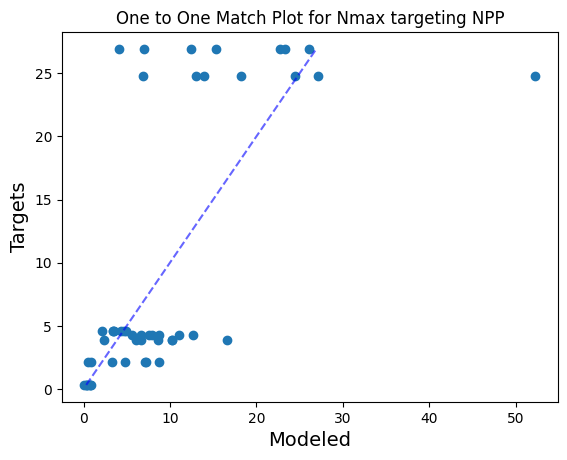

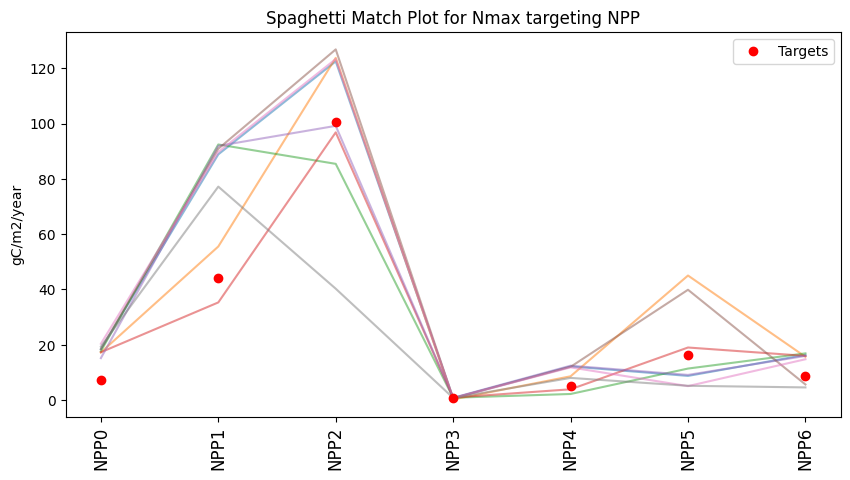

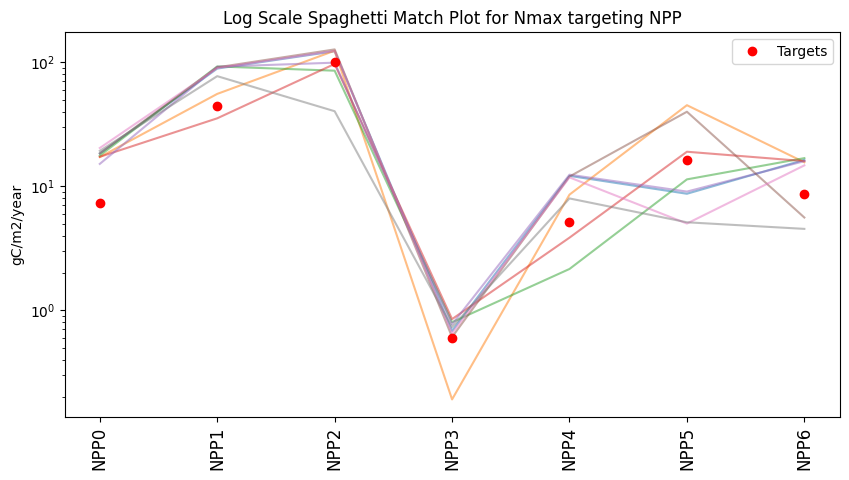

In [20]:
ut.one_to_one_match_plot(best.iloc[:,0:7])
plt.title(title_1)
ut.spaghetti_match_plot(best.iloc[:,0:7], best_model.iloc[:,0:7])
plt.ylabel(units_NPP)
plt.title(title_2)
ut.spaghetti_match_plot(best.iloc[:,0:7], best_model.iloc[:,0:7], logy=True)
plt.ylabel(units_NPP)
plt.title(title_3)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for krb targeting VEGC')

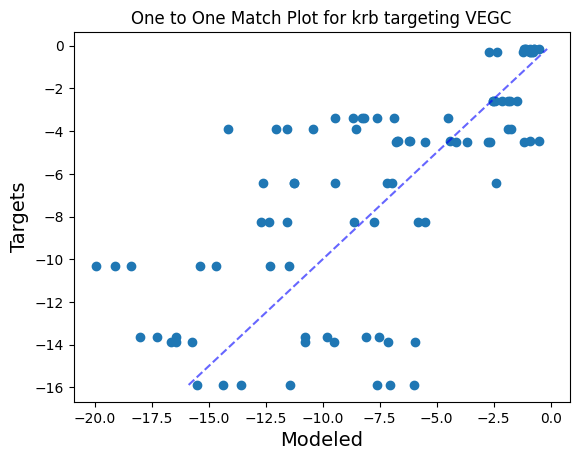

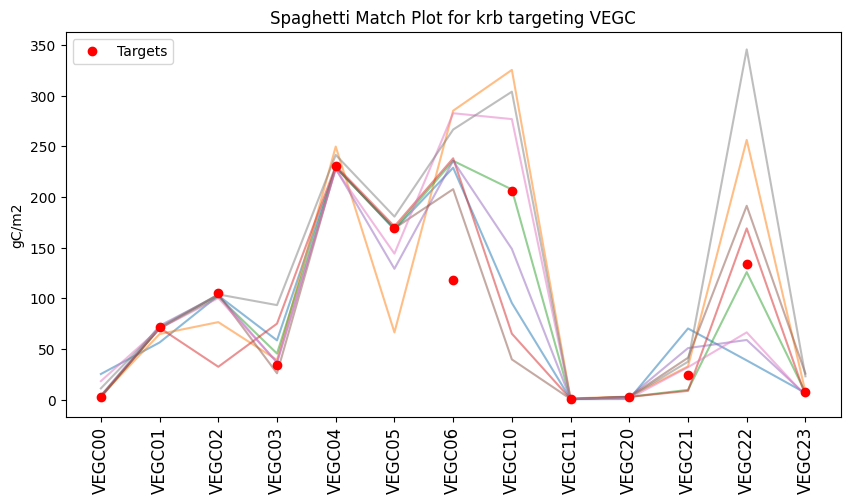

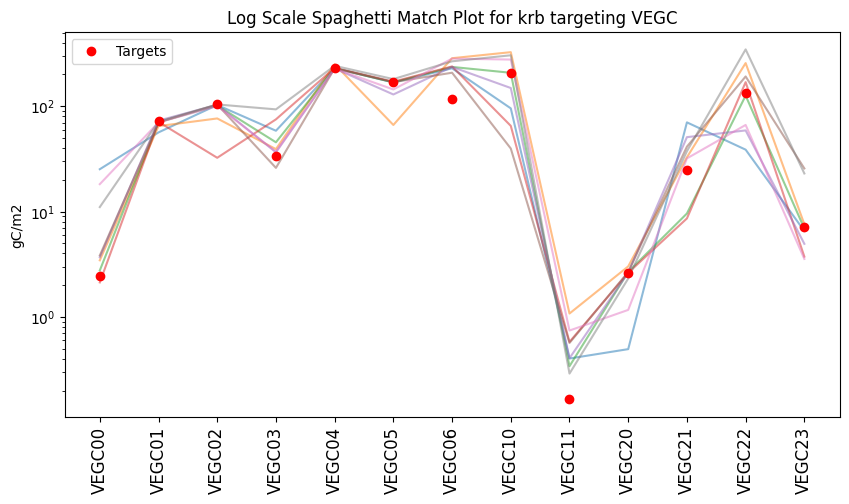

In [21]:
ut.one_to_one_match_plot(best.iloc[:,7:20])
plt.title(title_4)
ut.spaghetti_match_plot(best.iloc[:,7:20], best_model.iloc[:,7:20])
plt.ylabel(units_VEGC)
plt.title(title_5)
ut.spaghetti_match_plot(best.iloc[:,7:20], best_model.iloc[:,7:20], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_6)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for krb targeting VEGC')

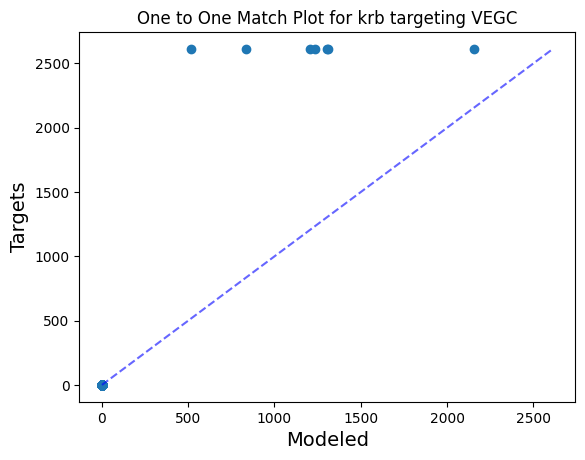

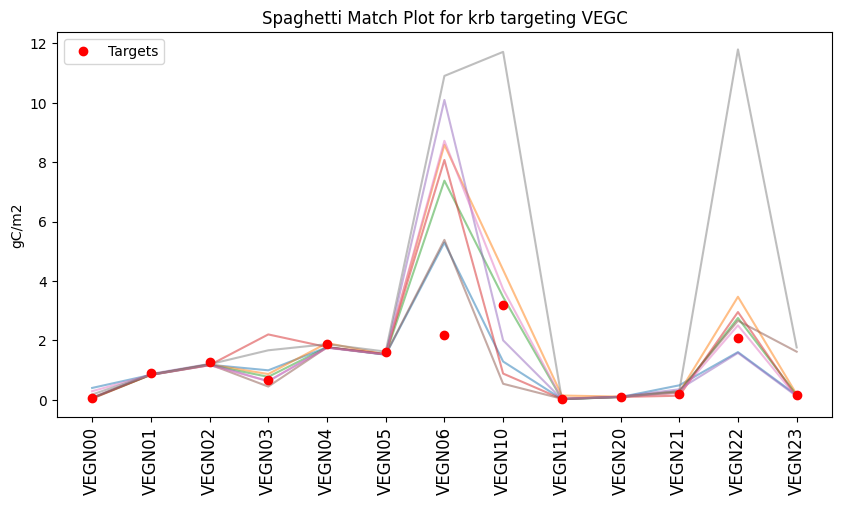

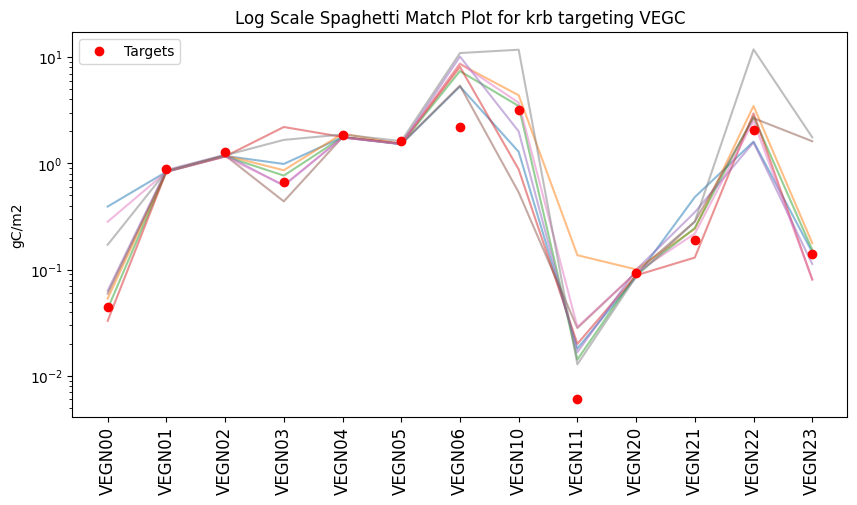

In [22]:
ut.one_to_one_match_plot(best.iloc[:,20:])
plt.title(title_4)
ut.spaghetti_match_plot(best.iloc[:,20:], best_model.iloc[:,20:])
plt.ylabel(units_VEGC)
plt.title(title_5)
ut.spaghetti_match_plot(best.iloc[:,20:], best_model.iloc[:,20:], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_6)

In [25]:
#print bounds of param from best scores
x_max = best.max()
x_min = best.min()

# Create a list of pairs [x_min, x_max] where x_min and x_max correspond to the same index in xparams
result = [[x_min[i], x_max[i]] for i in range(len(x_max))]

for pair in result:
    print("Uniform({:.5f}, {:.5f})".format(pair[0], pair[1]))

Uniform(4.24963, 12.65437)
Uniform(6.86026, 52.26969)
Uniform(4.08247, 26.93080)
Uniform(0.10873, 0.89651)
Uniform(2.13838, 4.94088)
Uniform(2.33934, 16.63238)
Uniform(0.56115, 8.77453)
Uniform(-12.62219, -2.38101)
Uniform(-14.14413, -1.72682)
Uniform(-2.58818, -1.48333)
Uniform(-2.68768, -0.30617)
Uniform(-6.74527, -0.49555)
Uniform(-6.78220, -1.17595)
Uniform(-1.15223, -0.15319)
Uniform(-18.00369, -7.53717)
Uniform(-19.94222, -10.33697)
Uniform(-16.66382, -5.94992)
Uniform(-15.88465, -5.99065)
Uniform(-9.47015, -3.40609)
Uniform(-12.70520, -5.51159)
Uniform(0.06141, 0.40942)
Uniform(0.03859, 0.24573)
Uniform(0.00900, 0.04612)
Uniform(0.01434, 0.16878)
Uniform(0.01446, 0.03634)
Uniform(0.00124, 0.01856)
Uniform(0.01614, 0.25423)
Uniform(0.00000, 0.00001)
Uniform(0.00000, 0.00001)
Uniform(0.00001, 0.00002)
Uniform(0.00000, 0.00001)
Uniform(0.00324, 0.02994)
Uniform(0.00000, 0.00002)
Uniform(0.00000, 0.00002)
Uniform(0.00004, 0.00026)
Uniform(0.00001, 0.00004)
Uniform(0.00006, 0.00072)


(with cmax fixed)

In [3]:
params='sa_nmaxkrbcfallnfall_EML21_090_AK-2/sample_matrix.csv'
model='sa_nmaxkrbcfallnfall_EML21_090_AK-2/results.txt'
df_param = pd.read_csv(path_SA+params)
df_model = pd.read_csv(path_SA+model,header=None)

output_name = ['NPP0','NPP1','NPP2','NPP3','NPP4','NPP5','NPP6',\
               'VEGC00','VEGC01','VEGC02','VEGC03','VEGC04','VEGC05','VEGC06',\
                'VEGC10','VEGC11',\
                'VEGC20','VEGC21','VEGC22','VEGC23',\
                'VEGN00','VEGN01','VEGN02','VEGN03','VEGN04','VEGN05','VEGN06',\
                'VEGN10','VEGN11',\
                'VEGN20','VEGN21','VEGN22','VEGN23']
df_model.columns = output_name
units_NPP = 'gC/m2/year'
units_VEGC = 'gC/m2'
title_1='One to One Match Plot for Nmax targeting NPP'
title_2='Spaghetti Match Plot for Nmax targeting NPP'
title_3='Log Scale Spaghetti Match Plot for Nmax targeting NPP'

title_4='One to One Match Plot for krb targeting VEGC'
title_5='Spaghetti Match Plot for krb targeting VEGC'
title_6='Log Scale Spaghetti Match Plot for krb targeting VEGC'

title_7='One to One Match Plot for krb/cfall/nfall targeting VEGN'
title_8='Spaghetti Match Plot for krb/cfall/nfall targeting VEGN'
title_9='Log Scale Spaghetti Match Plot for krb/cfall/nfall targeting VEGN'

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for Nmax targeting NPP')

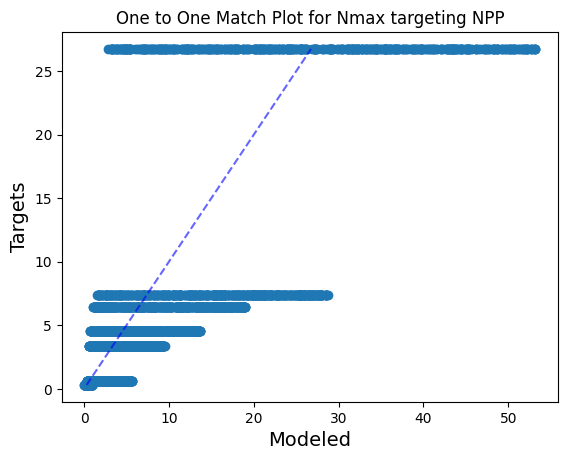

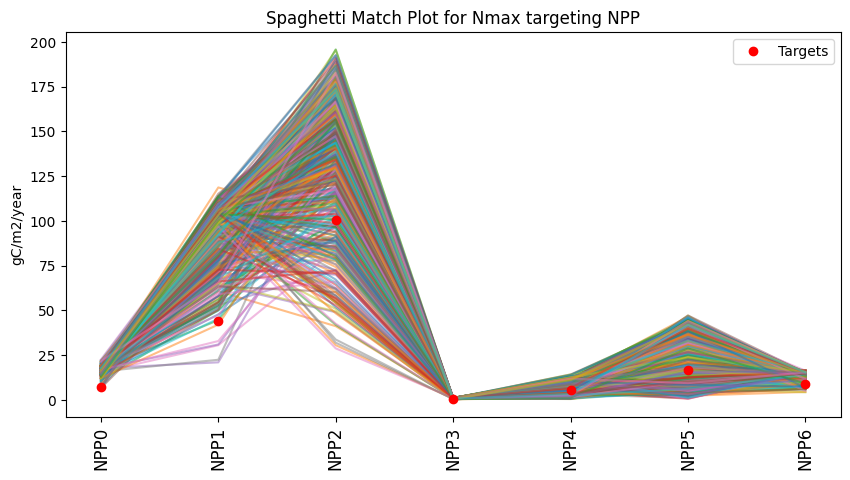

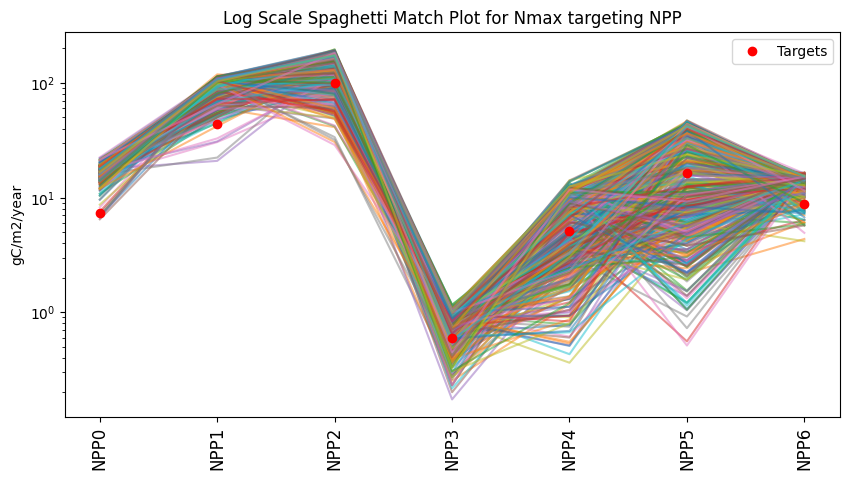

In [4]:
ut.one_to_one_match_plot(df_param.iloc[:,0:7])
plt.title(title_1)
ut.spaghetti_match_plot(df_param.iloc[:,0:7], df_model.iloc[:,0:7])
plt.ylabel(units_NPP)
plt.title(title_2)
ut.spaghetti_match_plot(df_param.iloc[:,0:7], df_model.iloc[:,0:7], logy=True)
plt.ylabel(units_NPP)
plt.title(title_3)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for krb targeting VEGC')

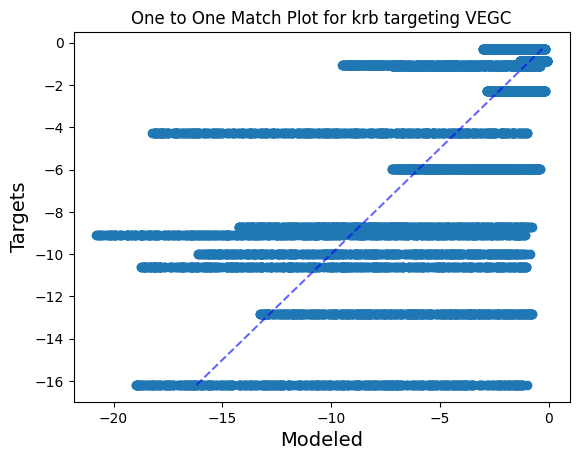

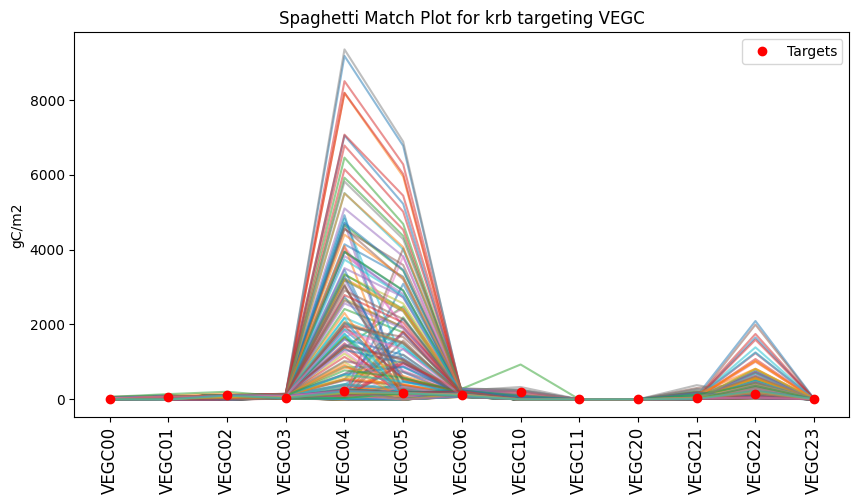

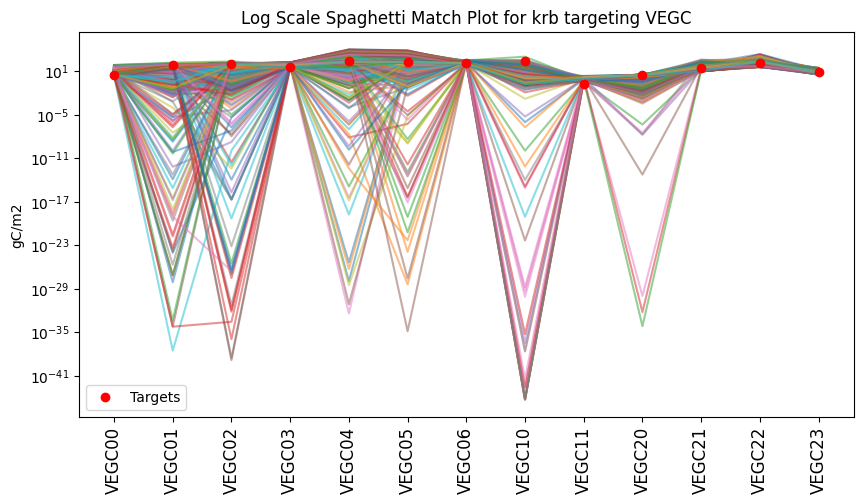

In [5]:
ut.one_to_one_match_plot(df_param.iloc[:,7:20])
plt.title(title_4)
ut.spaghetti_match_plot(df_param.iloc[:,7:20], df_model.iloc[:,7:20])
plt.ylabel(units_VEGC)
plt.title(title_5)
ut.spaghetti_match_plot(df_param.iloc[:,7:20], df_model.iloc[:,7:20], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_6)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for krb targeting VEGC')

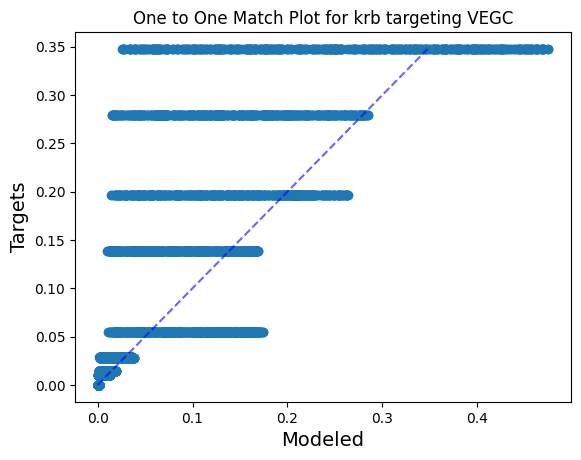

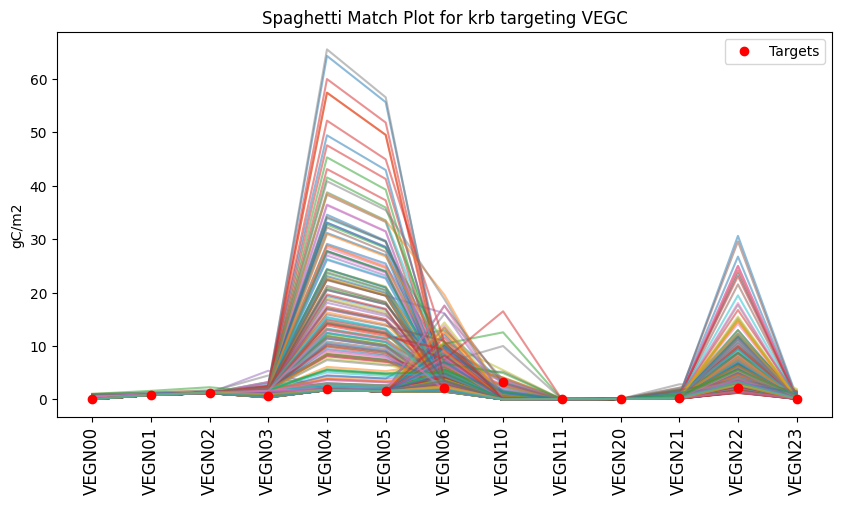

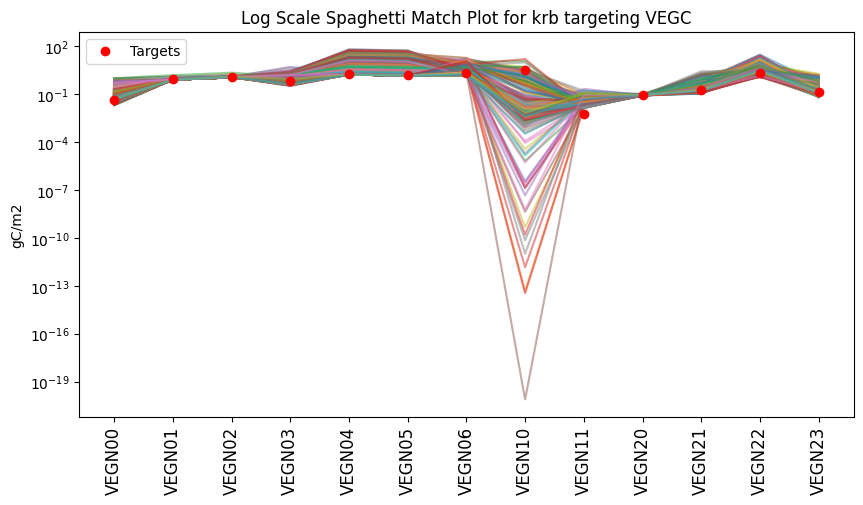

In [6]:
ut.one_to_one_match_plot(df_param.iloc[:,20:])
plt.title(title_4)
ut.spaghetti_match_plot(df_param.iloc[:,20:], df_model.iloc[:,20:])
plt.ylabel(units_VEGC)
plt.title(title_5)
ut.spaghetti_match_plot(df_param.iloc[:,20:], df_model.iloc[:,20:], logy=True)
plt.ylabel(units_VEGC)
plt.title(title_6)

### best errors

In [8]:
xparams, ymodel =  ut.get_params_r2_rmse(df_param,df_model,r2lim=0.7)
len(xparams)

4

In [9]:
xparams.describe()

,nmax,nmax.1,nmax.2,nmax.3,nmax.4,nmax.5,nmax.6,krb(0),krb(0).1,krb(0).2,...,nfall(0).6,nfall(1),nfall(1).1,nfall(2),nfall(2).1,nfall(2).2,nfall(2).3,$R^2$,RMSE,MAPE
count,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,...,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000e+00
mean,8.490101,26.911302,14.023388,0.549909,5.011613,9.493625,4.038079,-8.452673,-5.877234,-2.498735,...,0.000432,0.000035,0.000024,0.000048,0.000074,0.004479,0.000744,0.777045,1308.657760,2.445386e+15
std,1.343741,18.360099,9.935008,0.302791,0.498534,4.776971,2.209320,1.948490,4.990957,0.259548,...,0.000229,0.000041,0.000010,0.000033,0.000052,0.002192,0.000149,0.056169,479.942194,4.890773e+15
min,6.665126,9.575327,4.082468,0.108730,4.335013,6.610660,1.473313,-11.256801,-12.033386,-2.767722,...,0.000150,0.000005,0.000010,0.000017,0.000028,0.001911,0.000575,0.733254,637.301153,3.208513e-01
25%,8.183139,16.408367,6.250743,0.473806,4.789415,6.986305,2.810443,-9.033924,-8.888558,-2.607524,...,0.000357,0.000010,0.000023,0.000022,0.000047,0.003411,0.000662,0.747867,1155.441169,3.671657e-01
50%,8.695078,22.900098,14.109108,0.668390,5.141968,7.365732,4.002427,-7.735988,-4.874364,-2.541554,...,0.000434,0.000021,0.000028,0.000045,0.000060,0.004412,0.000735,0.757839,1422.769614,4.103313e-01
75%,9.002040,33.403034,21.881754,0.744493,5.364166,9.873052,5.230063,-7.154737,-1.863040,-2.432766,...,0.000509,0.000047,0.000030,0.000071,0.000087,0.005481,0.000817,0.787016,1575.986205,2.445386e+15
max,9.905122,52.269686,23.792871,0.754129,5.427502,16.632376,6.674151,-7.081915,-1.726823,-2.144111,...,0.000710,0.000094,0.000032,0.000086,0.000148,0.007181,0.000928,0.859249,1751.790660,9.781545e+15


Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for Nmax targeting NPP')

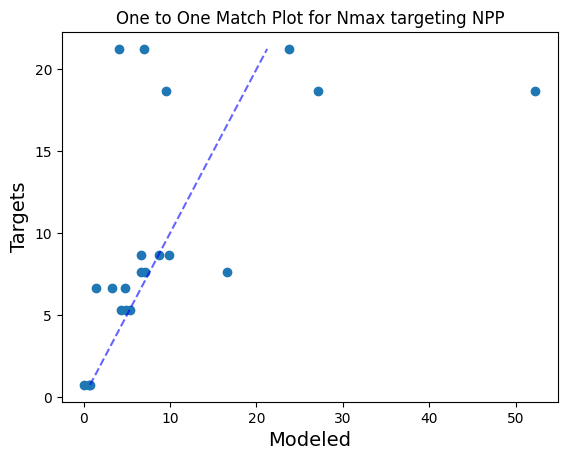

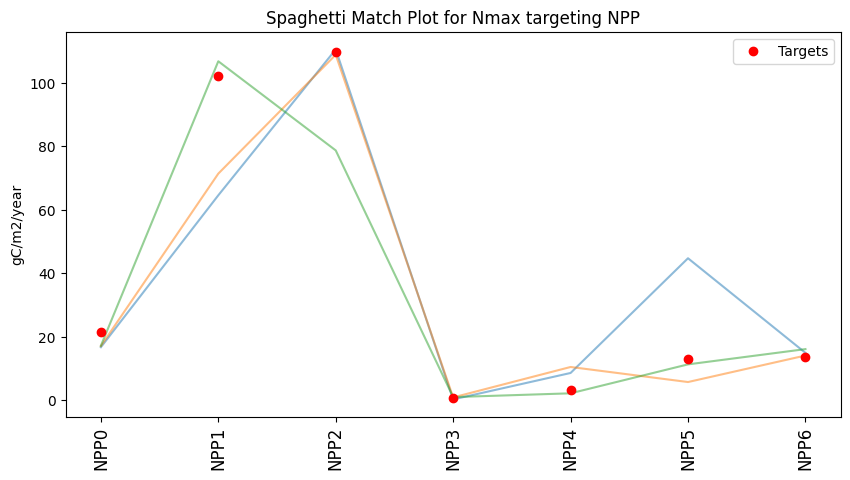

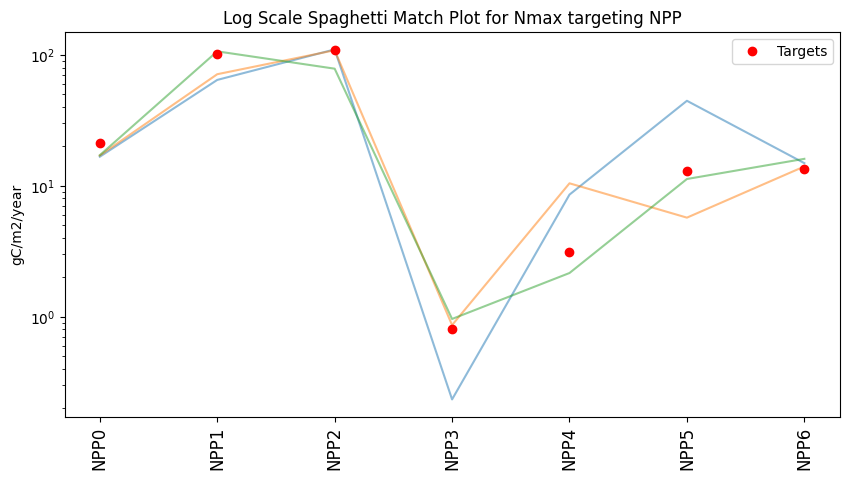

In [10]:
ut.one_to_one_match_plot(xparams.iloc[:,0:7])
plt.title(title_1)
ut.spaghetti_match_plot(xparams.iloc[:,0:7], ymodel.iloc[:,0:7])
plt.ylabel(units_NPP)
plt.title(title_2)
ut.spaghetti_match_plot(xparams.iloc[:,0:7], ymodel.iloc[:,0:7], logy=True)
plt.ylabel(units_NPP)
plt.title(title_3)

Text(0.5, 1.0, 'Log Scale Spaghetti Match Plot for Nmax targeting NPP')

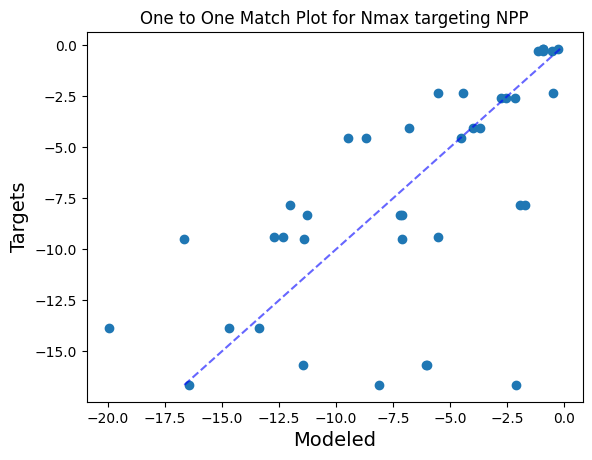

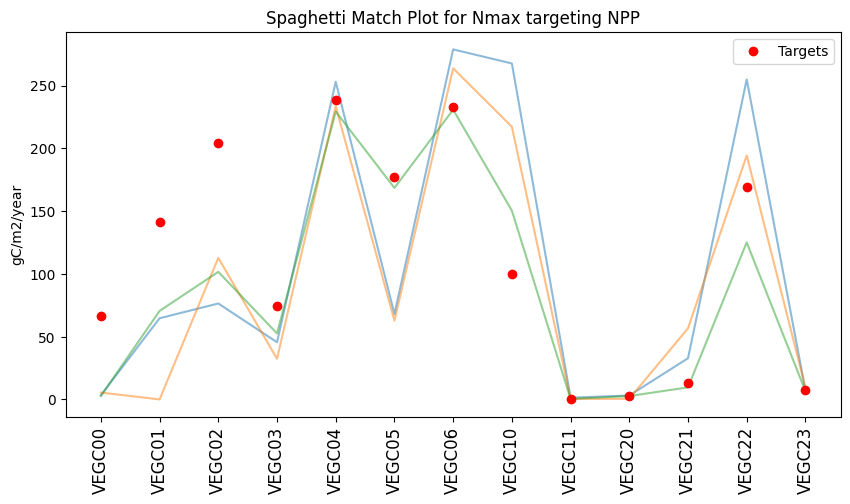

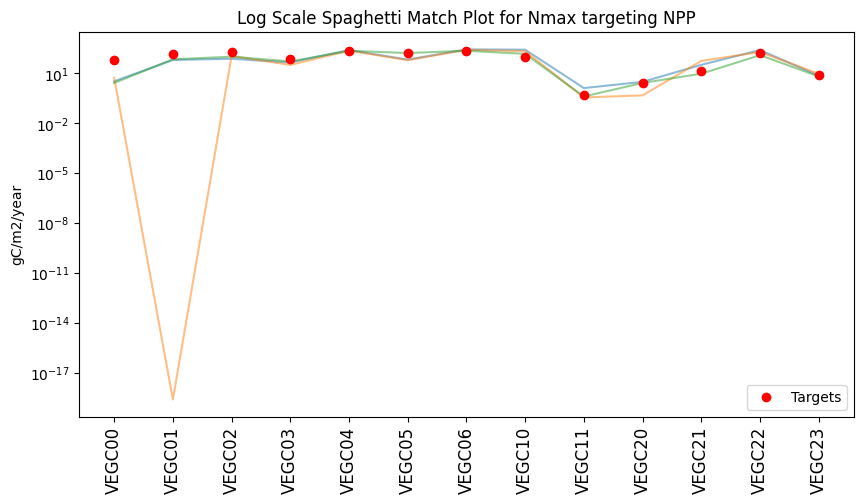

In [11]:
ut.one_to_one_match_plot(xparams.iloc[:,7:20])
plt.title(title_1)
ut.spaghetti_match_plot(xparams.iloc[:,7:20], ymodel.iloc[:,7:20])
plt.ylabel(units_NPP)
plt.title(title_2)
ut.spaghetti_match_plot(xparams.iloc[:,7:20], ymodel.iloc[:,7:20], logy=True)
plt.ylabel(units_NPP)
plt.title(title_3)

# Soil Only

fixed equilibrium run time, but still significant underestimation for Deep C mineral sum.

In [45]:
params='sa_soil_EML21_090_AK-3/sample_matrix.csv'
model='sa_soil_EML21_090_AK-3/results.txt'
df_param = pd.read_csv(path_SA+params)
df_model = pd.read_csv(path_SA+model,header=None)

output_name = ['CarbonShallow','CarbonDeep','CarbonMineralSum','AvailableNitrogenSum']
df_model.columns = output_name
title_1 = 'Soil'
units_Soil = 'g/m2'

In [46]:
!cat ../../dvm-dos-tem/mads_calibration/SA/EML/sa_soil_EML21_090_AK/param_props.csv

name,bounds,initial,cmtnum,pftnum
micbnup,"[0.07899999999999996, 1.5010000000000001]",0.79,21,None
kdcrawc,"[0.02149999999999999, 0.4085]",0.215,21,None
kdcsoma,"[0.009999999999999995, 0.19]",0.1,21,None
kdcsompr,"[0.0007999999999999995, 0.015200000000000002]",0.008,21,None
kdcsomcr,"[4.9999999999999996e-06, 9.5e-05]",5e-05,21,None


In [47]:
df_param

,micbnup,kdcrawc,kdcsoma,kdcsompr,kdcsomcr
0,0.611596,0.389426,0.365738,0.009421,0.000019
1,0.300824,0.043978,0.428052,0.009456,0.000069
2,0.108271,0.396855,0.412386,0.003858,0.000021
3,0.339801,0.139242,0.269497,0.007020,0.000031
4,0.949055,0.075484,0.161472,0.006076,0.000046
...,...,...,...,...,...
245,0.986984,0.175369,0.153146,0.014969,0.000042
246,1.350409,0.110492,0.124766,0.001248,0.000064
247,0.603044,0.356007,0.245559,0.014742,0.000022
248,1.314182,0.322043,0.383816,0.012965,0.000073


Text(0.5, 1.0, 'Soil')

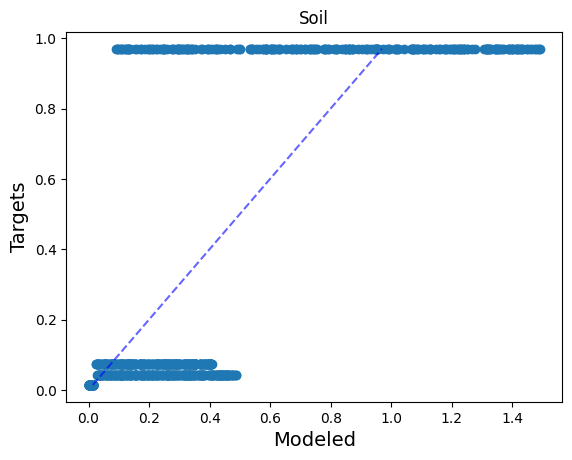

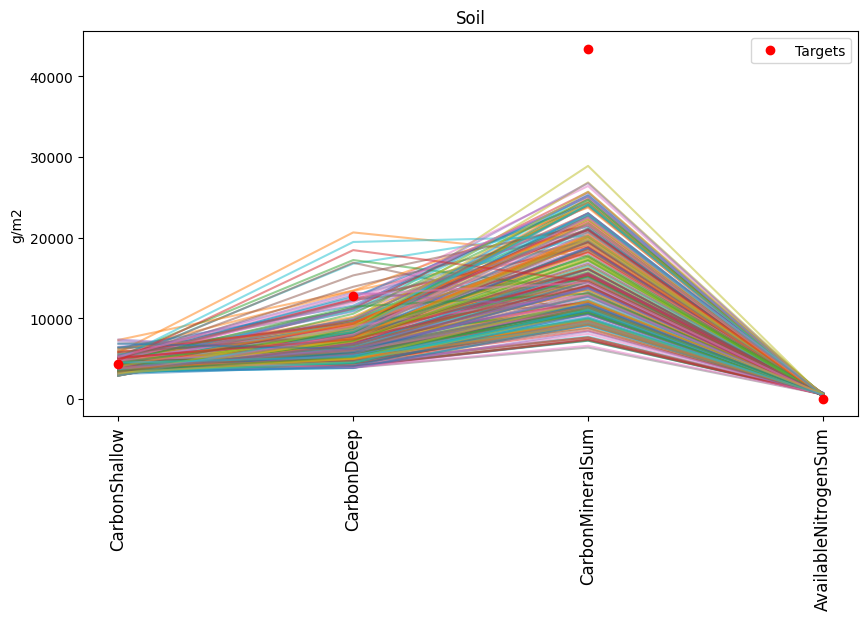

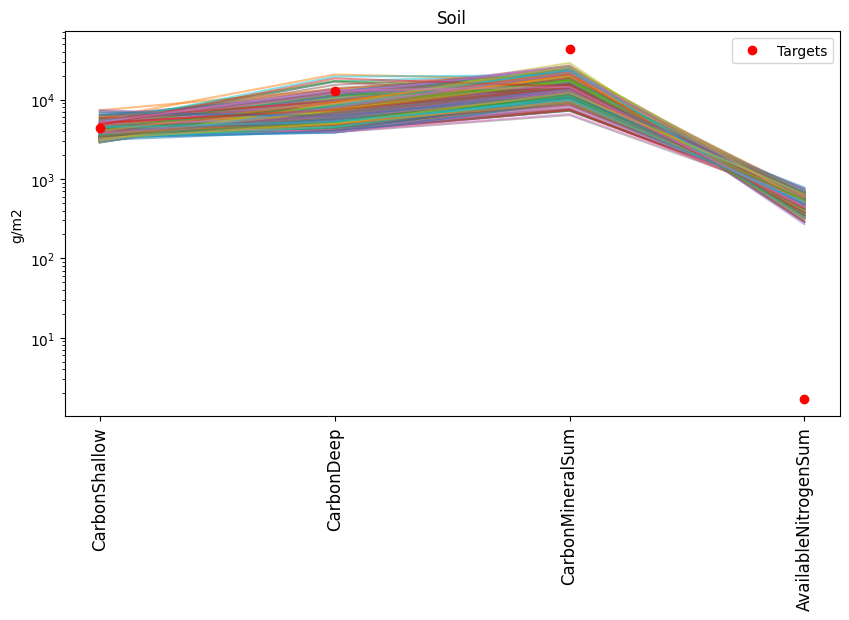

In [48]:
ut.one_to_one_match_plot(df_param.iloc[:,0:4])
plt.title(title_1)
ut.spaghetti_match_plot(df_param.iloc[:,0:4], df_model.iloc[:,0:4])
plt.ylabel(units_Soil)
plt.title(title_1)
ut.spaghetti_match_plot(df_param.iloc[:,0:4], df_model.iloc[:,0:4], logy=True)
plt.ylabel(units_Soil)
plt.title(title_1)

In [9]:
xparams, ymodel =  ut.get_params_r2_rmse(df_param,df_model,r2lim=0.2)
len(xparams)

4

In [10]:
xparams.describe()

,micbnup,kdcrawc,kdcsoma,kdcsompr,kdcsomcr,$R^2$,RMSE,MAPE
count,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000e+00,4.000000
mean,0.830333,0.334470,0.277472,0.005525,0.000007,0.364487,6.760978e+07,0.530859
std,0.491556,0.066877,0.180861,0.003109,0.000001,0.131764,8.106792e+06,0.078456
min,0.297066,0.248371,0.032484,0.002471,0.000006,0.255666,5.556923e+07,0.449970
25%,0.513161,0.298183,0.203672,0.003539,0.000007,0.303768,6.640854e+07,0.472448
50%,0.803967,0.349420,0.313371,0.005013,0.000007,0.323006,7.118337e+07,0.529381
75%,1.121138,0.385707,0.387171,0.006999,0.000008,0.383725,7.238460e+07,0.587792
max,1.416332,0.390670,0.450663,0.009605,0.000009,0.556271,7.250316e+07,0.614704


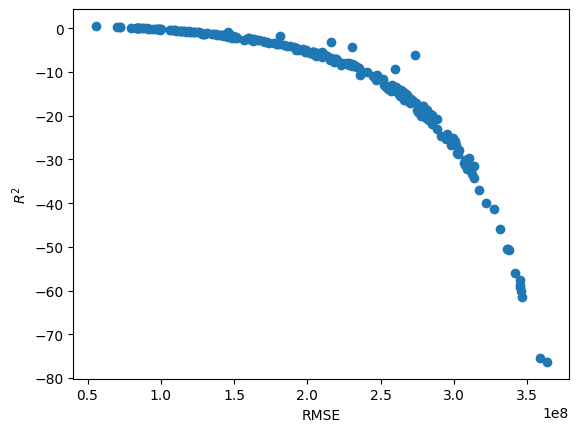

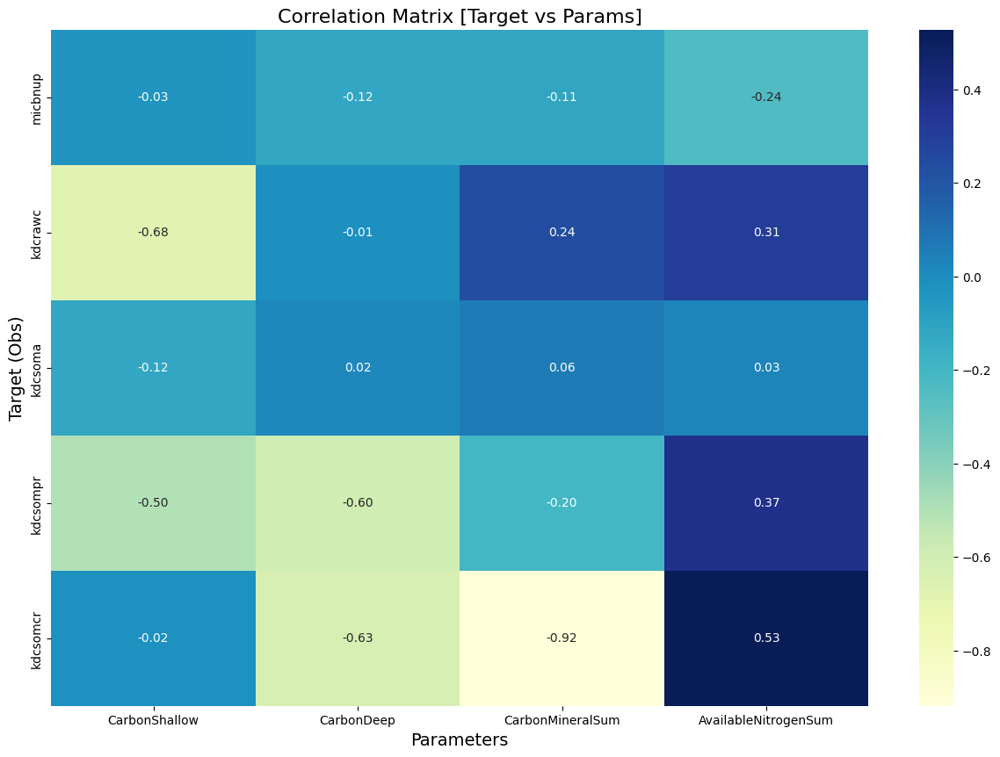

In [11]:
rmse=ut.plot_r2_rmse(df_model)
corr_mp=ut.get_output_param_corr(df_model,df_param)

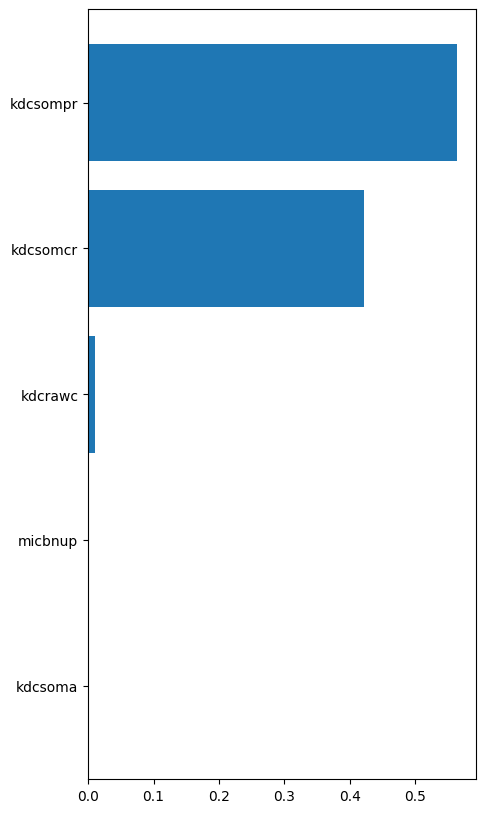

In [14]:
e_rmse=ut.find_important_features_err(df_param,df_model,error='rmse')

# Soil Only second test (shifted IG)

ran with full 2000 equil

In [4]:
params='sa_soil_EML21_090_AK-2/sample_matrix.csv'
model='sa_soil_EML21_090_AK-2/results.txt'
df_param = pd.read_csv(path_SA_old+params)
df_model = pd.read_csv(path_SA_old+model,header=None)

output_name = ['CarbonShallow','CarbonDeep','CarbonMineralSum','AvailableNitrogenSum']
df_model.columns = output_name
title_1 = 'Soil'
units_Soil = 'g/m2'

In [52]:
!cat ../../dvm-dos-tem/mads_calibration/SA/EML/sa_soil_EML21_090_AK-2/param_props.csv

name,bounds,initial,cmtnum,pftnum
micbnup,"[0.07899999999999996, 1.5010000000000001]",0.79,21,None
kdcrawc,"[0.02149999999999999, 0.4085]",0.215,21,None
kdcsoma,"[0.009999999999999995, 0.19]",0.1,21,None
kdcsompr,"[0.0008999999999999998, 0.017099999999999997]",0.009,21,None
kdcsomcr,"[5.000000000000003e-07, 9.5e-06]",5e-06,21,None


In [53]:
df_param

,micbnup,kdcrawc,kdcsoma,kdcsompr,kdcsomcr
0,0.393547,0.602614,0.497418,0.011157,-0.000019
1,-0.297057,-0.165048,0.635894,0.011236,0.000092
2,-0.724953,0.619122,0.601081,-0.001205,-0.000014
3,-0.210442,0.046648,0.283549,0.005822,0.000008
4,1.143455,-0.095035,0.043493,0.003724,0.000041
...,...,...,...,...,...
245,1.227742,0.126931,0.024990,0.023487,0.000032
246,2.035353,-0.017239,-0.038076,-0.007004,0.000080
247,0.374543,0.528348,0.230353,0.022982,-0.000013
248,1.954849,0.452873,0.537591,0.019033,0.000102


Text(0.5, 1.0, 'Soil')

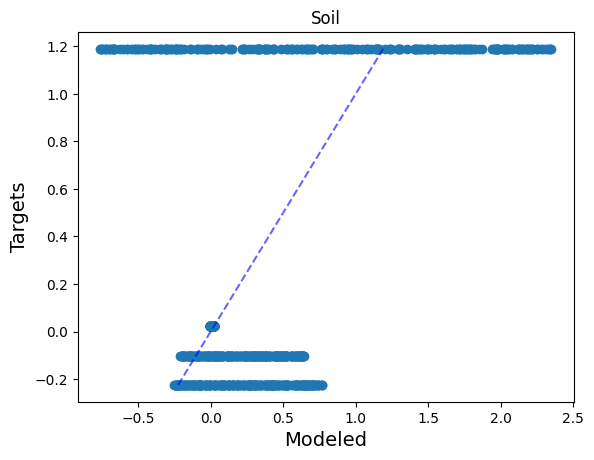

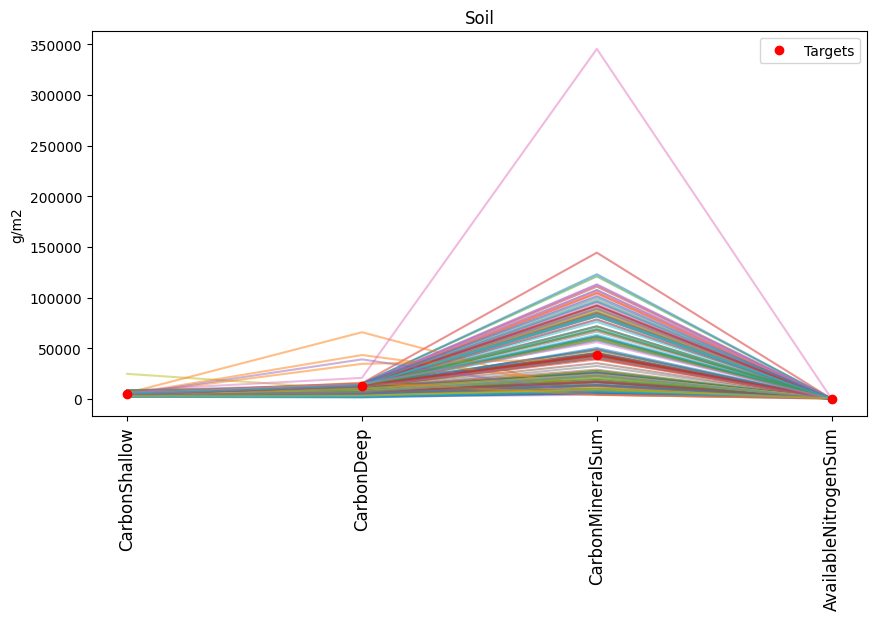

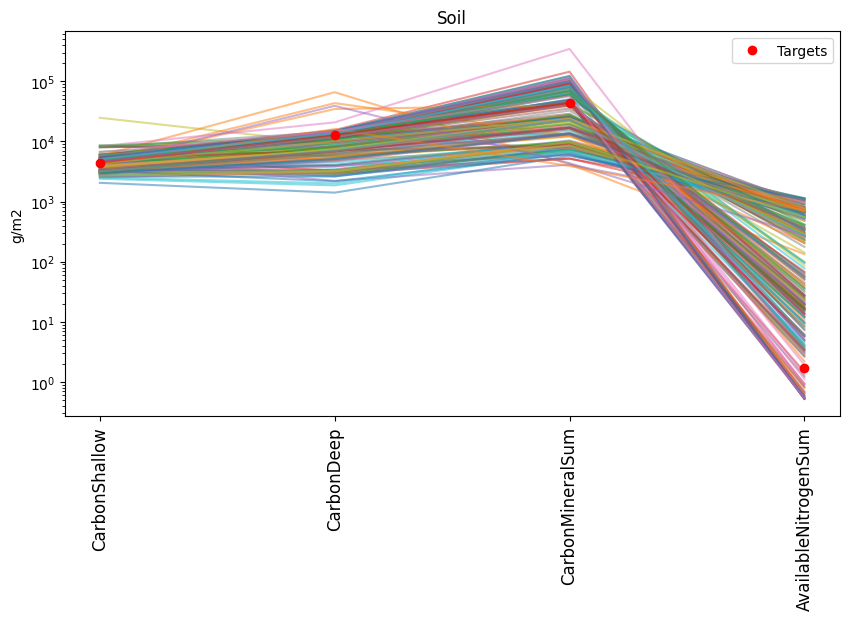

In [54]:
ut.one_to_one_match_plot(df_param.iloc[:,0:4])
plt.title(title_1)
ut.spaghetti_match_plot(df_param.iloc[:,0:4], df_model.iloc[:,0:4])
plt.ylabel(units_Soil)
plt.title(title_1)
ut.spaghetti_match_plot(df_param.iloc[:,0:4], df_model.iloc[:,0:4], logy=True)
plt.ylabel(units_Soil)
plt.title(title_1)

In [35]:
test_params, test_model =  ut.get_params_r2_rmse(df_param,df_model,r2lim=0.30)
df_param_pos = test_params[test_params.min(axis=1) >= 0]
df_model_pos= test_model[test_params.min(axis=1) >= 0]
df_param_pos

df_model_pos = pd.concat([df_model_pos, df_model.iloc[-1:]], ignore_index=True)

,micbnup,kdcrawc,kdcsoma,kdcsompr,kdcsomcr,$R^2$,RMSE,MAPE
61,2.293693,0.229018,0.075291,0.017446,0.000004,0.405554,6.684289e+07,0.597797


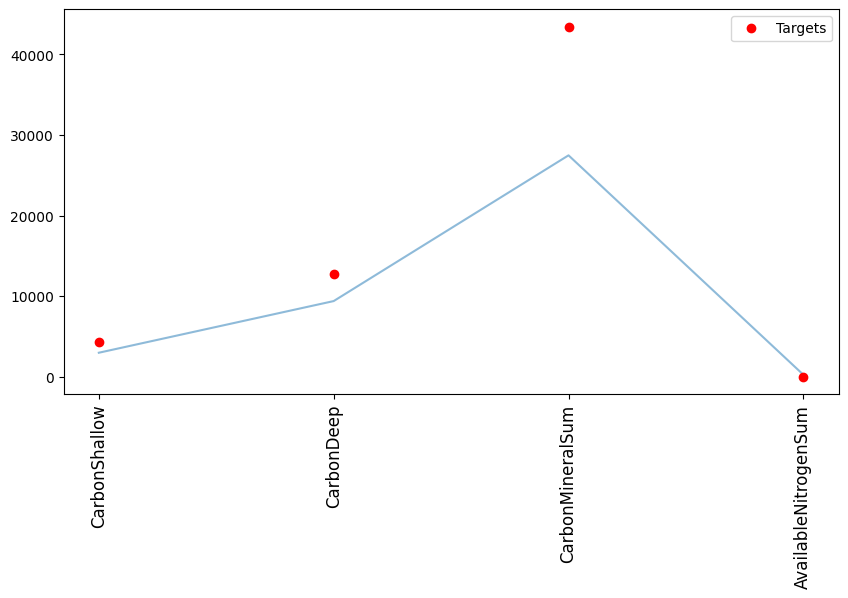

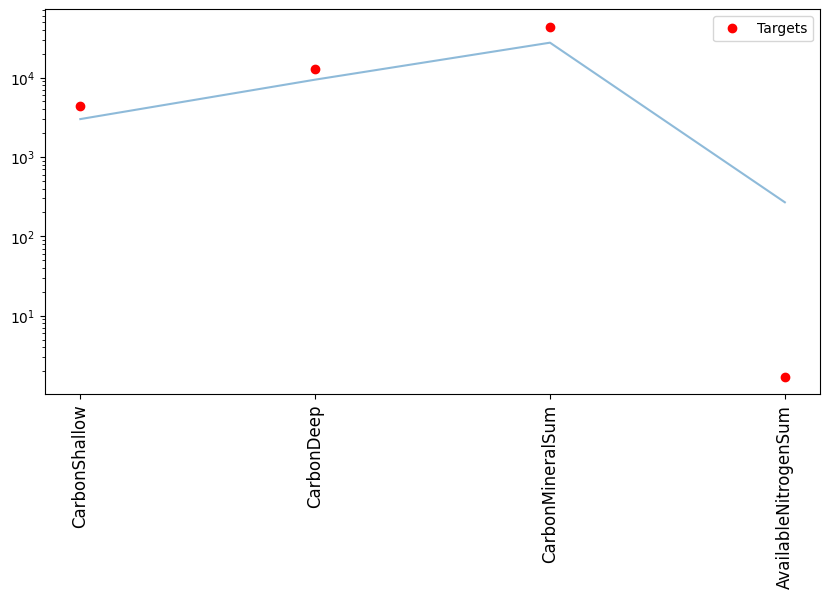

In [37]:
ut.spaghetti_match_plot(df_param_pos.iloc[:,0:4], df_model_pos.iloc[:,0:4])
ut.spaghetti_match_plot(df_param_pos.iloc[:,0:4], df_model_pos.iloc[:,0:4], logy=True)

best error

In [5]:
xparams, ymodel =  ut.get_params_r2_rmse(df_param,df_model,r2lim=0.97)
len(xparams)

72

In [25]:
best=xparams[xparams.MAPE<1]
best_model=ymodel[xparams.MAPE<1]
len(best)
best_model = pd.concat([best_model, df_model.iloc[-1:]], ignore_index=True)

In [19]:
xparams.describe()
# xparams[xparams.kdcrawc >= 0]

,micbnup,kdcrawc,kdcsoma,kdcsompr,kdcsomcr,$R^2$,RMSE,MAPE
count,72.000000,72.000000,72.000000,72.000000,72.000000,72.000000,7.200000e+01,72.000000
mean,0.811160,0.091192,0.351054,0.003595,0.000033,0.997162,8.234420e+05,0.254549
std,0.929208,0.271392,0.242217,0.009965,0.000058,0.005262,1.610469e+06,0.105594
min,-0.760937,-0.211016,-0.070759,-0.007838,-0.000044,0.977152,1.679759e+03,0.048528
25%,-0.007954,-0.138304,0.146841,-0.004862,-0.000019,0.997837,4.933084e+04,0.217015
50%,0.773073,-0.040417,0.344179,-0.000544,0.000016,0.999398,1.746929e+05,0.241982
75%,1.692080,0.318995,0.574940,0.011027,0.000077,0.999830,6.386231e+05,0.278917
max,2.347769,0.634394,0.770774,0.023023,0.000147,0.999994,7.987109e+06,0.600808


In [13]:
xparams_pos = xparams[xparams.min(axis=1) >= 0]
xparams_pos

,micbnup,kdcrawc,kdcsoma,kdcsompr,kdcsomcr,$R^2$,RMSE,MAPE


Text(0.5, 1.0, 'Soil')

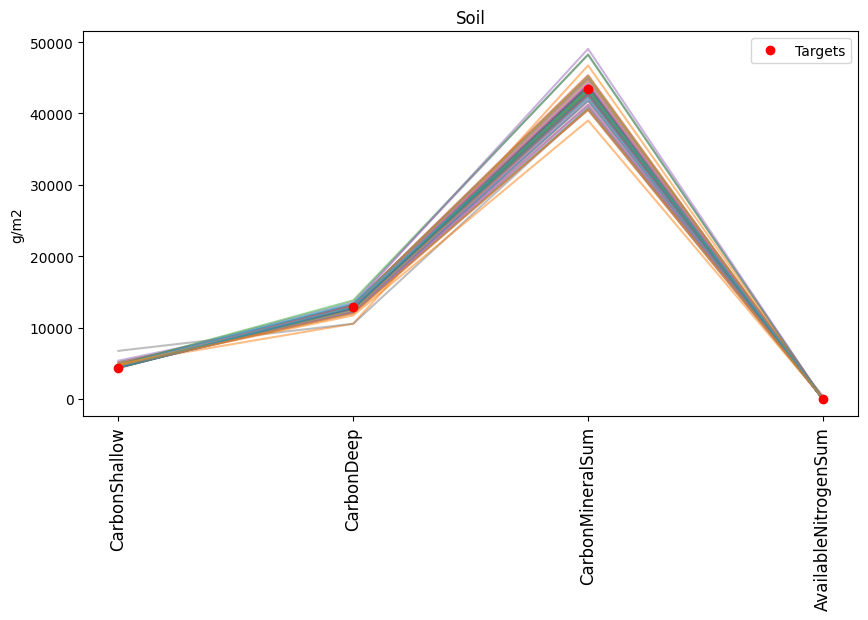

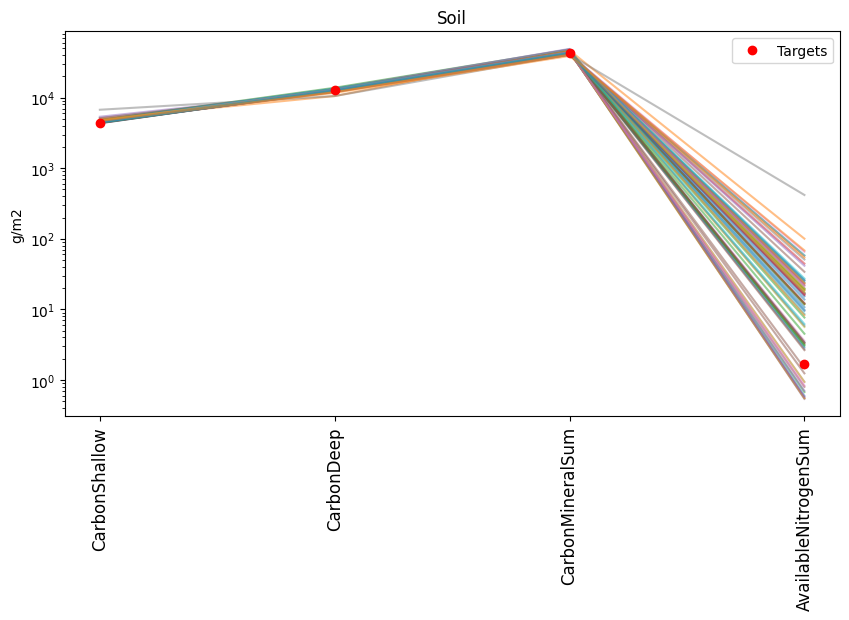

In [26]:
ut.spaghetti_match_plot(best.iloc[:,0:4], best_model.iloc[:,0:4])
plt.ylabel(units_Soil)
plt.title(title_1)
ut.spaghetti_match_plot(best.iloc[:,0:4], best_model.iloc[:,0:4], logy=True)
plt.ylabel(units_Soil)
plt.title(title_1)

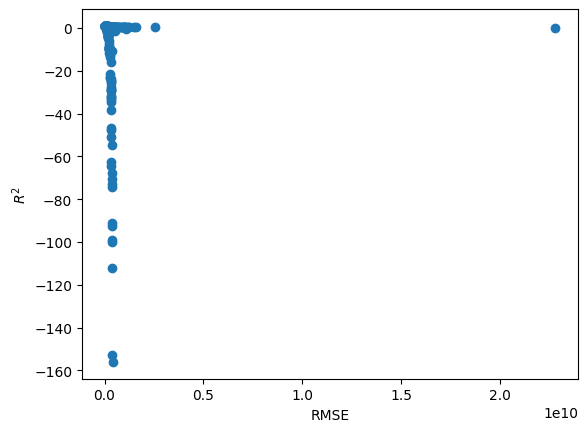

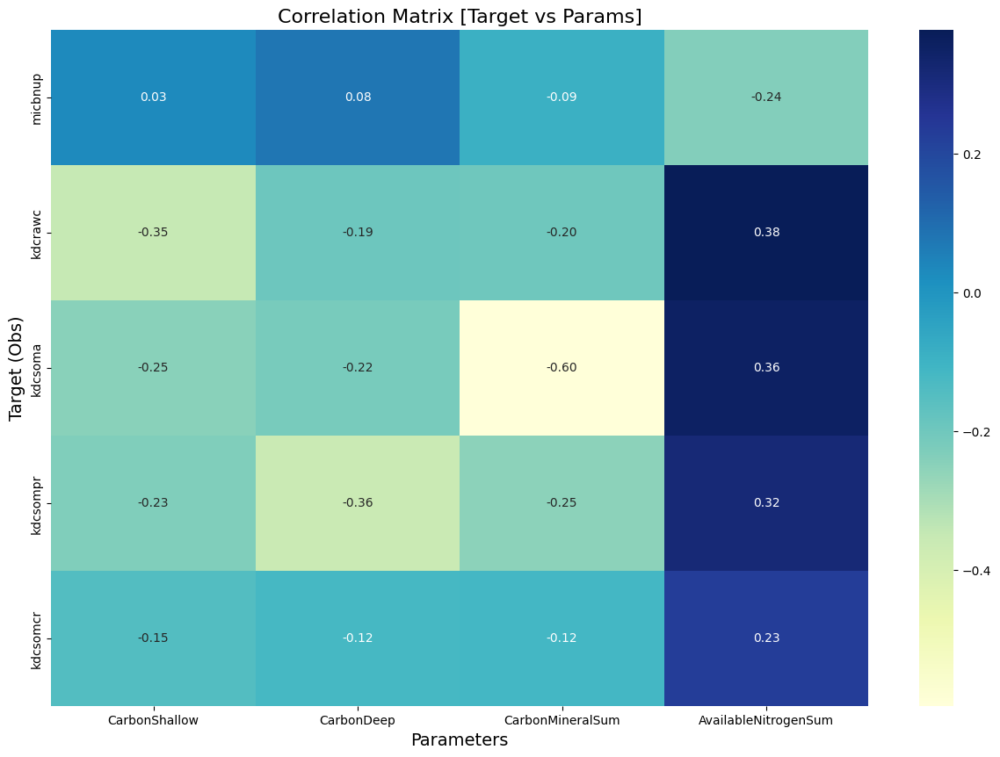

In [57]:
rmse=ut.plot_r2_rmse(df_model)
corr_mp=ut.get_output_param_corr(df_model,df_param)

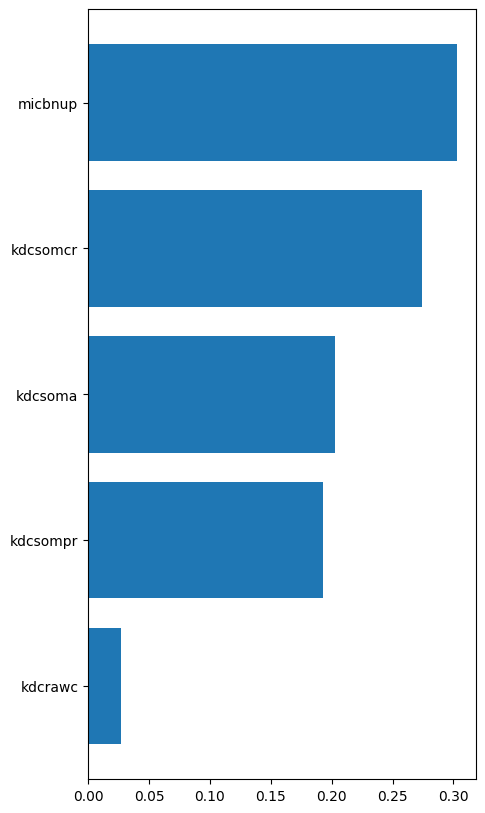

In [58]:
e_rmse=ut.find_important_features_err(df_param,df_model,error='rmse')